<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Scratch_5_layers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [4]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [5]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [6]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [7]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [8]:
%cd '/dataset unzipped'

/dataset unzipped


In [9]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [10]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [11]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [12]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [13]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [14]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [15]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [16]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [17]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [18]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(5):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

In [19]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [20]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [21]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [22]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_IoU',
    verbose=1,
    mode = 'max',
    save_best_only=True
    ),
    ShowTestImages()
]

In [23]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [24]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
26/26 [==============================] - ETA: 0s - loss: 32.8895 - IoU: 0.0623
Epoch 1: val_IoU improved from -inf to 0.11430, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


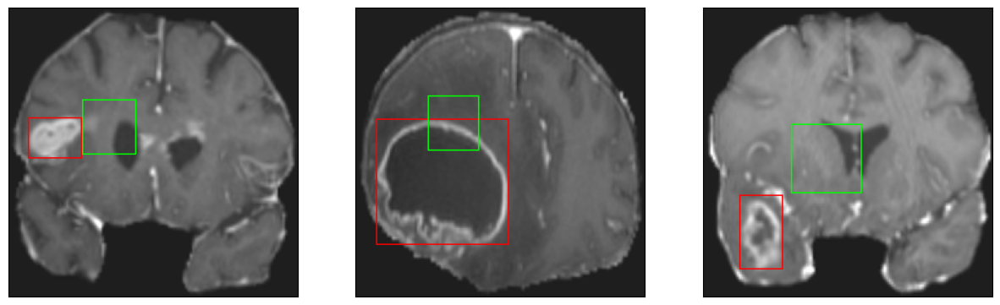

26/26 [==============================] - 24s 339ms/step - loss: 32.8895 - IoU: 0.0623 - val_loss: 24.8433 - val_IoU: 0.1143
Epoch 2/200
26/26 [==============================] - ETA: 0s - loss: 20.7545 - IoU: 0.1387
Epoch 2: val_IoU did not improve from 0.11430
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


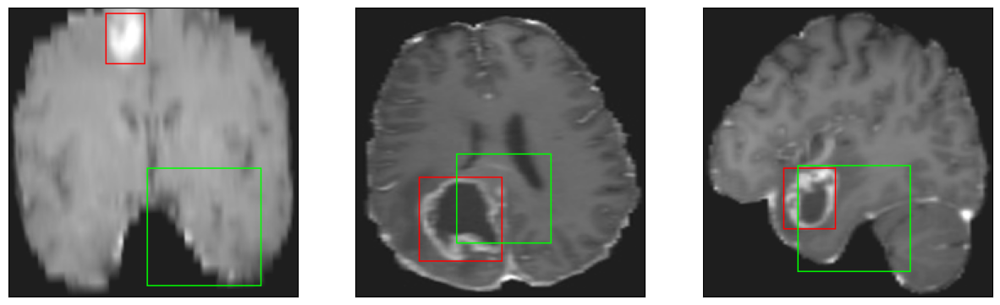

26/26 [==============================] - 3s 97ms/step - loss: 20.7545 - IoU: 0.1387 - val_loss: 58.9401 - val_IoU: 0.0248
Epoch 3/200
25/26 [===========================>..] - ETA: 0s - loss: 17.0756 - IoU: 0.2205
Epoch 3: val_IoU did not improve from 0.11430
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


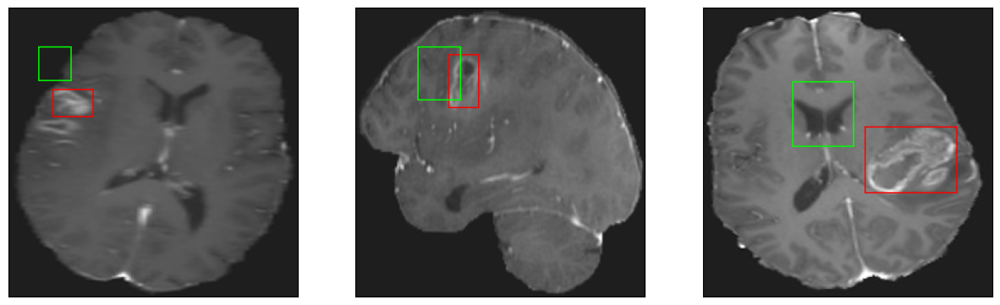

26/26 [==============================] - 2s 82ms/step - loss: 17.0211 - IoU: 0.2212 - val_loss: 26.8916 - val_IoU: 0.0828
Epoch 4/200
25/26 [===========================>..] - ETA: 0s - loss: 14.8166 - IoU: 0.2624
Epoch 4: val_IoU did not improve from 0.11430
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


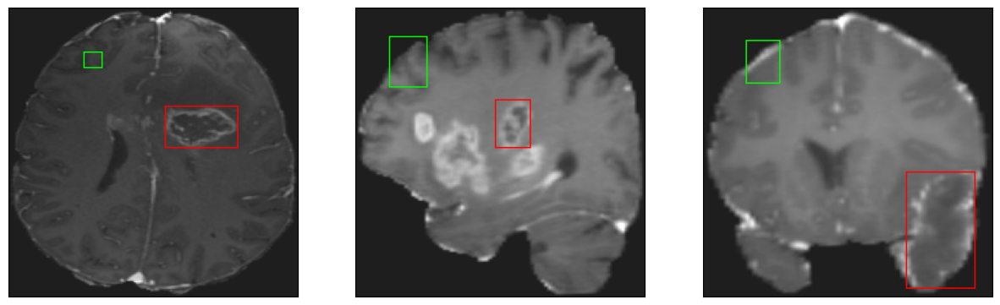

26/26 [==============================] - 3s 104ms/step - loss: 14.7298 - IoU: 0.2657 - val_loss: 36.9785 - val_IoU: 0.0161
Epoch 5/200
25/26 [===========================>..] - ETA: 0s - loss: 13.1190 - IoU: 0.3162
Epoch 5: val_IoU did not improve from 0.11430
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


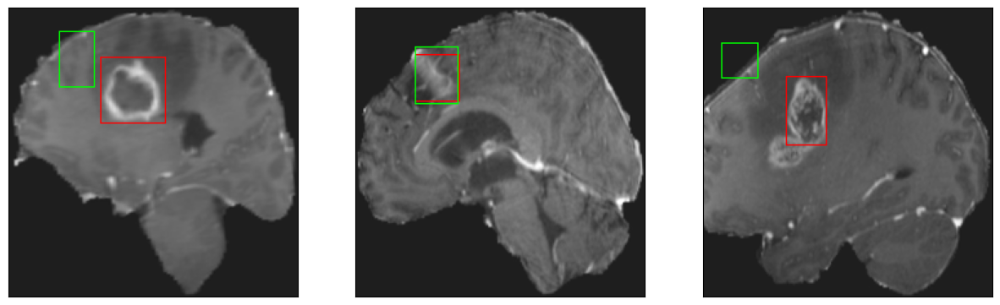

26/26 [==============================] - 3s 98ms/step - loss: 13.1494 - IoU: 0.3164 - val_loss: 29.9434 - val_IoU: 0.0659
Epoch 6/200
26/26 [==============================] - ETA: 0s - loss: 12.5006 - IoU: 0.3287
Epoch 6: val_IoU did not improve from 0.11430
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


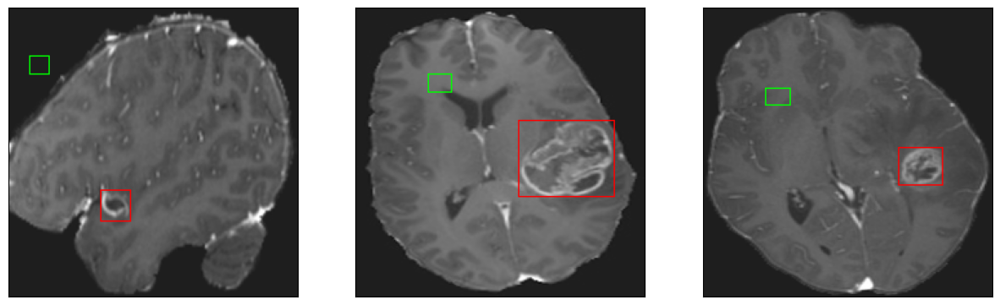

26/26 [==============================] - 2s 85ms/step - loss: 12.5006 - IoU: 0.3287 - val_loss: 42.1052 - val_IoU: 0.0023
Epoch 7/200
26/26 [==============================] - ETA: 0s - loss: 11.6400 - IoU: 0.3529
Epoch 7: val_IoU did not improve from 0.11430
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


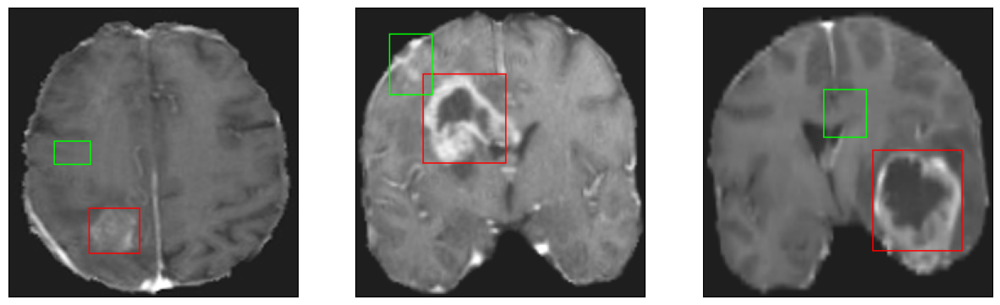

26/26 [==============================] - 2s 92ms/step - loss: 11.6400 - IoU: 0.3529 - val_loss: 30.5856 - val_IoU: 0.0274
Epoch 8/200
26/26 [==============================] - ETA: 0s - loss: 11.2468 - IoU: 0.3669
Epoch 8: val_IoU did not improve from 0.11430
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


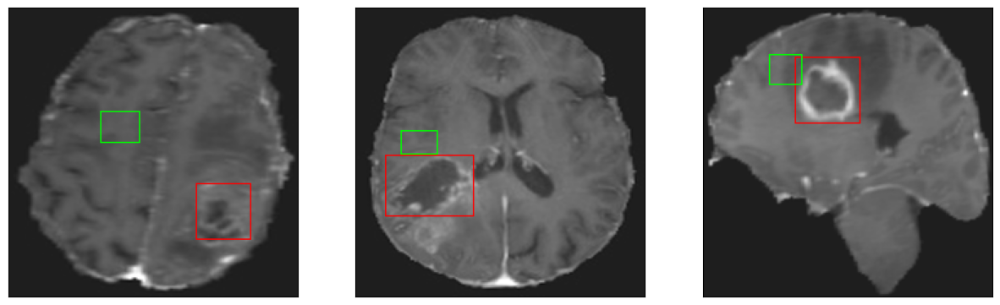

26/26 [==============================] - 2s 89ms/step - loss: 11.2468 - IoU: 0.3669 - val_loss: 34.8795 - val_IoU: 0.0198
Epoch 9/200
25/26 [===========================>..] - ETA: 0s - loss: 11.0210 - IoU: 0.3717
Epoch 9: val_IoU did not improve from 0.11430
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


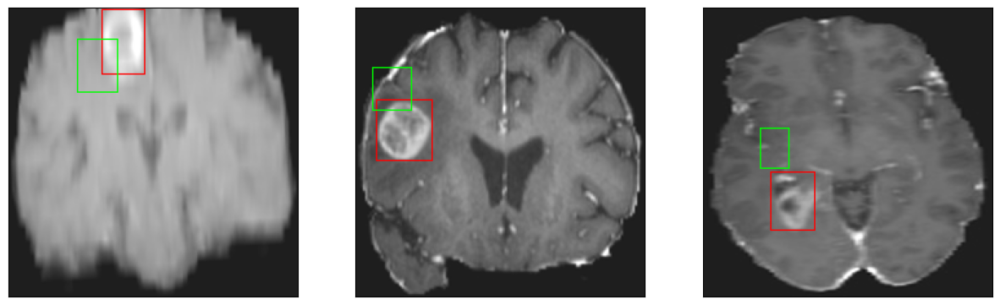

26/26 [==============================] - 2s 96ms/step - loss: 11.0203 - IoU: 0.3710 - val_loss: 23.4950 - val_IoU: 0.0963
Epoch 10/200
25/26 [===========================>..] - ETA: 0s - loss: 10.0131 - IoU: 0.3997
Epoch 10: val_IoU did not improve from 0.11430
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


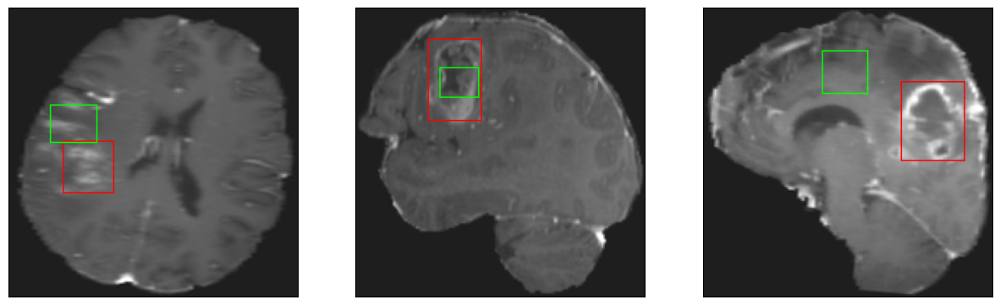

26/26 [==============================] - 3s 104ms/step - loss: 10.0265 - IoU: 0.4012 - val_loss: 27.8616 - val_IoU: 0.0530
Epoch 11/200
25/26 [===========================>..] - ETA: 0s - loss: 9.7314 - IoU: 0.4236
Epoch 11: val_IoU improved from 0.11430 to 0.12541, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


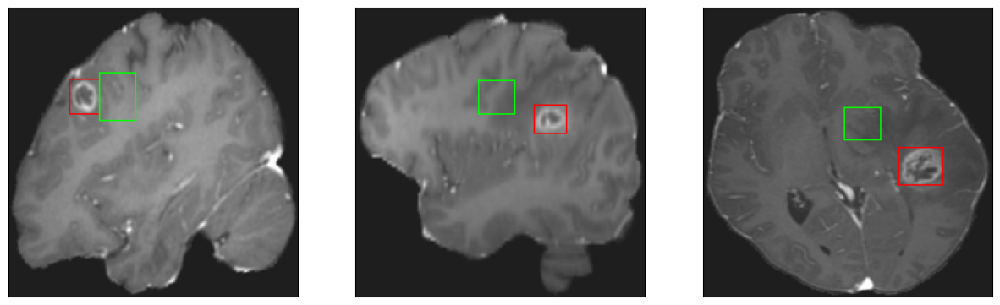

26/26 [==============================] - 3s 110ms/step - loss: 9.7161 - IoU: 0.4238 - val_loss: 21.4868 - val_IoU: 0.1254
Epoch 12/200
25/26 [===========================>..] - ETA: 0s - loss: 9.1833 - IoU: 0.4338
Epoch 12: val_IoU improved from 0.12541 to 0.21978, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


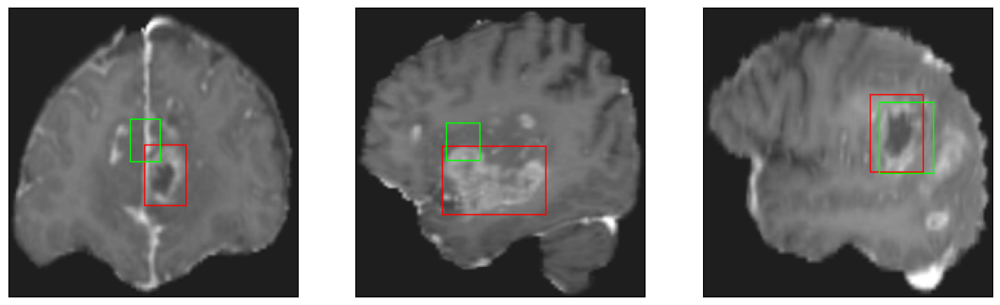

26/26 [==============================] - 2s 93ms/step - loss: 9.1530 - IoU: 0.4343 - val_loss: 17.2736 - val_IoU: 0.2198
Epoch 13/200
26/26 [==============================] - ETA: 0s - loss: 8.9552 - IoU: 0.4357
Epoch 13: val_IoU improved from 0.21978 to 0.27813, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 17ms/step
4


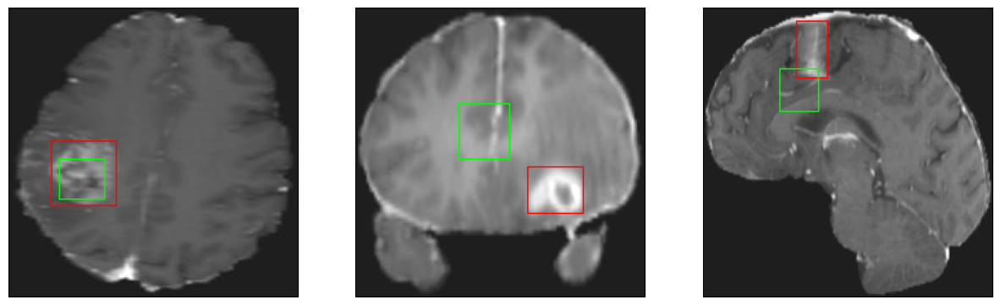

26/26 [==============================] - 3s 104ms/step - loss: 8.9552 - IoU: 0.4357 - val_loss: 15.6703 - val_IoU: 0.2781
Epoch 14/200
26/26 [==============================] - ETA: 0s - loss: 8.8308 - IoU: 0.4449
Epoch 14: val_IoU did not improve from 0.27813
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


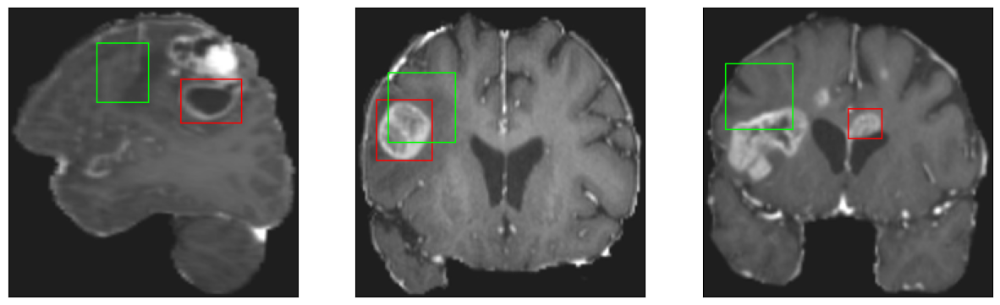

26/26 [==============================] - 3s 130ms/step - loss: 8.8308 - IoU: 0.4449 - val_loss: 22.3090 - val_IoU: 0.1788
Epoch 15/200
26/26 [==============================] - ETA: 0s - loss: 8.6113 - IoU: 0.4518
Epoch 15: val_IoU improved from 0.27813 to 0.35359, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


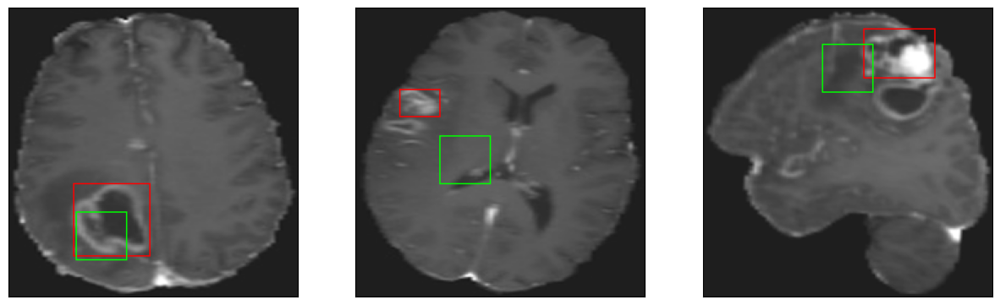

26/26 [==============================] - 3s 101ms/step - loss: 8.6113 - IoU: 0.4518 - val_loss: 12.7840 - val_IoU: 0.3536
Epoch 16/200
26/26 [==============================] - ETA: 0s - loss: 8.8643 - IoU: 0.4413
Epoch 16: val_IoU did not improve from 0.35359
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


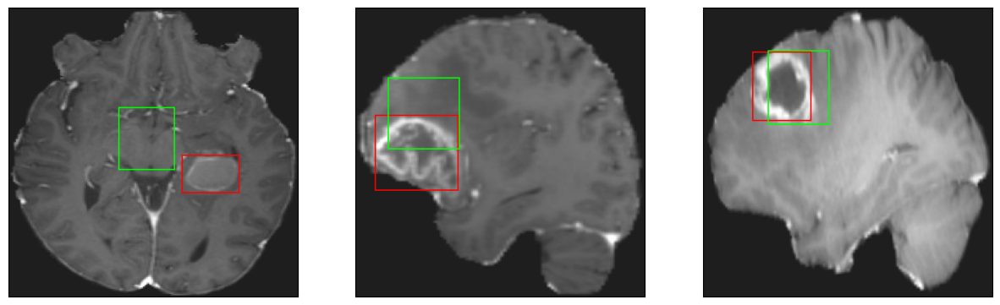

26/26 [==============================] - 2s 91ms/step - loss: 8.8643 - IoU: 0.4413 - val_loss: 18.4895 - val_IoU: 0.2015
Epoch 17/200
26/26 [==============================] - ETA: 0s - loss: 8.1675 - IoU: 0.4646
Epoch 17: val_IoU improved from 0.35359 to 0.35361, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


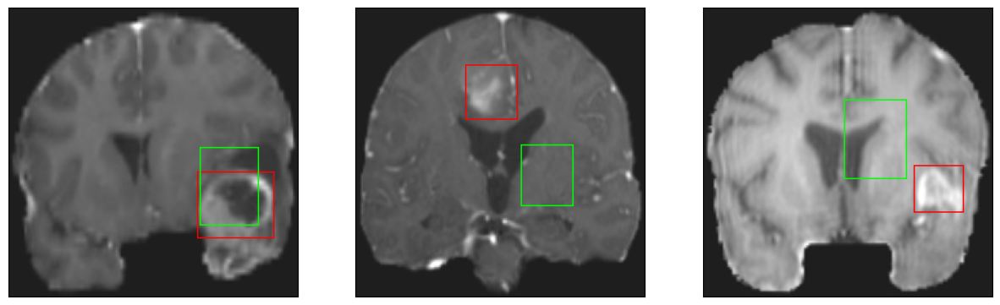

26/26 [==============================] - 3s 120ms/step - loss: 8.1675 - IoU: 0.4646 - val_loss: 13.7160 - val_IoU: 0.3536
Epoch 18/200
26/26 [==============================] - ETA: 0s - loss: 8.2023 - IoU: 0.4677
Epoch 18: val_IoU did not improve from 0.35361
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


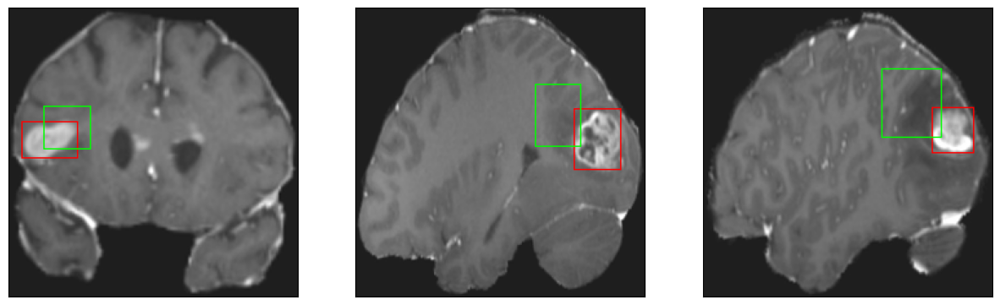

26/26 [==============================] - 3s 100ms/step - loss: 8.2023 - IoU: 0.4677 - val_loss: 15.1265 - val_IoU: 0.2712
Epoch 19/200
26/26 [==============================] - ETA: 0s - loss: 7.8315 - IoU: 0.4807
Epoch 19: val_IoU improved from 0.35361 to 0.38776, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 10ms/step
4


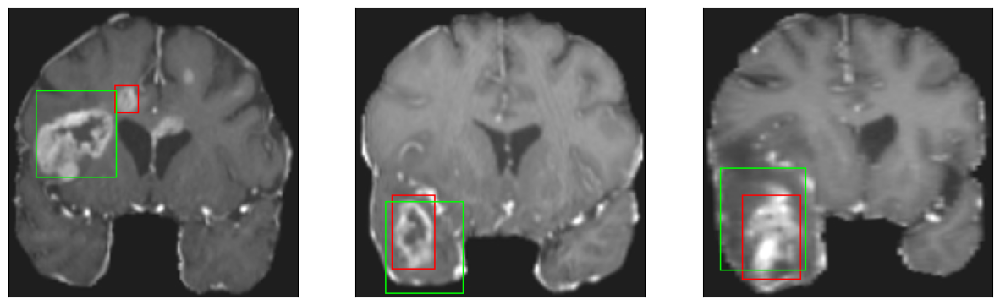

26/26 [==============================] - 3s 119ms/step - loss: 7.8315 - IoU: 0.4807 - val_loss: 12.5507 - val_IoU: 0.3878
Epoch 20/200
25/26 [===========================>..] - ETA: 0s - loss: 7.7020 - IoU: 0.4857
Epoch 20: val_IoU did not improve from 0.38776
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


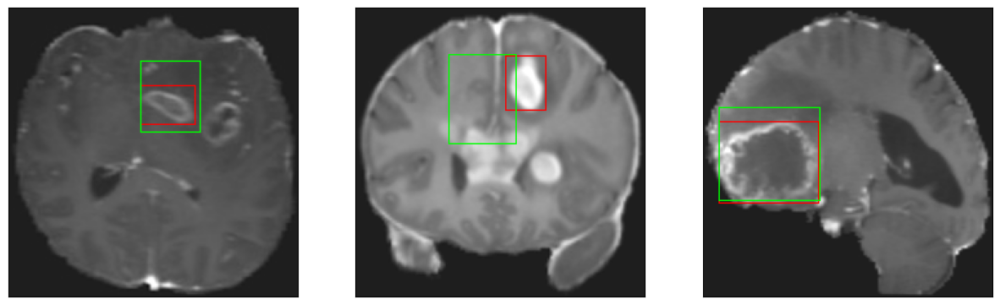

26/26 [==============================] - 3s 124ms/step - loss: 7.6915 - IoU: 0.4857 - val_loss: 15.2382 - val_IoU: 0.3180
Epoch 21/200
25/26 [===========================>..] - ETA: 0s - loss: 7.5139 - IoU: 0.4879
Epoch 21: val_IoU improved from 0.38776 to 0.41106, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


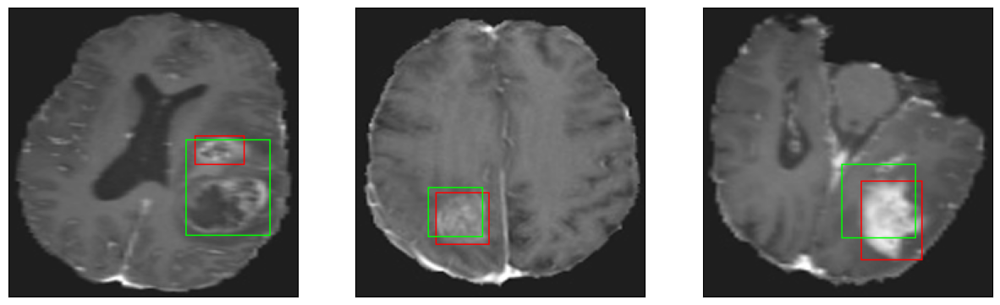

26/26 [==============================] - 3s 118ms/step - loss: 7.4860 - IoU: 0.4904 - val_loss: 13.6711 - val_IoU: 0.4111
Epoch 22/200
25/26 [===========================>..] - ETA: 0s - loss: 7.3142 - IoU: 0.5014
Epoch 22: val_IoU did not improve from 0.41106
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


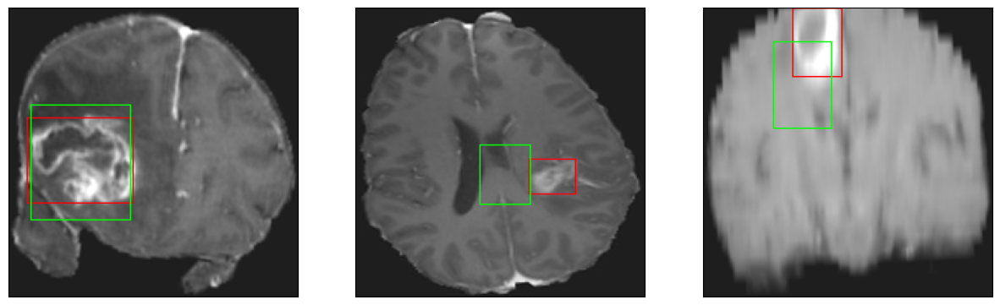

26/26 [==============================] - 3s 111ms/step - loss: 7.3443 - IoU: 0.5002 - val_loss: 18.4069 - val_IoU: 0.3108
Epoch 23/200
26/26 [==============================] - ETA: 0s - loss: 7.6208 - IoU: 0.4781
Epoch 23: val_IoU did not improve from 0.41106
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


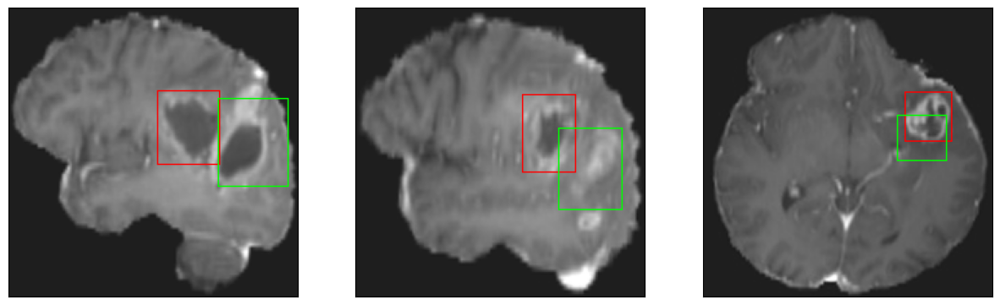

26/26 [==============================] - 3s 108ms/step - loss: 7.6208 - IoU: 0.4781 - val_loss: 12.8267 - val_IoU: 0.3858
Epoch 24/200
25/26 [===========================>..] - ETA: 0s - loss: 7.2005 - IoU: 0.5047
Epoch 24: val_IoU did not improve from 0.41106
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


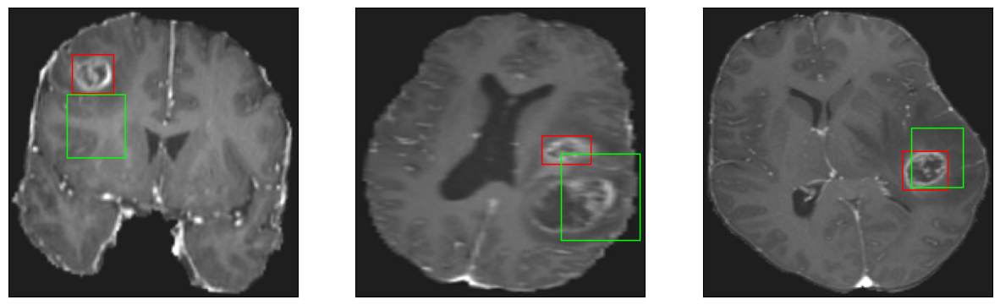

26/26 [==============================] - 3s 118ms/step - loss: 7.1953 - IoU: 0.5067 - val_loss: 12.1345 - val_IoU: 0.3933
Epoch 25/200
26/26 [==============================] - ETA: 0s - loss: 7.3432 - IoU: 0.4972
Epoch 25: val_IoU did not improve from 0.41106
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4


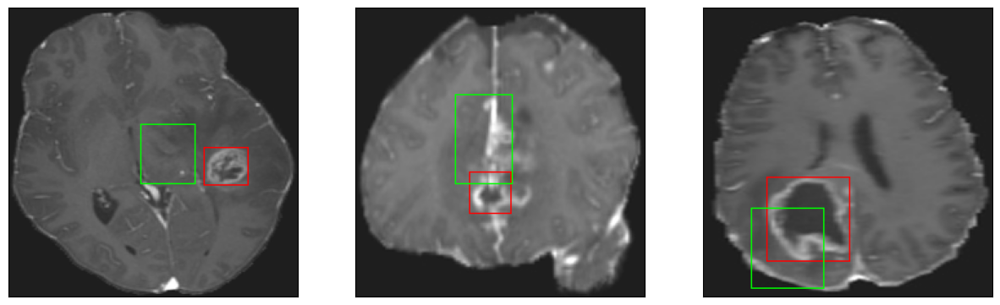

26/26 [==============================] - 3s 114ms/step - loss: 7.3432 - IoU: 0.4972 - val_loss: 19.0620 - val_IoU: 0.2948
Epoch 26/200
26/26 [==============================] - ETA: 0s - loss: 7.1775 - IoU: 0.5033
Epoch 26: val_IoU did not improve from 0.41106
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


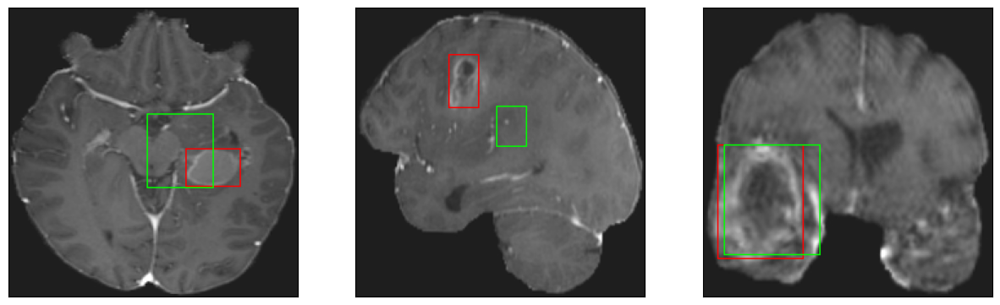

26/26 [==============================] - 3s 98ms/step - loss: 7.1775 - IoU: 0.5033 - val_loss: 14.4323 - val_IoU: 0.3116
Epoch 27/200
26/26 [==============================] - ETA: 0s - loss: 7.1183 - IoU: 0.4979
Epoch 27: val_IoU did not improve from 0.41106
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


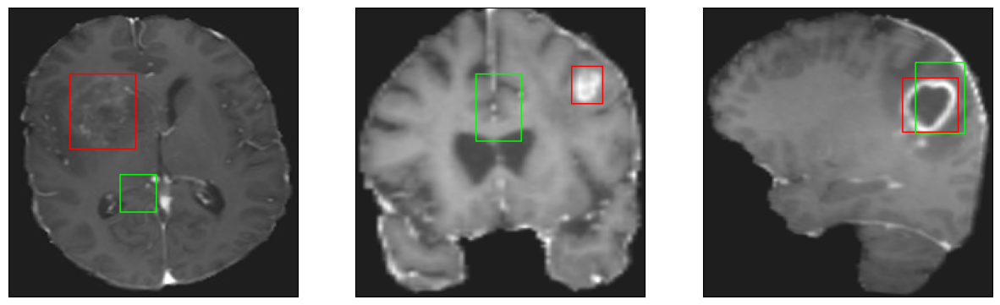

26/26 [==============================] - 3s 103ms/step - loss: 7.1183 - IoU: 0.4979 - val_loss: 11.8300 - val_IoU: 0.4066
Epoch 28/200
25/26 [===========================>..] - ETA: 0s - loss: 7.1080 - IoU: 0.5075
Epoch 28: val_IoU did not improve from 0.41106
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


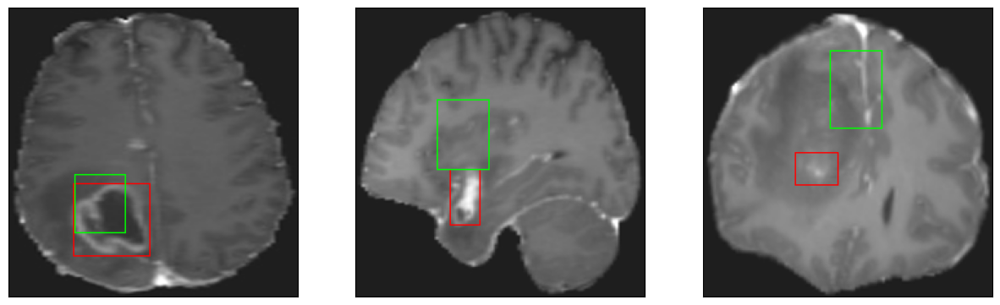

26/26 [==============================] - 3s 106ms/step - loss: 7.1222 - IoU: 0.5076 - val_loss: 16.6547 - val_IoU: 0.2990
Epoch 29/200
25/26 [===========================>..] - ETA: 0s - loss: 6.8948 - IoU: 0.5175
Epoch 29: val_IoU did not improve from 0.41106
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


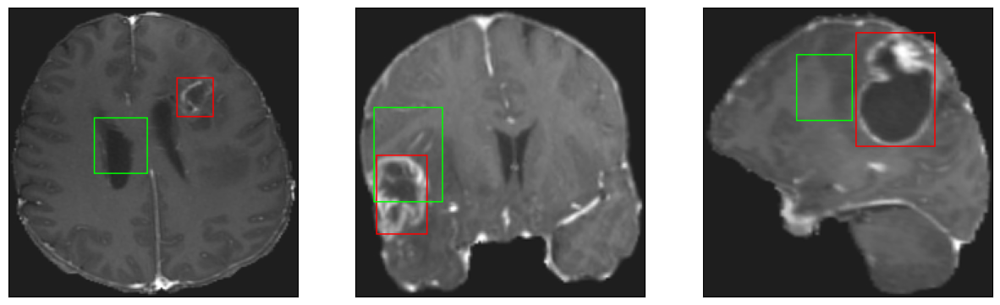

26/26 [==============================] - 3s 113ms/step - loss: 6.9158 - IoU: 0.5174 - val_loss: 21.2838 - val_IoU: 0.1991
Epoch 30/200
25/26 [===========================>..] - ETA: 0s - loss: 6.8517 - IoU: 0.5258
Epoch 30: val_IoU did not improve from 0.41106
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


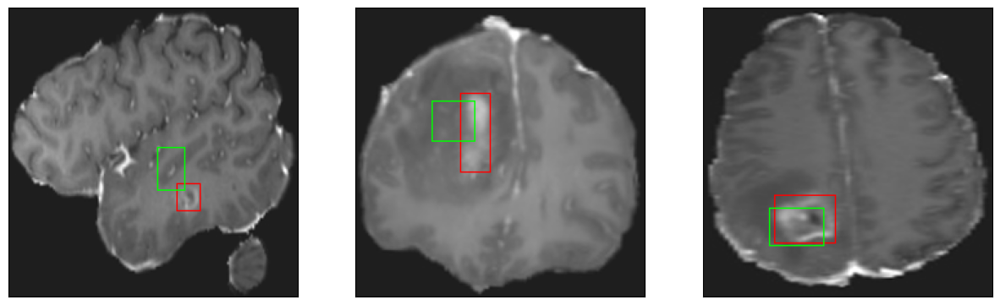

26/26 [==============================] - 3s 109ms/step - loss: 6.8138 - IoU: 0.5276 - val_loss: 11.5224 - val_IoU: 0.3959
Epoch 31/200
25/26 [===========================>..] - ETA: 0s - loss: 6.6585 - IoU: 0.5316
Epoch 31: val_IoU did not improve from 0.41106
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


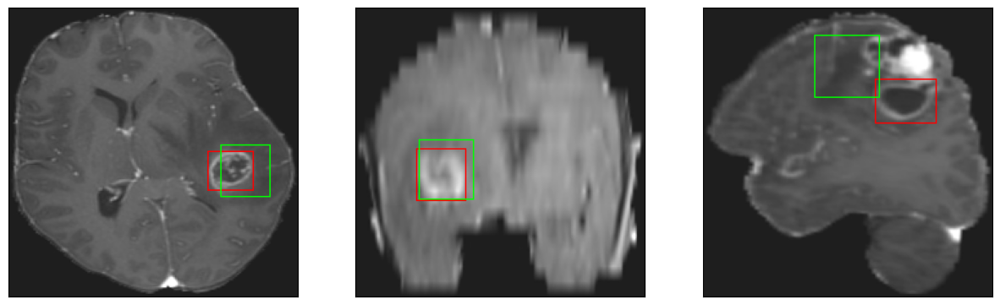

26/26 [==============================] - 3s 104ms/step - loss: 6.7061 - IoU: 0.5308 - val_loss: 11.7140 - val_IoU: 0.3819
Epoch 32/200
25/26 [===========================>..] - ETA: 0s - loss: 6.6174 - IoU: 0.5302
Epoch 32: val_IoU did not improve from 0.41106
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 27ms/step
4


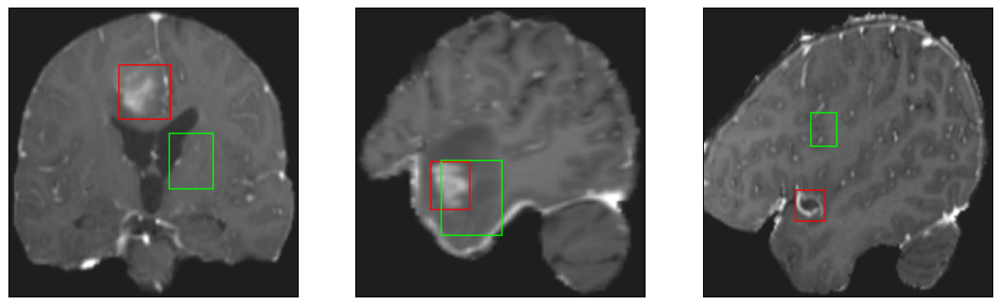

26/26 [==============================] - 4s 146ms/step - loss: 6.5981 - IoU: 0.5317 - val_loss: 12.4550 - val_IoU: 0.3732
Epoch 33/200
26/26 [==============================] - ETA: 0s - loss: 6.3186 - IoU: 0.5425
Epoch 33: val_IoU did not improve from 0.41106
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


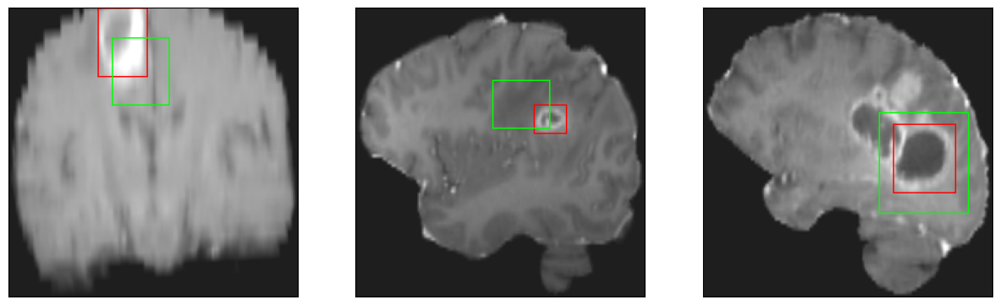

26/26 [==============================] - 3s 122ms/step - loss: 6.3186 - IoU: 0.5425 - val_loss: 13.0364 - val_IoU: 0.3635
Epoch 34/200
25/26 [===========================>..] - ETA: 0s - loss: 6.8581 - IoU: 0.5147
Epoch 34: val_IoU did not improve from 0.41106
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


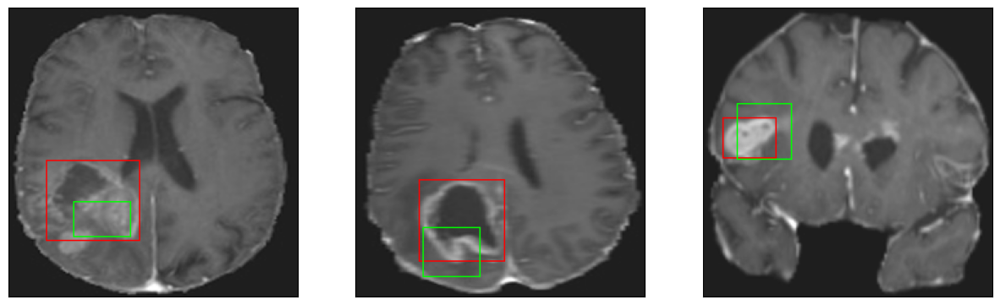

26/26 [==============================] - 3s 99ms/step - loss: 6.8864 - IoU: 0.5131 - val_loss: 12.3587 - val_IoU: 0.3654
Epoch 35/200
26/26 [==============================] - ETA: 0s - loss: 6.8979 - IoU: 0.5178
Epoch 35: val_IoU did not improve from 0.41106
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


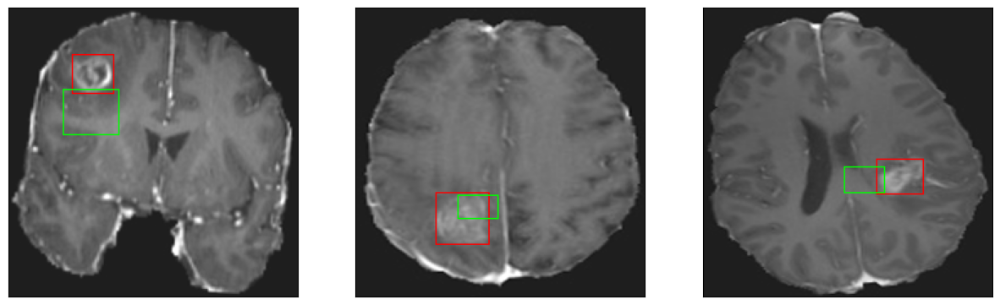

26/26 [==============================] - 2s 89ms/step - loss: 6.8979 - IoU: 0.5178 - val_loss: 12.2923 - val_IoU: 0.3848
Epoch 36/200
26/26 [==============================] - ETA: 0s - loss: 6.6330 - IoU: 0.5360
Epoch 36: val_IoU did not improve from 0.41106
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


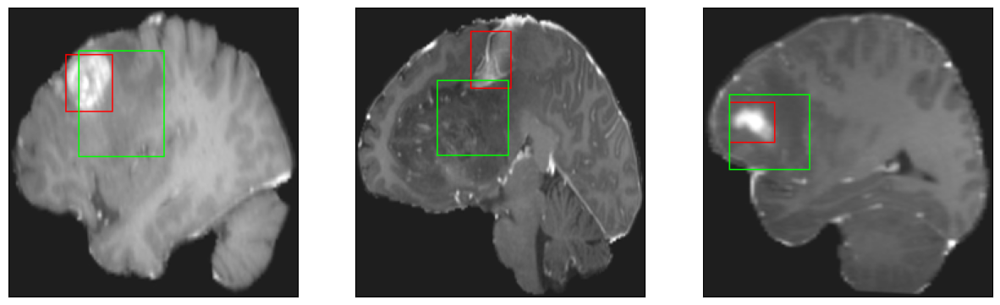

26/26 [==============================] - 3s 101ms/step - loss: 6.6330 - IoU: 0.5360 - val_loss: 21.8977 - val_IoU: 0.2687
Epoch 37/200
25/26 [===========================>..] - ETA: 0s - loss: 6.6160 - IoU: 0.5339
Epoch 37: val_IoU improved from 0.41106 to 0.44812, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


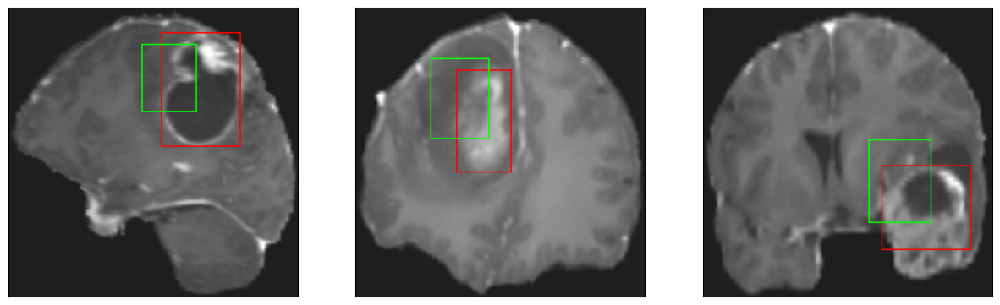

26/26 [==============================] - 3s 133ms/step - loss: 6.6438 - IoU: 0.5334 - val_loss: 10.6474 - val_IoU: 0.4481
Epoch 38/200
25/26 [===========================>..] - ETA: 0s - loss: 6.2955 - IoU: 0.5501
Epoch 38: val_IoU did not improve from 0.44812
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


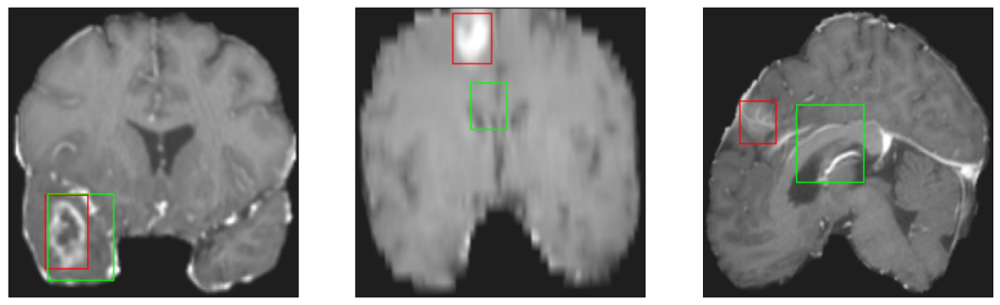

26/26 [==============================] - 3s 112ms/step - loss: 6.3774 - IoU: 0.5469 - val_loss: 12.3437 - val_IoU: 0.4353
Epoch 39/200
25/26 [===========================>..] - ETA: 0s - loss: 6.2864 - IoU: 0.5498
Epoch 39: val_IoU did not improve from 0.44812
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


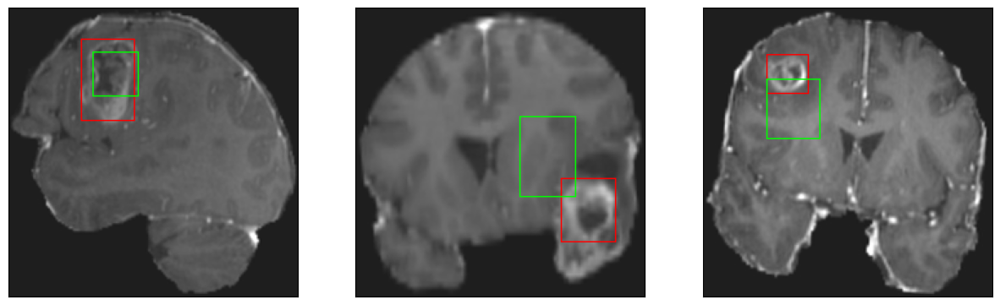

26/26 [==============================] - 2s 95ms/step - loss: 6.2782 - IoU: 0.5482 - val_loss: 11.4899 - val_IoU: 0.4072
Epoch 40/200
26/26 [==============================] - ETA: 0s - loss: 6.4832 - IoU: 0.5296
Epoch 40: val_IoU did not improve from 0.44812
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


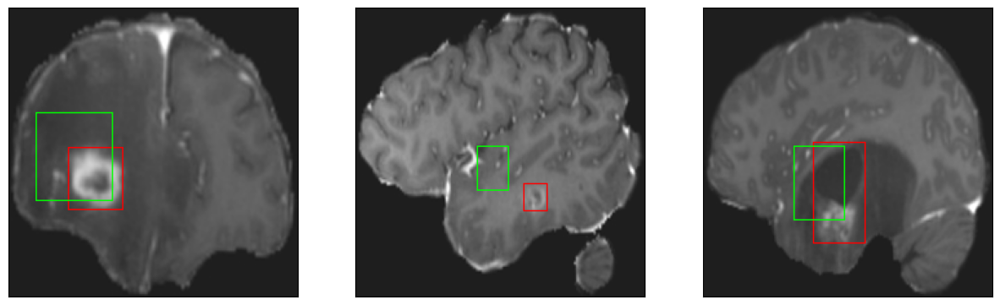

26/26 [==============================] - 3s 109ms/step - loss: 6.4832 - IoU: 0.5296 - val_loss: 11.3129 - val_IoU: 0.4222
Epoch 41/200
25/26 [===========================>..] - ETA: 0s - loss: 6.4154 - IoU: 0.5409
Epoch 41: val_IoU did not improve from 0.44812
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


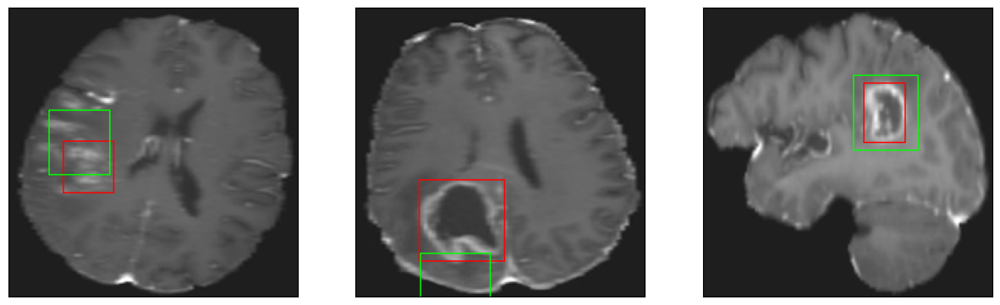

26/26 [==============================] - 3s 133ms/step - loss: 6.4084 - IoU: 0.5436 - val_loss: 12.1761 - val_IoU: 0.4164
Epoch 42/200
26/26 [==============================] - ETA: 0s - loss: 5.9983 - IoU: 0.5598
Epoch 42: val_IoU did not improve from 0.44812
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


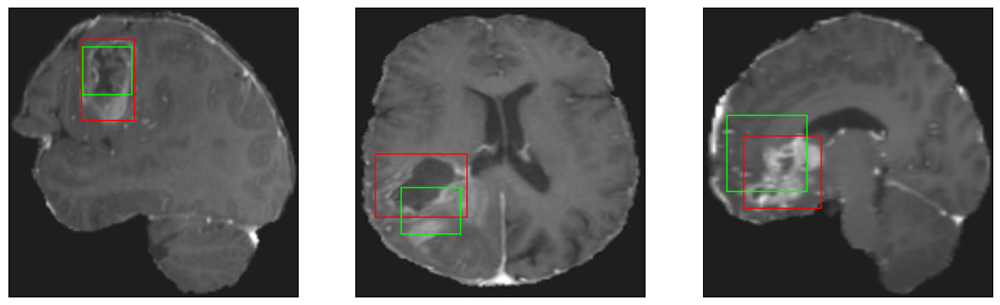

26/26 [==============================] - 3s 103ms/step - loss: 5.9983 - IoU: 0.5598 - val_loss: 10.8265 - val_IoU: 0.4465
Epoch 43/200
26/26 [==============================] - ETA: 0s - loss: 6.1723 - IoU: 0.5464
Epoch 43: val_IoU did not improve from 0.44812
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


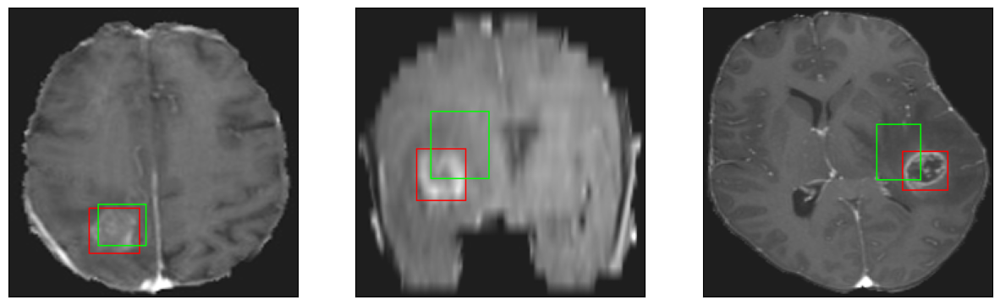

26/26 [==============================] - 3s 100ms/step - loss: 6.1723 - IoU: 0.5464 - val_loss: 13.3496 - val_IoU: 0.3544
Epoch 44/200
26/26 [==============================] - ETA: 0s - loss: 6.2382 - IoU: 0.5478
Epoch 44: val_IoU did not improve from 0.44812
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4


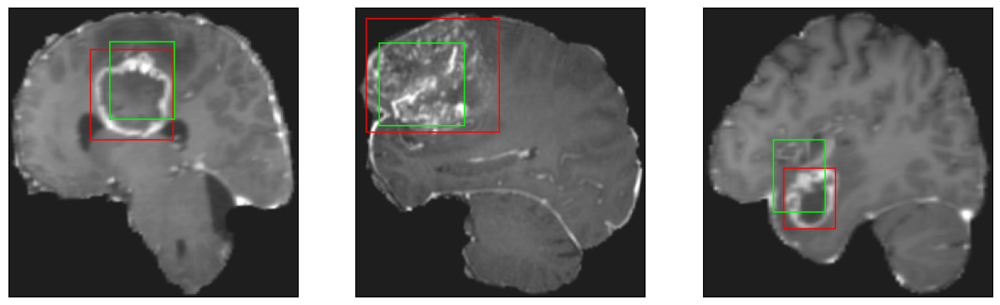

26/26 [==============================] - 3s 120ms/step - loss: 6.2382 - IoU: 0.5478 - val_loss: 11.0657 - val_IoU: 0.4451
Epoch 45/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8363 - IoU: 0.5697
Epoch 45: val_IoU did not improve from 0.44812
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


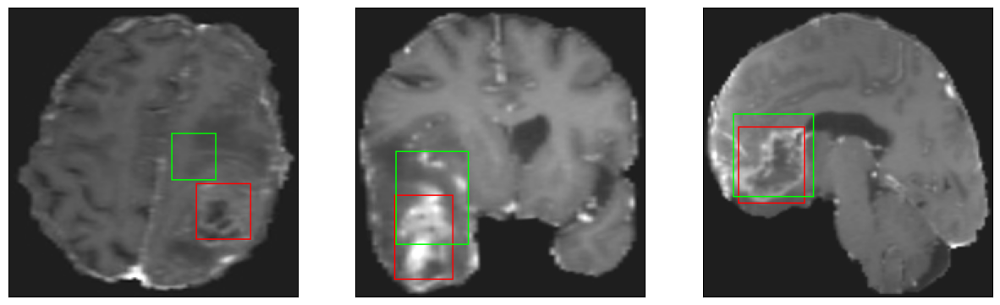

26/26 [==============================] - 2s 96ms/step - loss: 5.8611 - IoU: 0.5696 - val_loss: 11.9150 - val_IoU: 0.4093
Epoch 46/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0571 - IoU: 0.5581
Epoch 46: val_IoU did not improve from 0.44812
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


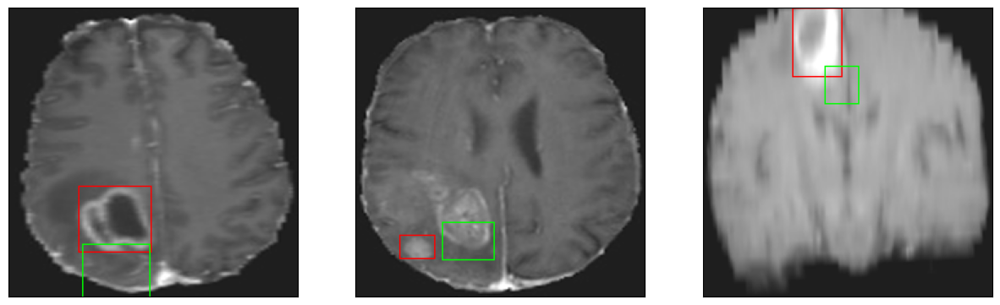

26/26 [==============================] - 3s 105ms/step - loss: 6.0507 - IoU: 0.5596 - val_loss: 14.0052 - val_IoU: 0.3096
Epoch 47/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8657 - IoU: 0.5663
Epoch 47: val_IoU did not improve from 0.44812
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


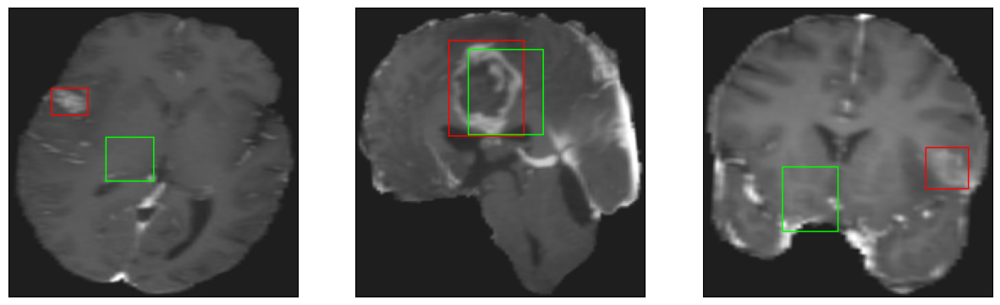

26/26 [==============================] - 3s 108ms/step - loss: 5.8278 - IoU: 0.5675 - val_loss: 12.0507 - val_IoU: 0.3851
Epoch 48/200
26/26 [==============================] - ETA: 0s - loss: 5.8190 - IoU: 0.5700
Epoch 48: val_IoU improved from 0.44812 to 0.45258, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


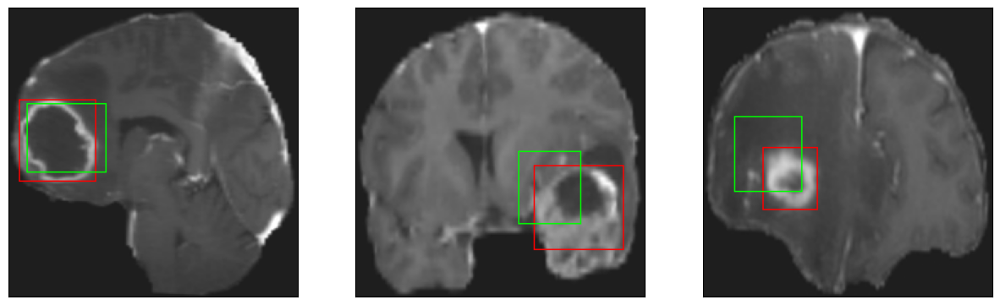

26/26 [==============================] - 4s 148ms/step - loss: 5.8190 - IoU: 0.5700 - val_loss: 10.4501 - val_IoU: 0.4526
Epoch 49/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0363 - IoU: 0.5594
Epoch 49: val_IoU did not improve from 0.45258
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


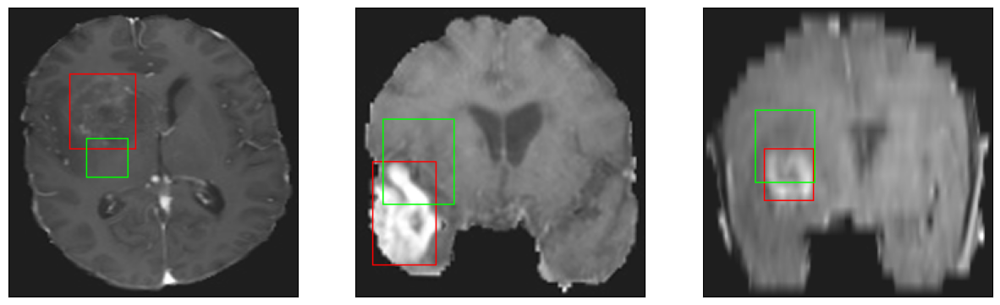

26/26 [==============================] - 3s 102ms/step - loss: 6.0104 - IoU: 0.5611 - val_loss: 14.9996 - val_IoU: 0.3047
Epoch 50/200
26/26 [==============================] - ETA: 0s - loss: 5.6842 - IoU: 0.5734
Epoch 50: val_IoU did not improve from 0.45258
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


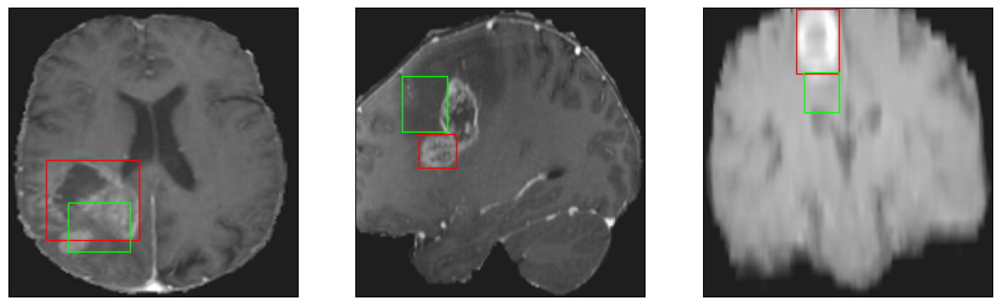

26/26 [==============================] - 3s 102ms/step - loss: 5.6842 - IoU: 0.5734 - val_loss: 11.1078 - val_IoU: 0.4415
Epoch 51/200
26/26 [==============================] - ETA: 0s - loss: 5.6061 - IoU: 0.5828
Epoch 51: val_IoU did not improve from 0.45258
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


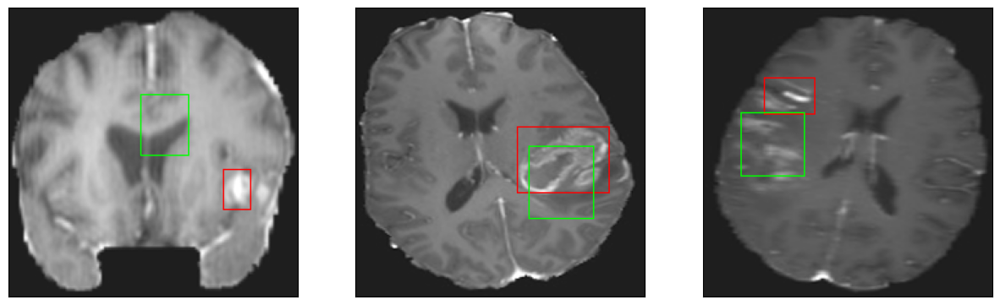

26/26 [==============================] - 3s 128ms/step - loss: 5.6061 - IoU: 0.5828 - val_loss: 11.0701 - val_IoU: 0.4323
Epoch 52/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5114 - IoU: 0.5835
Epoch 52: val_IoU did not improve from 0.45258
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


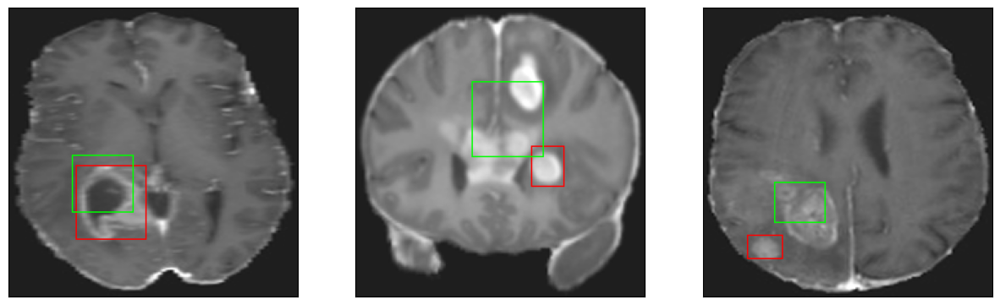

26/26 [==============================] - 3s 108ms/step - loss: 5.4962 - IoU: 0.5855 - val_loss: 12.3228 - val_IoU: 0.4094
Epoch 53/200
26/26 [==============================] - ETA: 0s - loss: 5.8761 - IoU: 0.5661
Epoch 53: val_IoU did not improve from 0.45258
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


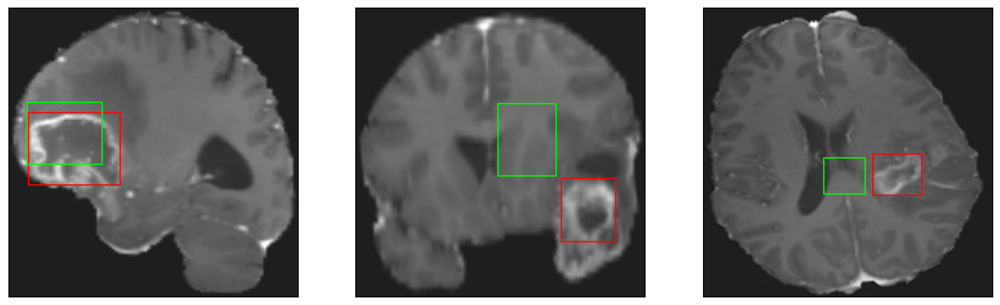

26/26 [==============================] - 3s 105ms/step - loss: 5.8761 - IoU: 0.5661 - val_loss: 14.7309 - val_IoU: 0.2928
Epoch 54/200
26/26 [==============================] - ETA: 0s - loss: 5.8623 - IoU: 0.5694
Epoch 54: val_IoU did not improve from 0.45258
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 7ms/step
4


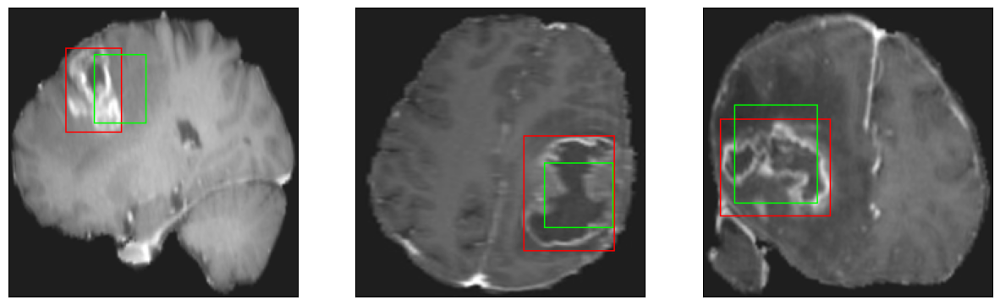

26/26 [==============================] - 3s 124ms/step - loss: 5.8623 - IoU: 0.5694 - val_loss: 11.9163 - val_IoU: 0.3778
Epoch 55/200
25/26 [===========================>..] - ETA: 0s - loss: 5.7771 - IoU: 0.5715
Epoch 55: val_IoU improved from 0.45258 to 0.45362, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


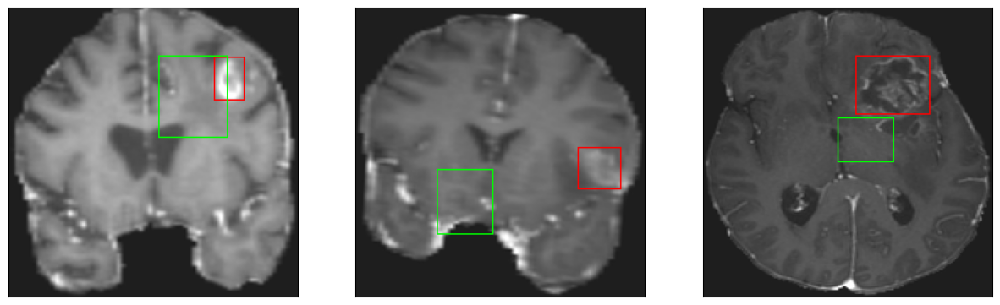

26/26 [==============================] - 3s 131ms/step - loss: 5.7951 - IoU: 0.5727 - val_loss: 11.1561 - val_IoU: 0.4536
Epoch 56/200
26/26 [==============================] - ETA: 0s - loss: 5.8145 - IoU: 0.5657
Epoch 56: val_IoU did not improve from 0.45362
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


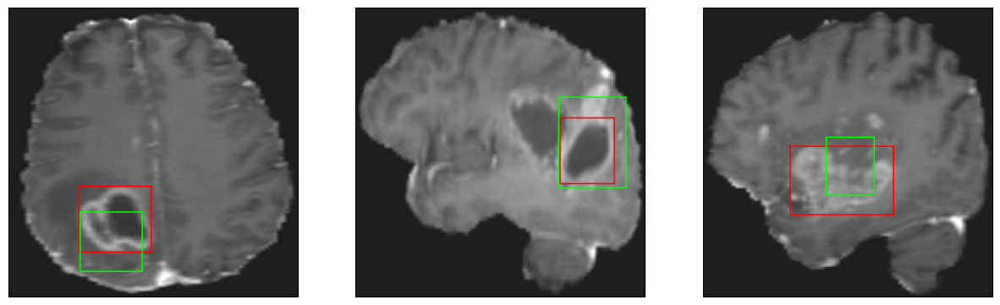

26/26 [==============================] - 3s 99ms/step - loss: 5.8145 - IoU: 0.5657 - val_loss: 11.3815 - val_IoU: 0.4060
Epoch 57/200
26/26 [==============================] - ETA: 0s - loss: 5.6696 - IoU: 0.5776
Epoch 57: val_IoU did not improve from 0.45362
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


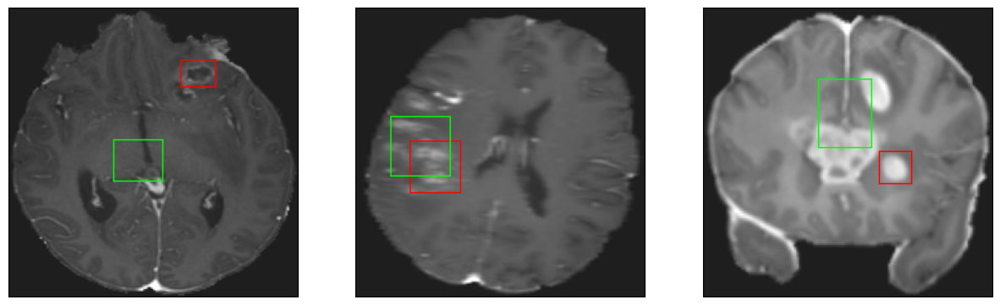

26/26 [==============================] - 3s 116ms/step - loss: 5.6696 - IoU: 0.5776 - val_loss: 11.1726 - val_IoU: 0.4298
Epoch 58/200
26/26 [==============================] - ETA: 0s - loss: 5.4361 - IoU: 0.5900
Epoch 58: val_IoU improved from 0.45362 to 0.45730, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


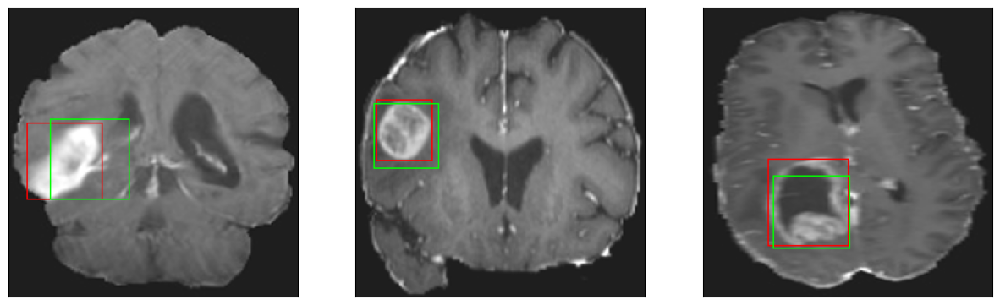

26/26 [==============================] - 3s 125ms/step - loss: 5.4361 - IoU: 0.5900 - val_loss: 10.4701 - val_IoU: 0.4573
Epoch 59/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6979 - IoU: 0.5777
Epoch 59: val_IoU did not improve from 0.45730
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


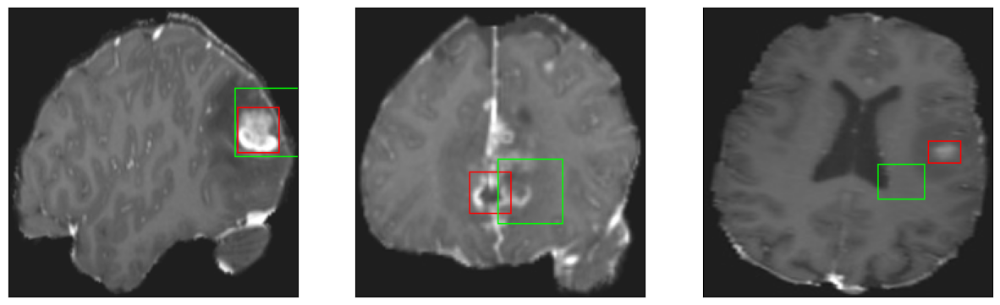

26/26 [==============================] - 2s 93ms/step - loss: 5.6684 - IoU: 0.5768 - val_loss: 11.2269 - val_IoU: 0.4204
Epoch 60/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6435 - IoU: 0.5765
Epoch 60: val_IoU did not improve from 0.45730
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


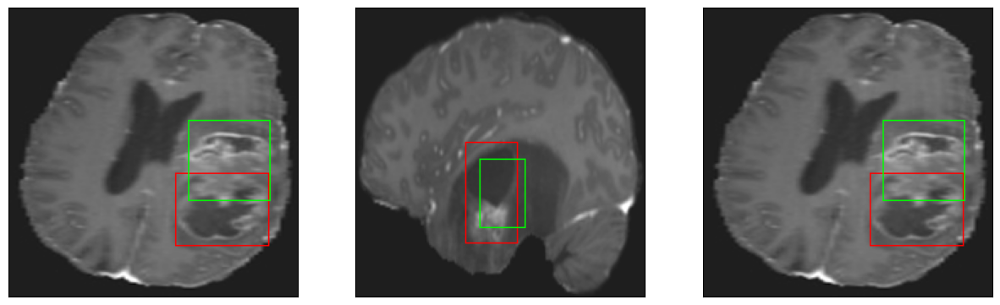

26/26 [==============================] - 3s 97ms/step - loss: 5.6608 - IoU: 0.5765 - val_loss: 12.2949 - val_IoU: 0.3773
Epoch 61/200
26/26 [==============================] - ETA: 0s - loss: 5.8670 - IoU: 0.5689
Epoch 61: val_IoU did not improve from 0.45730
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


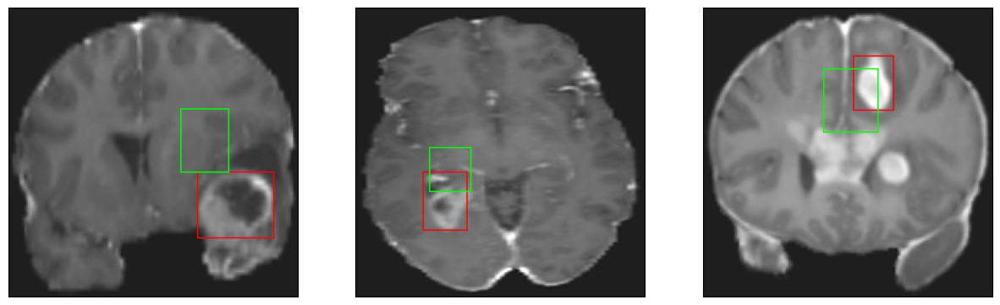

26/26 [==============================] - 3s 125ms/step - loss: 5.8670 - IoU: 0.5689 - val_loss: 12.7540 - val_IoU: 0.3501
Epoch 62/200
26/26 [==============================] - ETA: 0s - loss: 5.7388 - IoU: 0.5671
Epoch 62: val_IoU did not improve from 0.45730
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


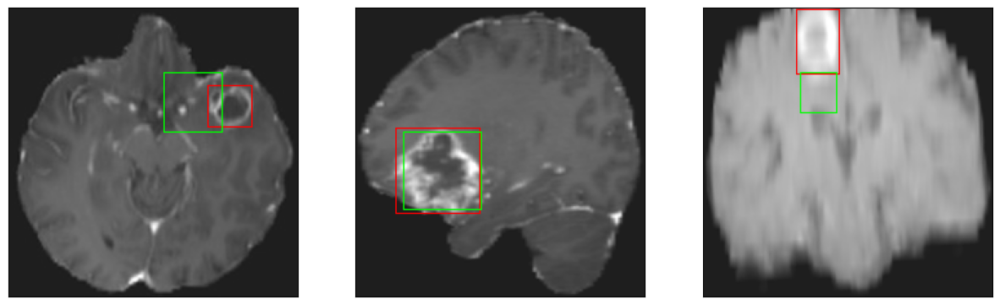

26/26 [==============================] - 3s 123ms/step - loss: 5.7388 - IoU: 0.5671 - val_loss: 11.8412 - val_IoU: 0.3780
Epoch 63/200
25/26 [===========================>..] - ETA: 0s - loss: 5.7079 - IoU: 0.5742
Epoch 63: val_IoU did not improve from 0.45730
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


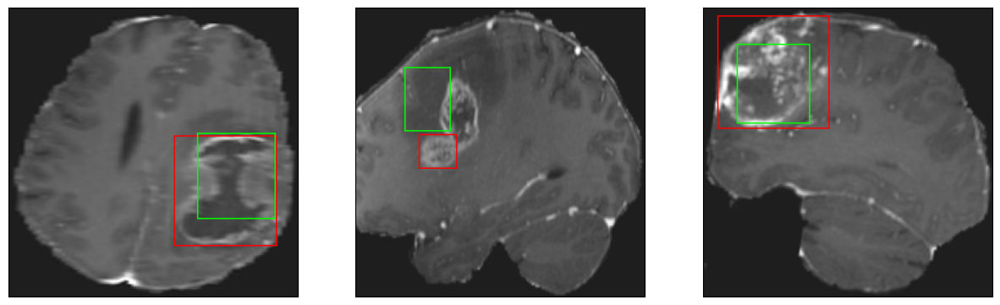

26/26 [==============================] - 3s 99ms/step - loss: 5.7615 - IoU: 0.5729 - val_loss: 11.1211 - val_IoU: 0.4516
Epoch 64/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5391 - IoU: 0.5800
Epoch 64: val_IoU improved from 0.45730 to 0.46444, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


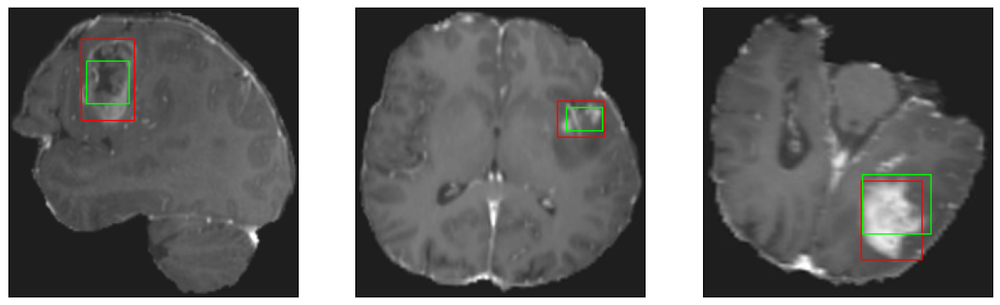

26/26 [==============================] - 3s 118ms/step - loss: 5.5580 - IoU: 0.5801 - val_loss: 10.5931 - val_IoU: 0.4644
Epoch 65/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4234 - IoU: 0.5835
Epoch 65: val_IoU did not improve from 0.46444
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


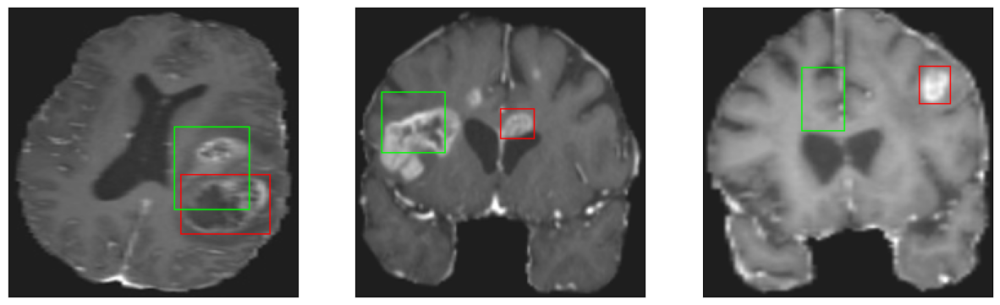

26/26 [==============================] - 3s 108ms/step - loss: 5.4292 - IoU: 0.5832 - val_loss: 12.7177 - val_IoU: 0.3661
Epoch 66/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3410 - IoU: 0.5981
Epoch 66: val_IoU did not improve from 0.46444
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


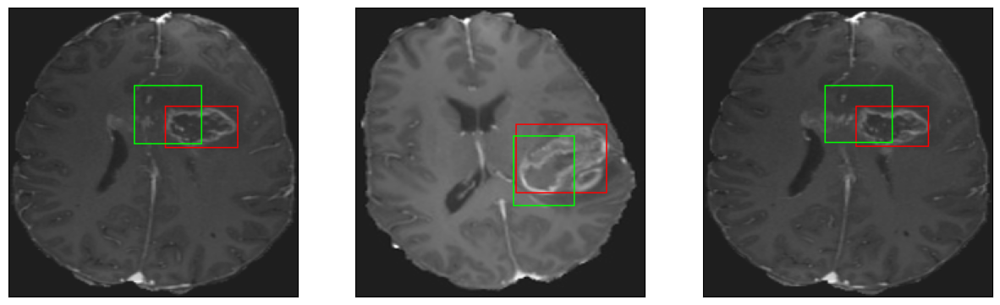

26/26 [==============================] - 3s 118ms/step - loss: 5.3714 - IoU: 0.5959 - val_loss: 12.1939 - val_IoU: 0.3980
Epoch 67/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3078 - IoU: 0.5894
Epoch 67: val_IoU did not improve from 0.46444
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


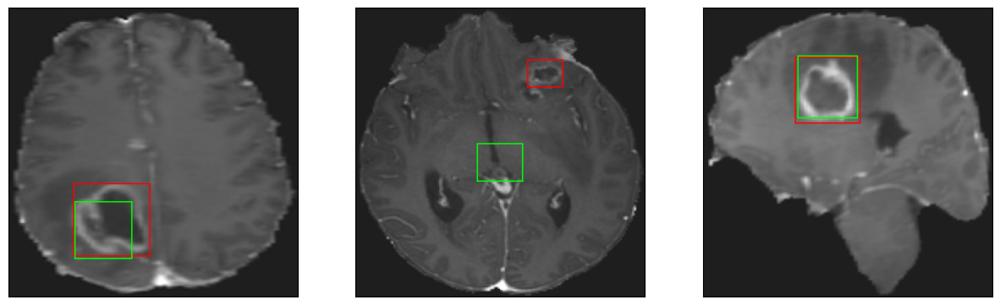

26/26 [==============================] - 3s 104ms/step - loss: 5.2969 - IoU: 0.5896 - val_loss: 12.1415 - val_IoU: 0.3726
Epoch 68/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2775 - IoU: 0.5945
Epoch 68: val_IoU did not improve from 0.46444
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


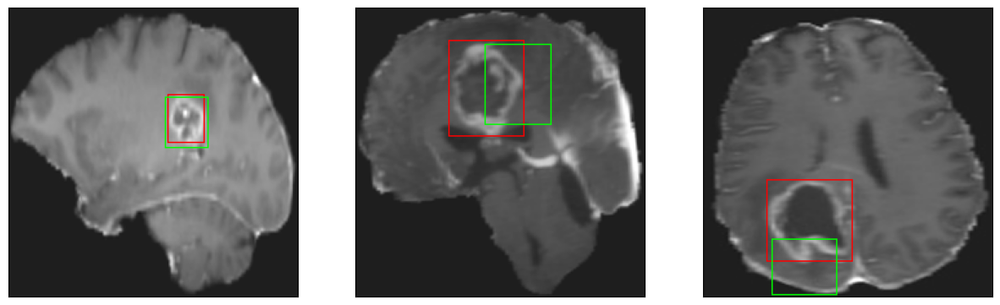

26/26 [==============================] - 3s 99ms/step - loss: 5.2479 - IoU: 0.5952 - val_loss: 10.5754 - val_IoU: 0.4468
Epoch 69/200
26/26 [==============================] - ETA: 0s - loss: 5.3146 - IoU: 0.6011
Epoch 69: val_IoU did not improve from 0.46444
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


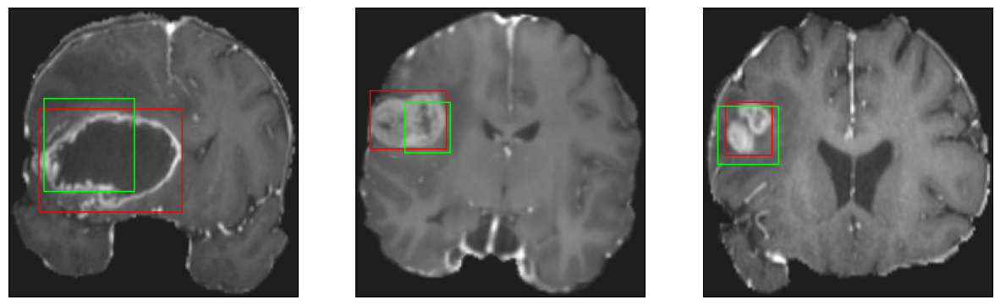

26/26 [==============================] - 3s 108ms/step - loss: 5.3146 - IoU: 0.6011 - val_loss: 10.5313 - val_IoU: 0.4614
Epoch 70/200
26/26 [==============================] - ETA: 0s - loss: 5.1362 - IoU: 0.6040
Epoch 70: val_IoU did not improve from 0.46444
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


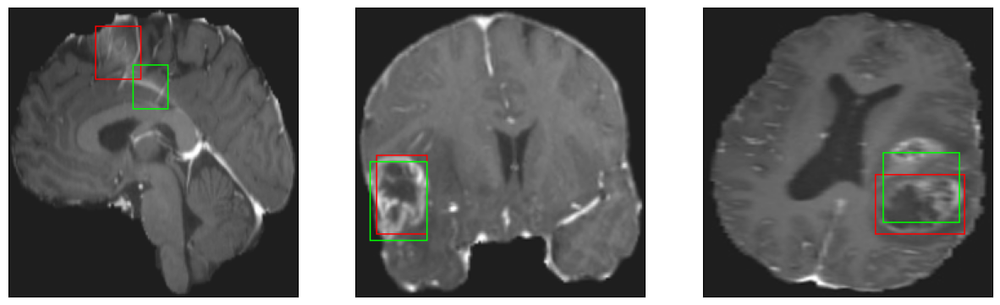

26/26 [==============================] - 3s 130ms/step - loss: 5.1362 - IoU: 0.6040 - val_loss: 11.3942 - val_IoU: 0.4052
Epoch 71/200
26/26 [==============================] - ETA: 0s - loss: 5.1763 - IoU: 0.6063
Epoch 71: val_IoU did not improve from 0.46444
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


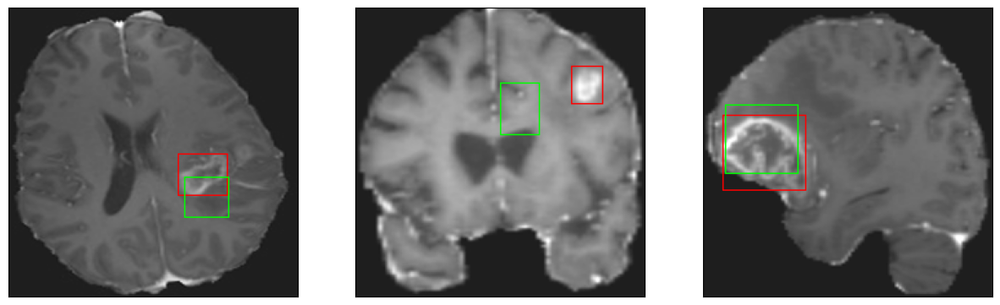

26/26 [==============================] - 3s 102ms/step - loss: 5.1763 - IoU: 0.6063 - val_loss: 10.5472 - val_IoU: 0.4483
Epoch 72/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2480 - IoU: 0.5972
Epoch 72: val_IoU did not improve from 0.46444
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


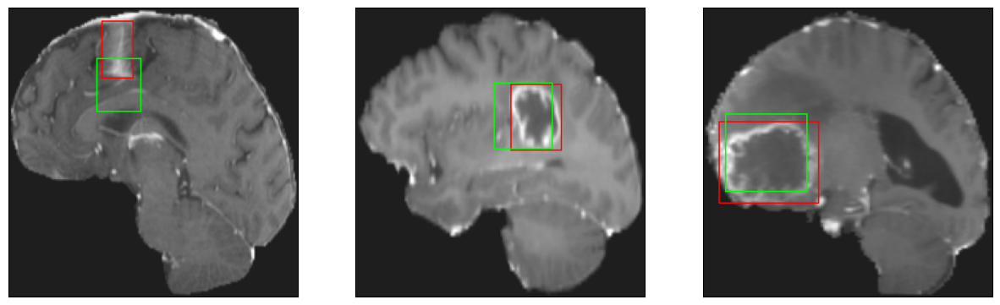

26/26 [==============================] - 3s 106ms/step - loss: 5.2571 - IoU: 0.5975 - val_loss: 11.4679 - val_IoU: 0.4121
Epoch 73/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1021 - IoU: 0.6048
Epoch 73: val_IoU did not improve from 0.46444
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


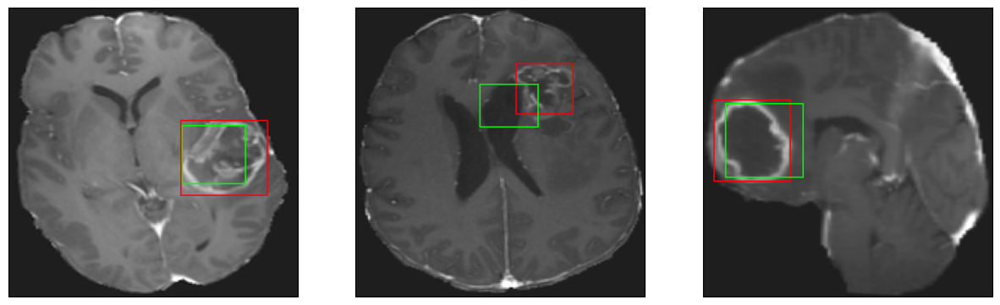

26/26 [==============================] - 3s 126ms/step - loss: 5.0723 - IoU: 0.6071 - val_loss: 10.9693 - val_IoU: 0.4452
Epoch 74/200
26/26 [==============================] - ETA: 0s - loss: 5.2959 - IoU: 0.5990
Epoch 74: val_IoU did not improve from 0.46444
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


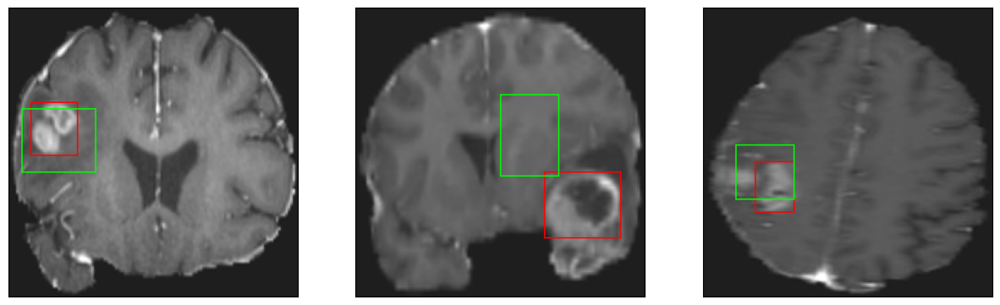

26/26 [==============================] - 3s 101ms/step - loss: 5.2959 - IoU: 0.5990 - val_loss: 12.6523 - val_IoU: 0.3831
Epoch 75/200
26/26 [==============================] - ETA: 0s - loss: 5.2429 - IoU: 0.5940
Epoch 75: val_IoU did not improve from 0.46444
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


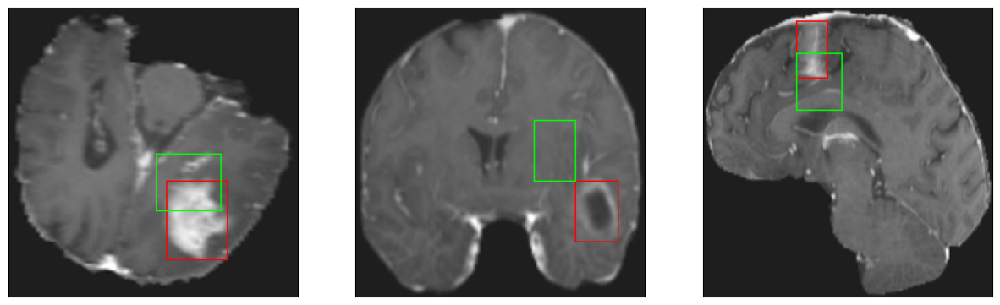

26/26 [==============================] - 3s 97ms/step - loss: 5.2429 - IoU: 0.5940 - val_loss: 11.5322 - val_IoU: 0.4220
Epoch 76/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1639 - IoU: 0.6061
Epoch 76: val_IoU did not improve from 0.46444
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


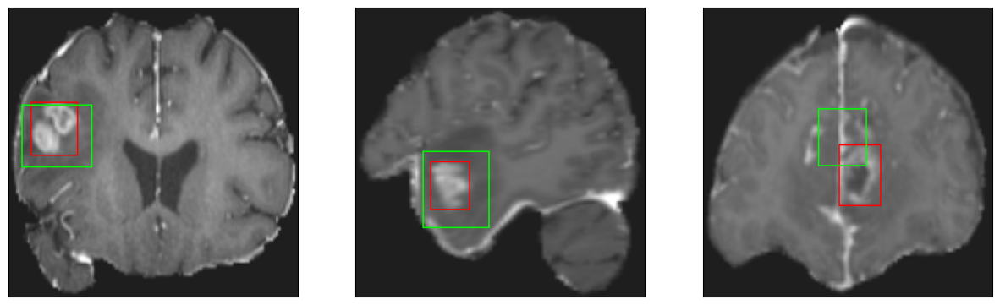

26/26 [==============================] - 3s 113ms/step - loss: 5.1973 - IoU: 0.6045 - val_loss: 11.8677 - val_IoU: 0.4257
Epoch 77/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9898 - IoU: 0.6166
Epoch 77: val_IoU did not improve from 0.46444
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


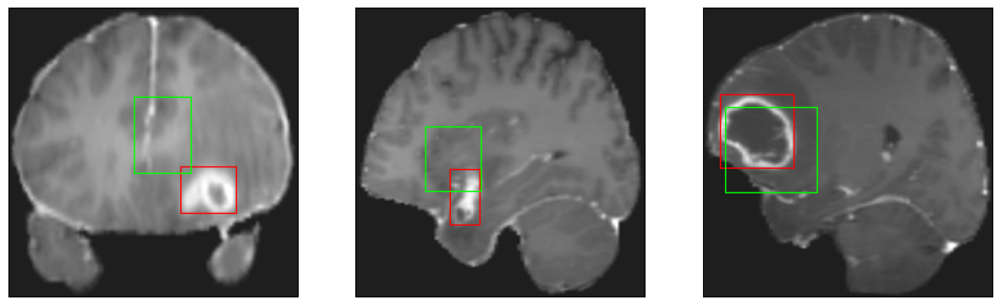

26/26 [==============================] - 3s 114ms/step - loss: 4.9856 - IoU: 0.6162 - val_loss: 12.8862 - val_IoU: 0.3781
Epoch 78/200
26/26 [==============================] - ETA: 0s - loss: 5.0962 - IoU: 0.6112
Epoch 78: val_IoU did not improve from 0.46444
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


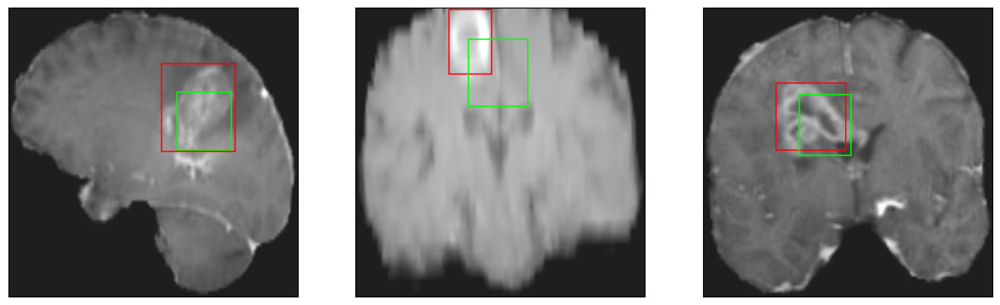

26/26 [==============================] - 2s 96ms/step - loss: 5.0962 - IoU: 0.6112 - val_loss: 11.9994 - val_IoU: 0.3935
Epoch 79/200
26/26 [==============================] - ETA: 0s - loss: 5.1907 - IoU: 0.6106
Epoch 79: val_IoU did not improve from 0.46444
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


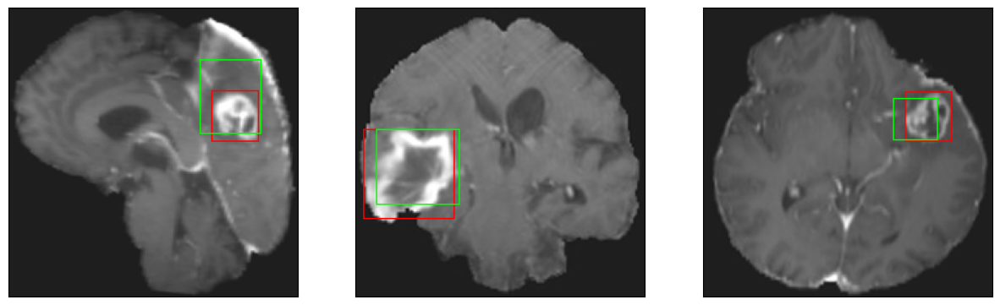

26/26 [==============================] - 3s 109ms/step - loss: 5.1907 - IoU: 0.6106 - val_loss: 11.6592 - val_IoU: 0.3935
Epoch 80/200
26/26 [==============================] - ETA: 0s - loss: 5.0956 - IoU: 0.6117
Epoch 80: val_IoU did not improve from 0.46444
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


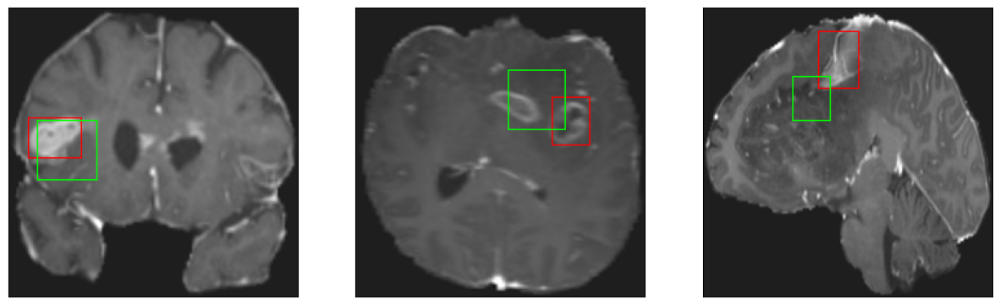

26/26 [==============================] - 3s 135ms/step - loss: 5.0956 - IoU: 0.6117 - val_loss: 10.4583 - val_IoU: 0.4571
Epoch 81/200
26/26 [==============================] - ETA: 0s - loss: 4.9088 - IoU: 0.6198
Epoch 81: val_IoU did not improve from 0.46444
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


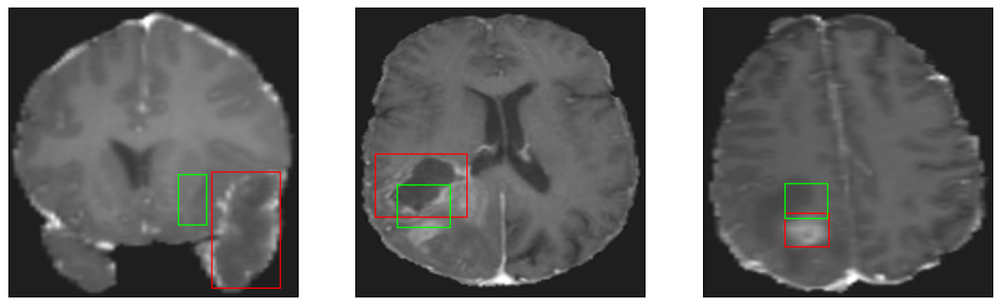

26/26 [==============================] - 2s 94ms/step - loss: 4.9088 - IoU: 0.6198 - val_loss: 11.0007 - val_IoU: 0.4410
Epoch 82/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8737 - IoU: 0.6240
Epoch 82: val_IoU improved from 0.46444 to 0.49212, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


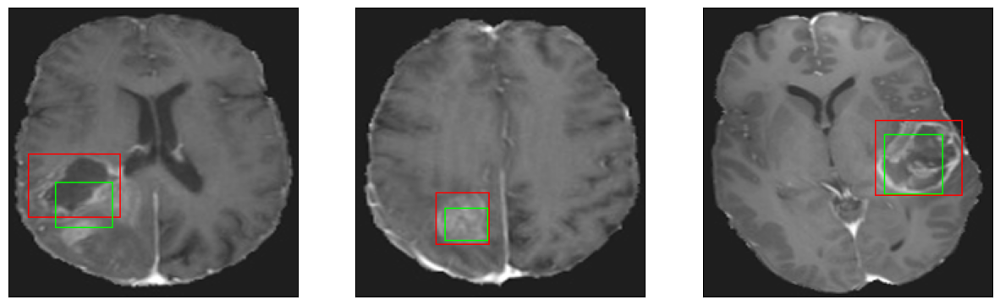

26/26 [==============================] - 3s 118ms/step - loss: 4.8647 - IoU: 0.6239 - val_loss: 9.6840 - val_IoU: 0.4921
Epoch 83/200
26/26 [==============================] - ETA: 0s - loss: 4.8234 - IoU: 0.6230
Epoch 83: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


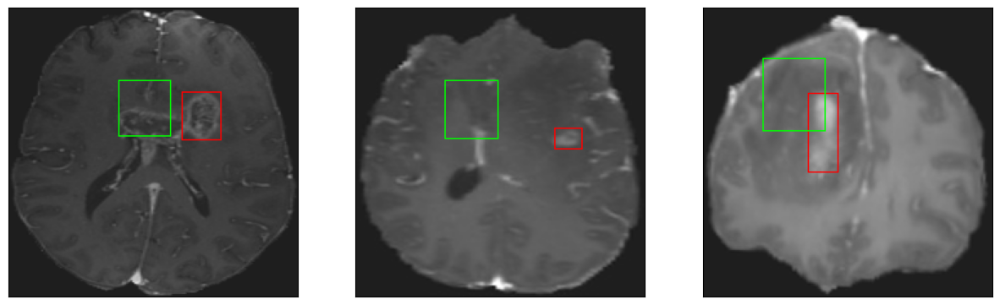

26/26 [==============================] - 2s 96ms/step - loss: 4.8234 - IoU: 0.6230 - val_loss: 14.2204 - val_IoU: 0.3135
Epoch 84/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0436 - IoU: 0.6086
Epoch 84: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


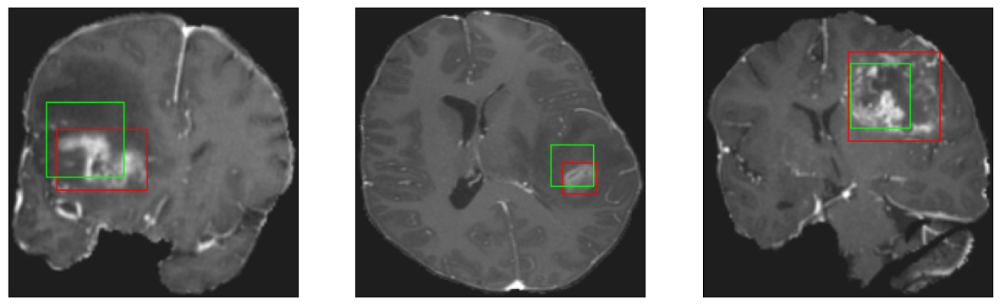

26/26 [==============================] - 3s 104ms/step - loss: 5.0298 - IoU: 0.6086 - val_loss: 10.1833 - val_IoU: 0.4717
Epoch 85/200
26/26 [==============================] - ETA: 0s - loss: 4.9869 - IoU: 0.6126
Epoch 85: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


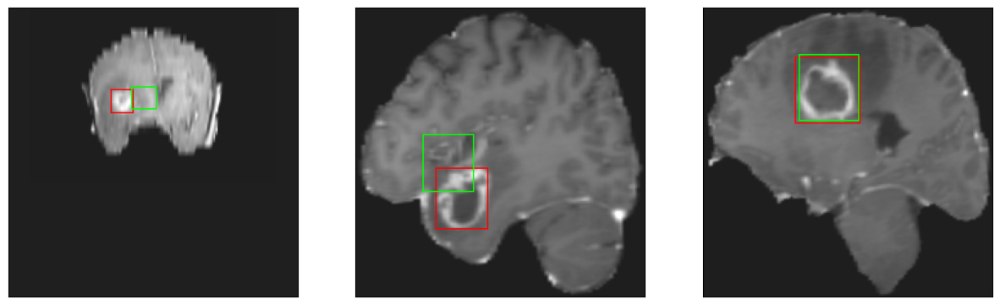

26/26 [==============================] - 3s 114ms/step - loss: 4.9869 - IoU: 0.6126 - val_loss: 10.8429 - val_IoU: 0.4395
Epoch 86/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0971 - IoU: 0.6106
Epoch 86: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


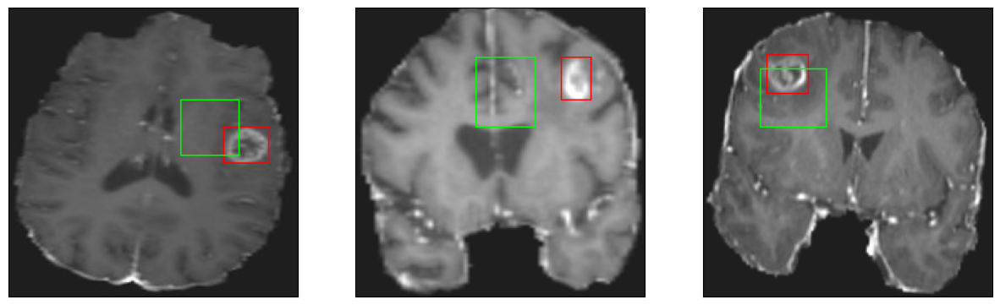

26/26 [==============================] - 3s 107ms/step - loss: 5.0578 - IoU: 0.6107 - val_loss: 17.1603 - val_IoU: 0.2475
Epoch 87/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9188 - IoU: 0.6168
Epoch 87: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


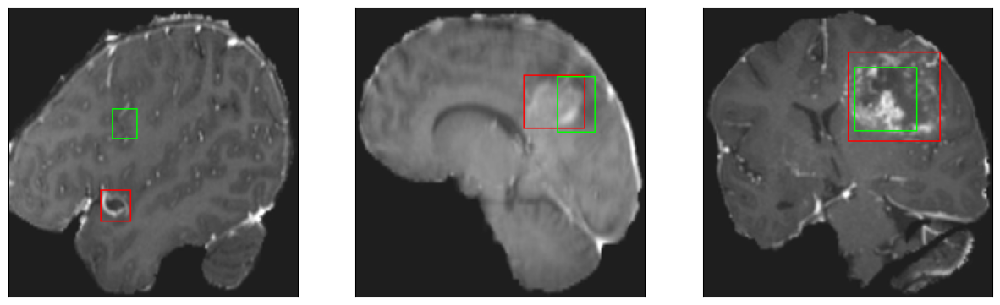

26/26 [==============================] - 3s 101ms/step - loss: 4.9186 - IoU: 0.6157 - val_loss: 10.6099 - val_IoU: 0.4503
Epoch 88/200
26/26 [==============================] - ETA: 0s - loss: 5.0458 - IoU: 0.6115
Epoch 88: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


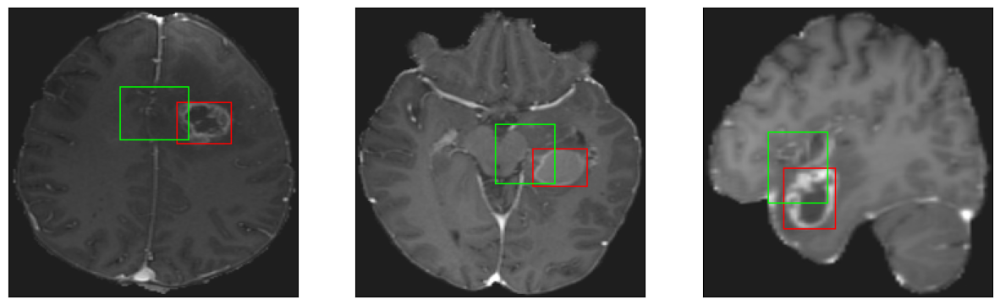

26/26 [==============================] - 3s 122ms/step - loss: 5.0458 - IoU: 0.6115 - val_loss: 10.9124 - val_IoU: 0.4309
Epoch 89/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0016 - IoU: 0.6153
Epoch 89: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


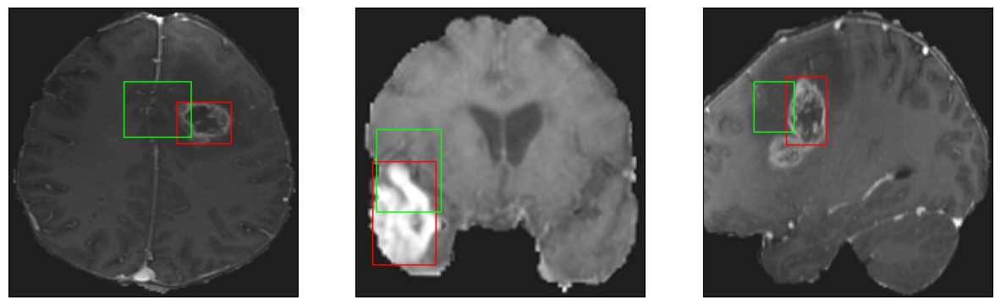

26/26 [==============================] - 3s 100ms/step - loss: 5.0312 - IoU: 0.6144 - val_loss: 13.7430 - val_IoU: 0.3539
Epoch 90/200
26/26 [==============================] - ETA: 0s - loss: 4.9731 - IoU: 0.6165
Epoch 90: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


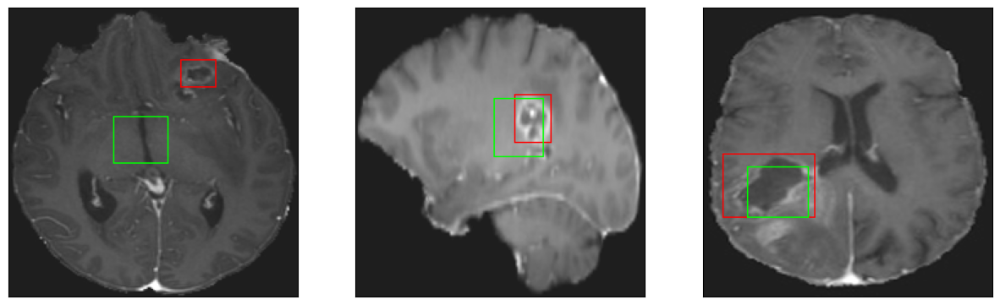

26/26 [==============================] - 3s 98ms/step - loss: 4.9731 - IoU: 0.6165 - val_loss: 15.0158 - val_IoU: 0.2821
Epoch 91/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2290 - IoU: 0.5981
Epoch 91: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


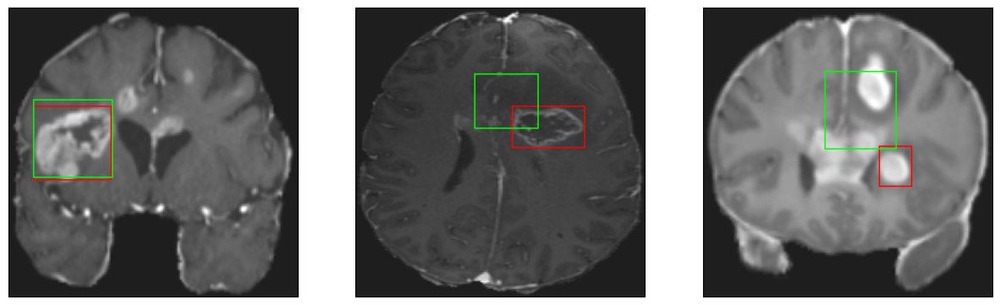

26/26 [==============================] - 3s 118ms/step - loss: 5.2308 - IoU: 0.5986 - val_loss: 11.3900 - val_IoU: 0.4380
Epoch 92/200
26/26 [==============================] - ETA: 0s - loss: 5.0144 - IoU: 0.6164
Epoch 92: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


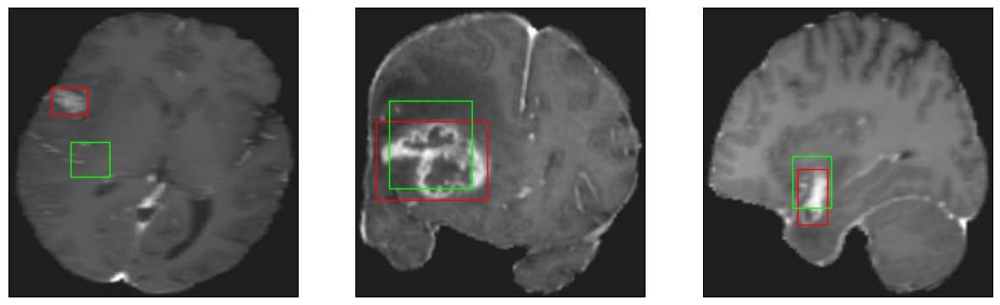

26/26 [==============================] - 3s 110ms/step - loss: 5.0144 - IoU: 0.6164 - val_loss: 10.9827 - val_IoU: 0.4317
Epoch 93/200
26/26 [==============================] - ETA: 0s - loss: 5.0446 - IoU: 0.6111
Epoch 93: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 7ms/step
4


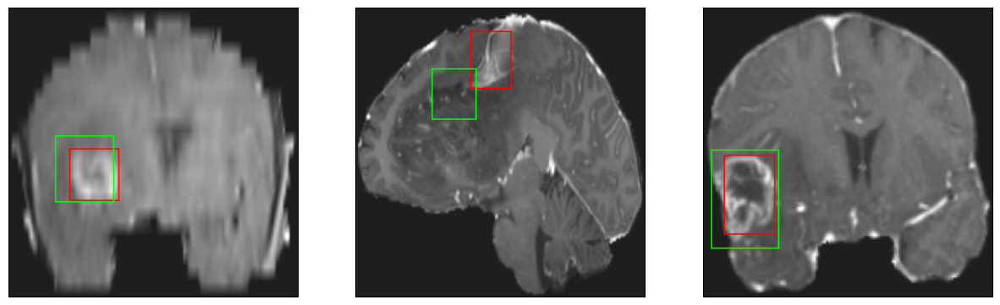

26/26 [==============================] - 3s 118ms/step - loss: 5.0446 - IoU: 0.6111 - val_loss: 10.7184 - val_IoU: 0.4573
Epoch 94/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9283 - IoU: 0.6159
Epoch 94: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


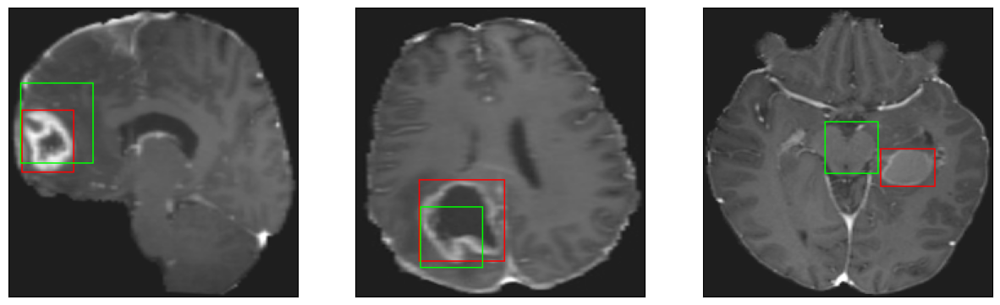

26/26 [==============================] - 3s 103ms/step - loss: 4.9113 - IoU: 0.6158 - val_loss: 10.9729 - val_IoU: 0.4283
Epoch 95/200
26/26 [==============================] - ETA: 0s - loss: 4.8697 - IoU: 0.6266
Epoch 95: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


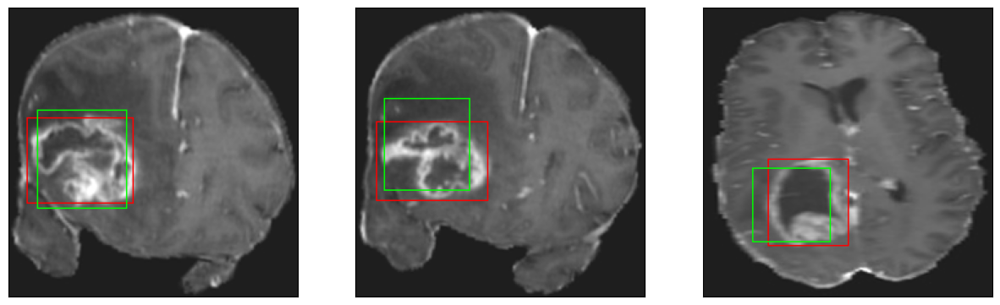

26/26 [==============================] - 3s 132ms/step - loss: 4.8697 - IoU: 0.6266 - val_loss: 11.9924 - val_IoU: 0.3915
Epoch 96/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8648 - IoU: 0.6244
Epoch 96: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


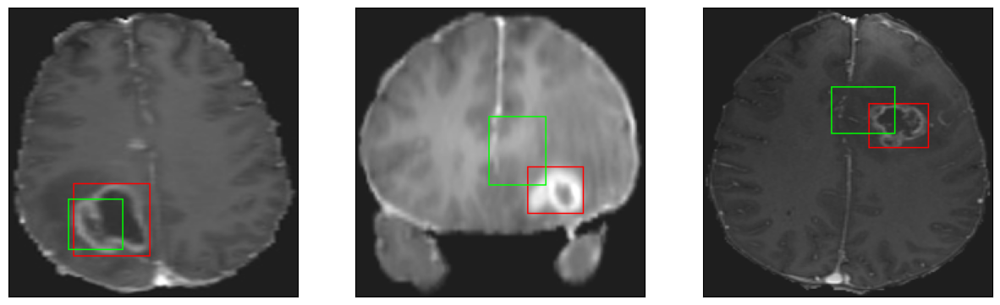

26/26 [==============================] - 3s 122ms/step - loss: 4.8908 - IoU: 0.6227 - val_loss: 11.0021 - val_IoU: 0.4401
Epoch 97/200
26/26 [==============================] - ETA: 0s - loss: 4.8738 - IoU: 0.6252
Epoch 97: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


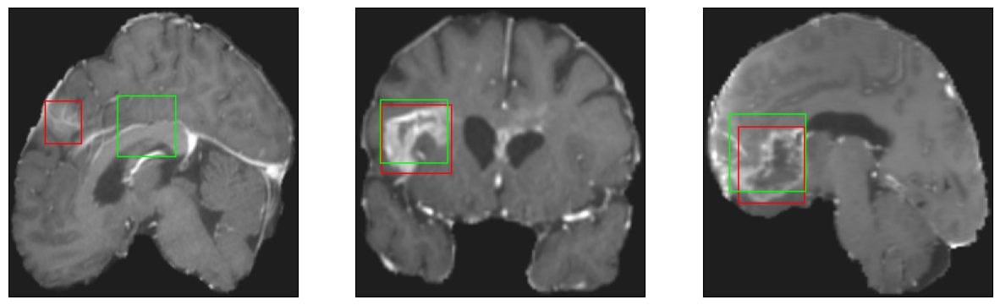

26/26 [==============================] - 3s 126ms/step - loss: 4.8738 - IoU: 0.6252 - val_loss: 10.2422 - val_IoU: 0.4621
Epoch 98/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7768 - IoU: 0.6230
Epoch 98: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


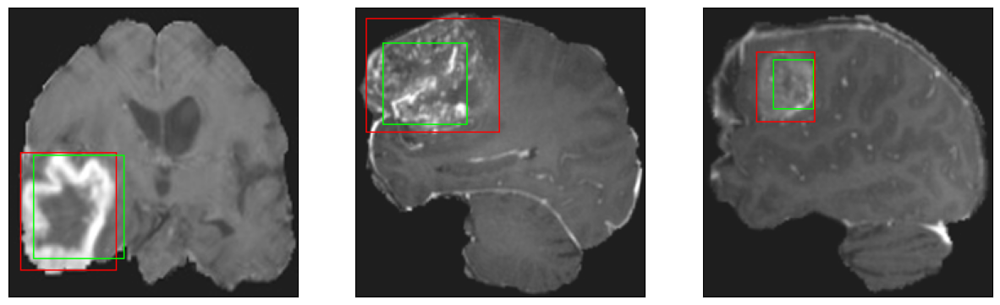

26/26 [==============================] - 3s 121ms/step - loss: 4.7978 - IoU: 0.6223 - val_loss: 10.4067 - val_IoU: 0.4497
Epoch 99/200
26/26 [==============================] - ETA: 0s - loss: 4.7598 - IoU: 0.6313
Epoch 99: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


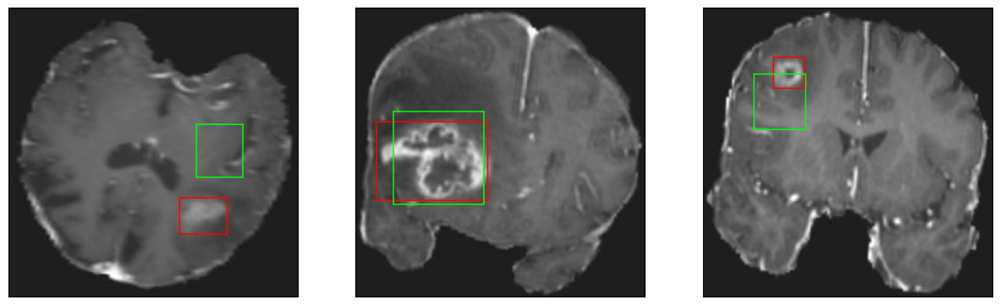

26/26 [==============================] - 3s 127ms/step - loss: 4.7598 - IoU: 0.6313 - val_loss: 10.8062 - val_IoU: 0.4395
Epoch 100/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0743 - IoU: 0.6106
Epoch 100: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


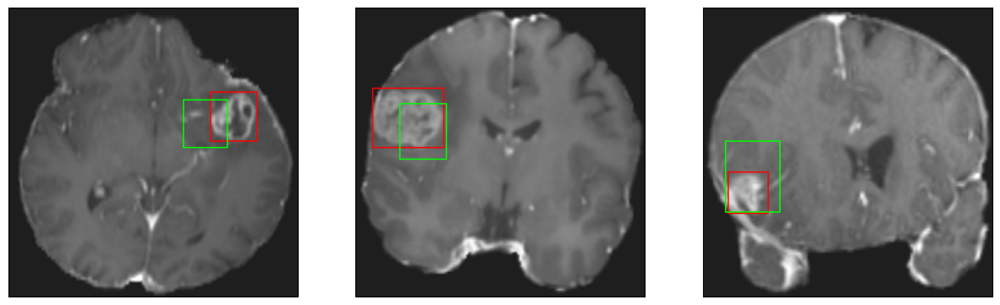

26/26 [==============================] - 4s 139ms/step - loss: 5.0793 - IoU: 0.6114 - val_loss: 14.4911 - val_IoU: 0.3260
Epoch 101/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7706 - IoU: 0.6307
Epoch 101: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


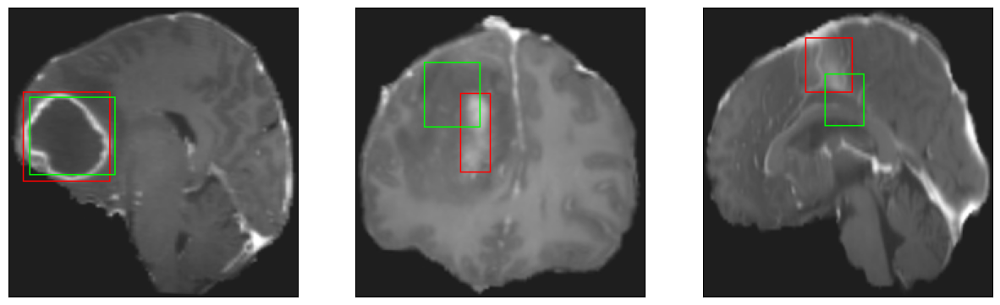

26/26 [==============================] - 3s 119ms/step - loss: 4.7614 - IoU: 0.6304 - val_loss: 10.1344 - val_IoU: 0.4671
Epoch 102/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5891 - IoU: 0.6392
Epoch 102: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


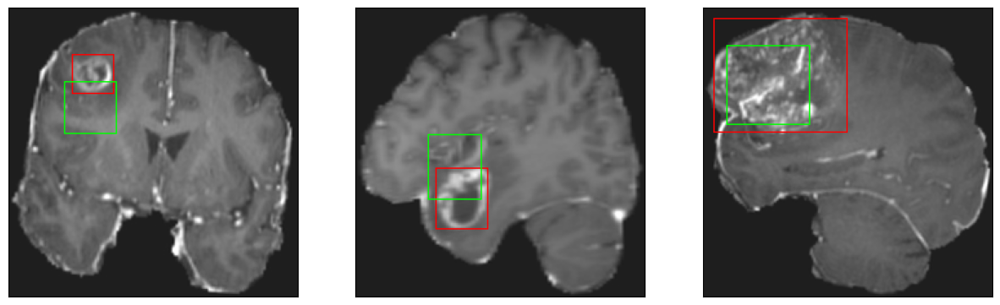

26/26 [==============================] - 3s 100ms/step - loss: 4.6014 - IoU: 0.6384 - val_loss: 10.8510 - val_IoU: 0.4459
Epoch 103/200
26/26 [==============================] - ETA: 0s - loss: 4.7186 - IoU: 0.6302
Epoch 103: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


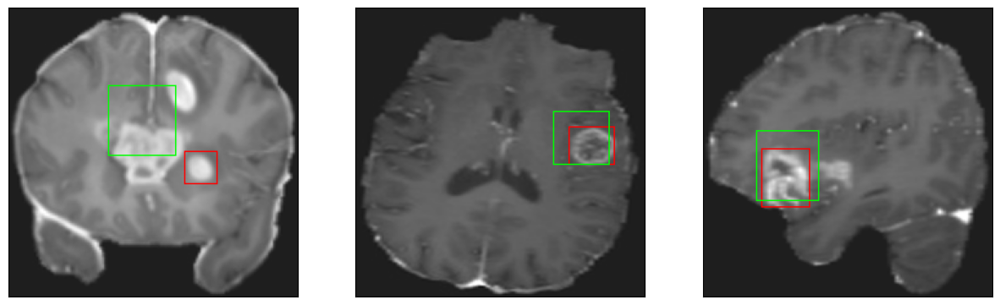

26/26 [==============================] - 3s 112ms/step - loss: 4.7186 - IoU: 0.6302 - val_loss: 10.5888 - val_IoU: 0.4678
Epoch 104/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7827 - IoU: 0.6299
Epoch 104: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


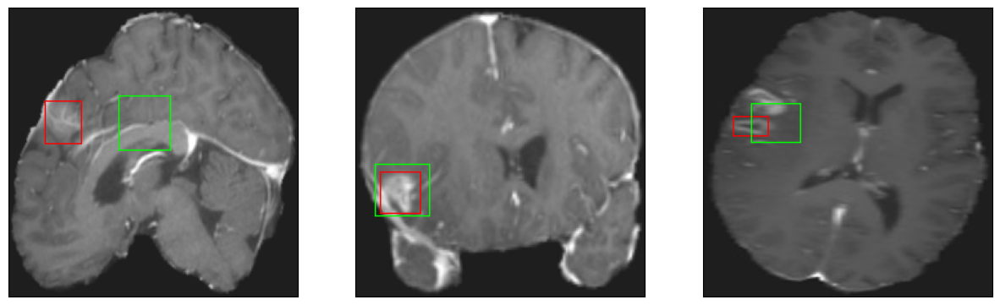

26/26 [==============================] - 3s 99ms/step - loss: 4.8030 - IoU: 0.6290 - val_loss: 10.6850 - val_IoU: 0.4429
Epoch 105/200
26/26 [==============================] - ETA: 0s - loss: 4.7993 - IoU: 0.6302
Epoch 105: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


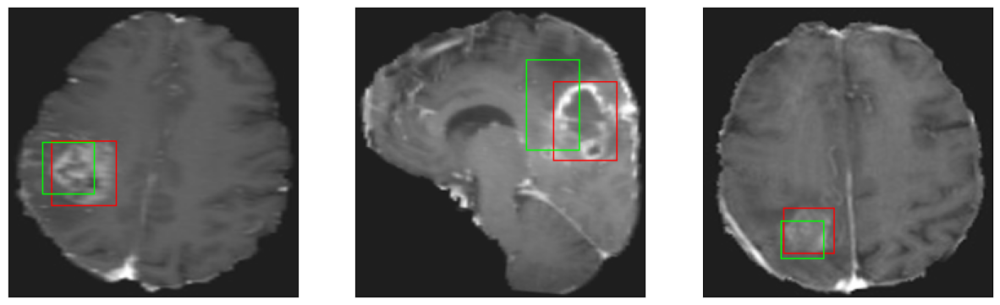

26/26 [==============================] - 3s 101ms/step - loss: 4.7993 - IoU: 0.6302 - val_loss: 10.6066 - val_IoU: 0.4478
Epoch 106/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8373 - IoU: 0.6271
Epoch 106: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


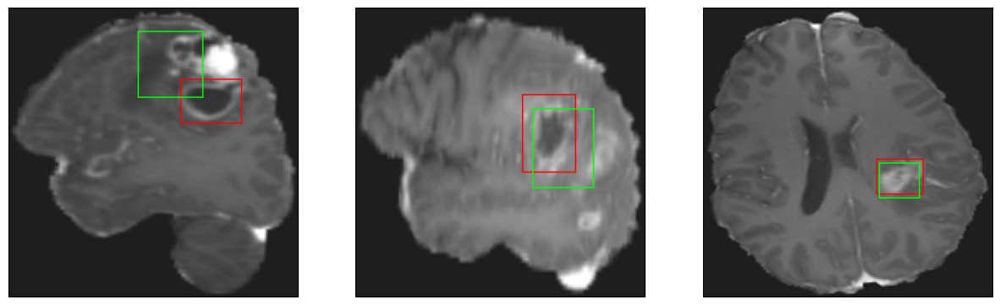

26/26 [==============================] - 3s 115ms/step - loss: 4.8321 - IoU: 0.6278 - val_loss: 10.2253 - val_IoU: 0.4560
Epoch 107/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6726 - IoU: 0.6371
Epoch 107: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


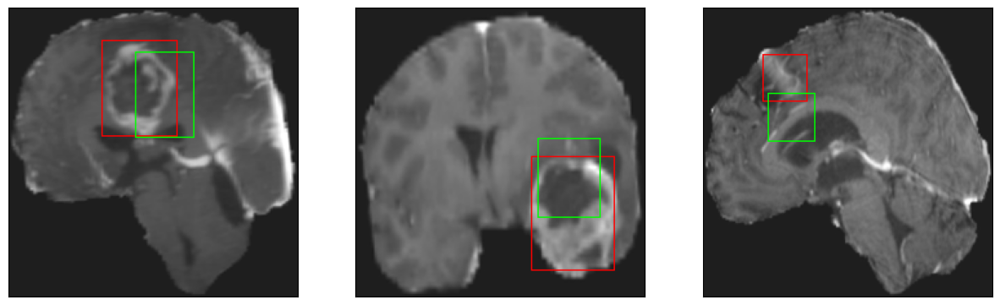

26/26 [==============================] - 3s 101ms/step - loss: 4.7038 - IoU: 0.6349 - val_loss: 10.2044 - val_IoU: 0.4682
Epoch 108/200
26/26 [==============================] - ETA: 0s - loss: 4.6984 - IoU: 0.6406
Epoch 108: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


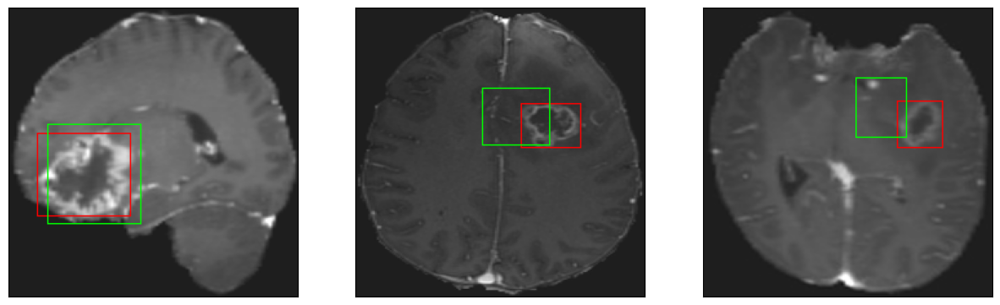

26/26 [==============================] - 3s 104ms/step - loss: 4.6984 - IoU: 0.6406 - val_loss: 10.6367 - val_IoU: 0.4604
Epoch 109/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7590 - IoU: 0.6291
Epoch 109: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4


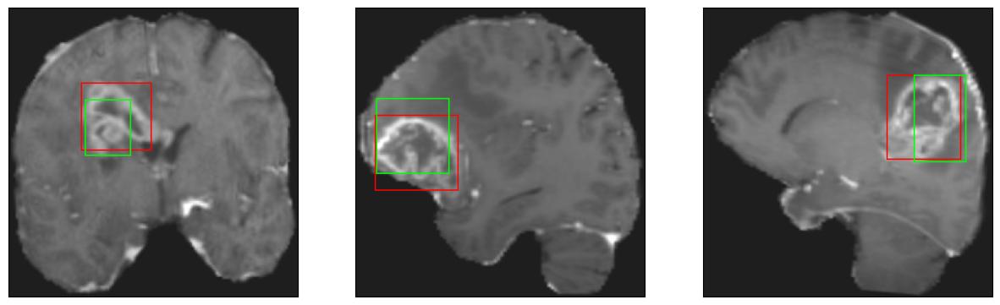

26/26 [==============================] - 3s 133ms/step - loss: 4.7680 - IoU: 0.6281 - val_loss: 10.9305 - val_IoU: 0.4430
Epoch 110/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7126 - IoU: 0.6347
Epoch 110: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


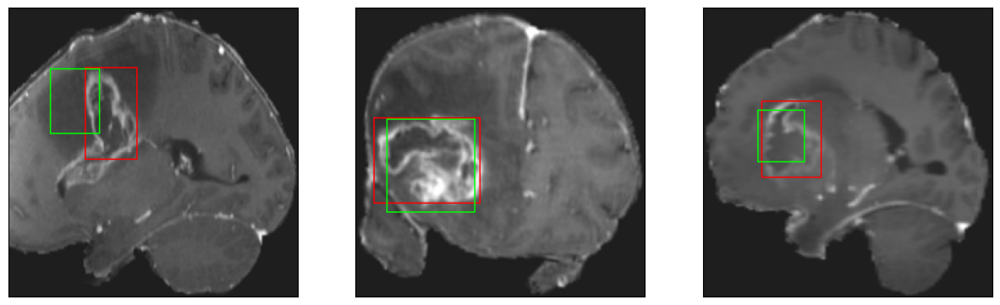

26/26 [==============================] - 2s 95ms/step - loss: 4.7218 - IoU: 0.6329 - val_loss: 10.4752 - val_IoU: 0.4463
Epoch 111/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6602 - IoU: 0.6341
Epoch 111: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


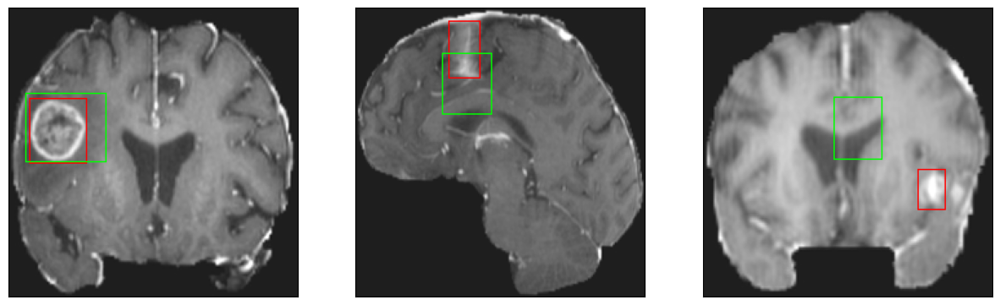

26/26 [==============================] - 3s 105ms/step - loss: 4.7304 - IoU: 0.6316 - val_loss: 10.4186 - val_IoU: 0.4638
Epoch 112/200
26/26 [==============================] - ETA: 0s - loss: 4.6020 - IoU: 0.6411
Epoch 112: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


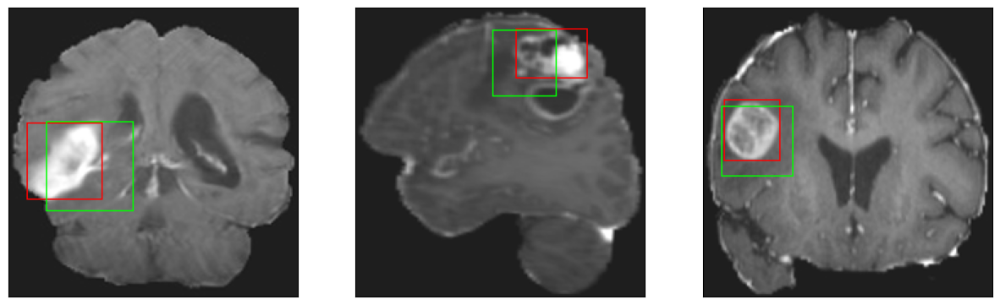

26/26 [==============================] - 3s 114ms/step - loss: 4.6020 - IoU: 0.6411 - val_loss: 10.7556 - val_IoU: 0.4557
Epoch 113/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7662 - IoU: 0.6346
Epoch 113: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


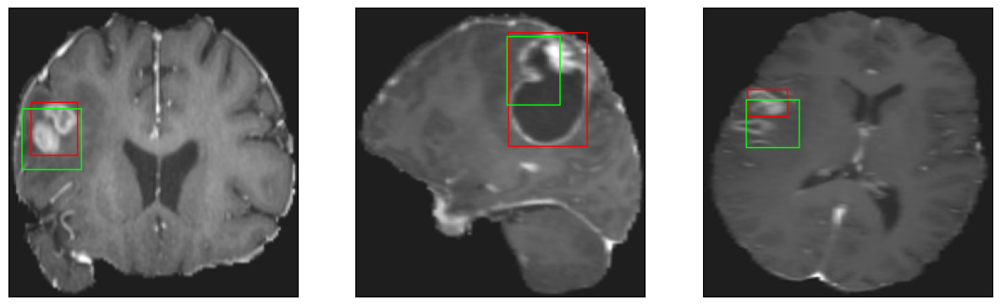

26/26 [==============================] - 3s 124ms/step - loss: 4.7527 - IoU: 0.6355 - val_loss: 10.2074 - val_IoU: 0.4773
Epoch 114/200
26/26 [==============================] - ETA: 0s - loss: 4.6381 - IoU: 0.6391
Epoch 114: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


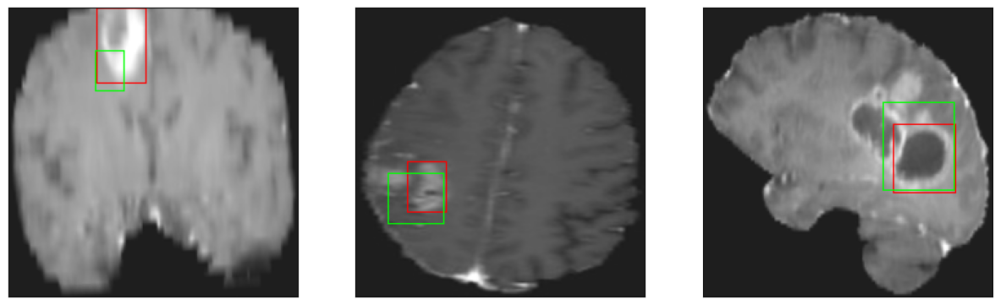

26/26 [==============================] - 3s 97ms/step - loss: 4.6381 - IoU: 0.6391 - val_loss: 10.1393 - val_IoU: 0.4712
Epoch 115/200
26/26 [==============================] - ETA: 0s - loss: 4.7133 - IoU: 0.6259
Epoch 115: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


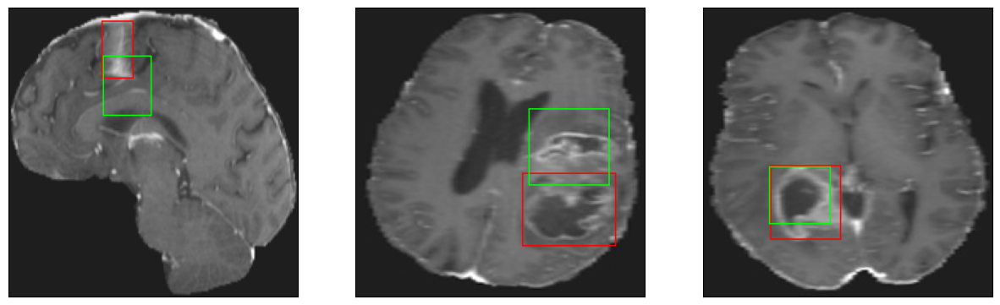

26/26 [==============================] - 3s 115ms/step - loss: 4.7133 - IoU: 0.6259 - val_loss: 10.2839 - val_IoU: 0.4661
Epoch 116/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8330 - IoU: 0.6262
Epoch 116: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


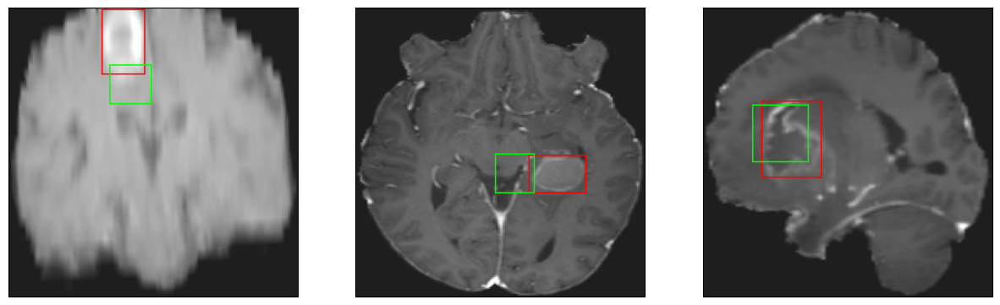

26/26 [==============================] - 3s 121ms/step - loss: 4.8403 - IoU: 0.6259 - val_loss: 10.3777 - val_IoU: 0.4518
Epoch 117/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5492 - IoU: 0.6399
Epoch 117: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


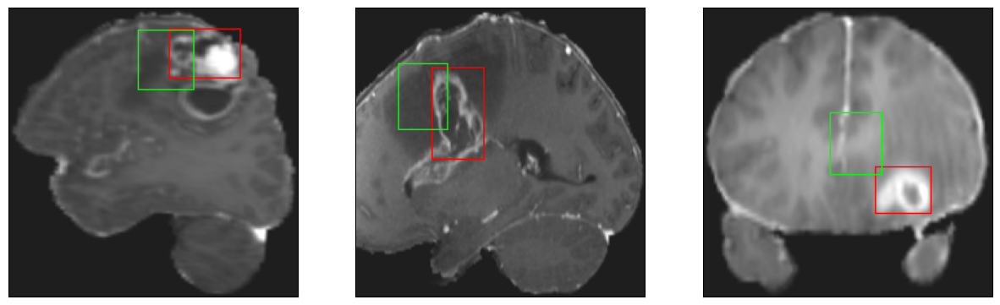

26/26 [==============================] - 3s 107ms/step - loss: 4.5796 - IoU: 0.6404 - val_loss: 11.9070 - val_IoU: 0.3898
Epoch 118/200
26/26 [==============================] - ETA: 0s - loss: 4.6281 - IoU: 0.6421
Epoch 118: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


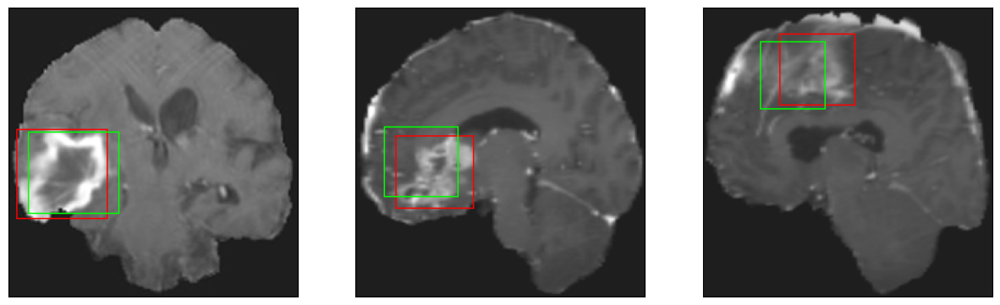

26/26 [==============================] - 3s 107ms/step - loss: 4.6281 - IoU: 0.6421 - val_loss: 10.2867 - val_IoU: 0.4537
Epoch 119/200
26/26 [==============================] - ETA: 0s - loss: 4.6667 - IoU: 0.6327
Epoch 119: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


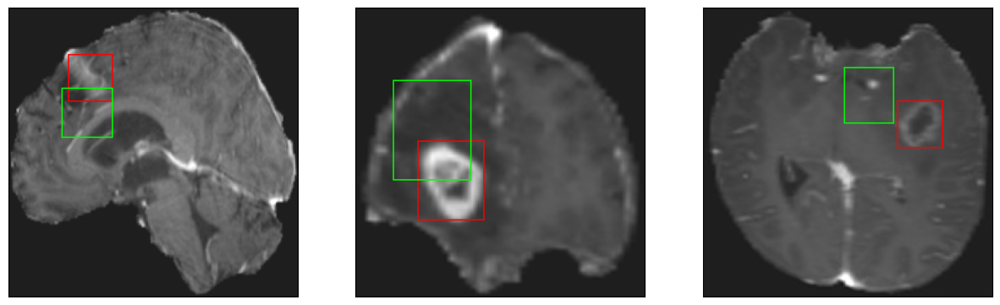

26/26 [==============================] - 3s 117ms/step - loss: 4.6667 - IoU: 0.6327 - val_loss: 10.1431 - val_IoU: 0.4826
Epoch 120/200
26/26 [==============================] - ETA: 0s - loss: 4.6293 - IoU: 0.6363
Epoch 120: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


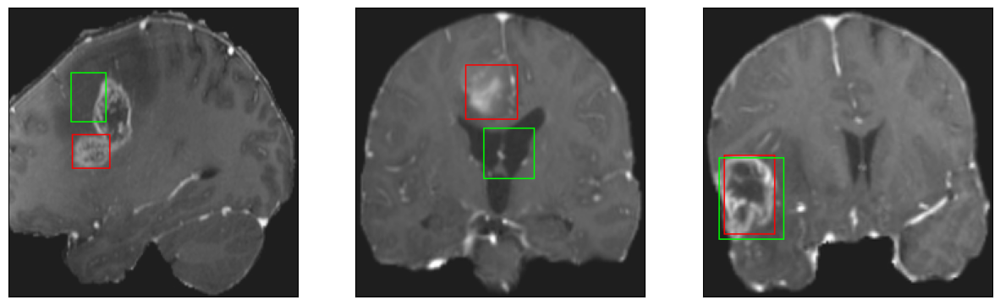

26/26 [==============================] - 3s 134ms/step - loss: 4.6293 - IoU: 0.6363 - val_loss: 10.1117 - val_IoU: 0.4623
Epoch 121/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7085 - IoU: 0.6252
Epoch 121: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


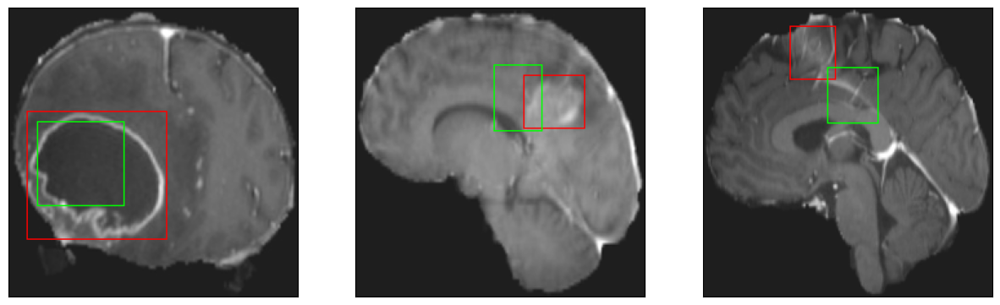

26/26 [==============================] - 3s 103ms/step - loss: 4.6745 - IoU: 0.6270 - val_loss: 13.9476 - val_IoU: 0.3289
Epoch 122/200
26/26 [==============================] - ETA: 0s - loss: 4.7331 - IoU: 0.6289
Epoch 122: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


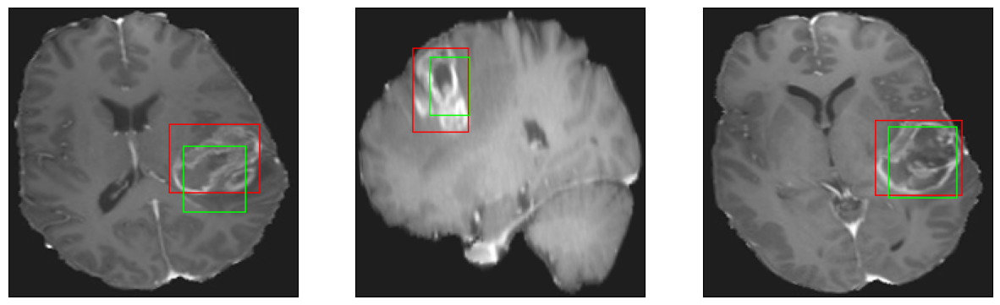

26/26 [==============================] - 3s 111ms/step - loss: 4.7331 - IoU: 0.6289 - val_loss: 10.3315 - val_IoU: 0.4802
Epoch 123/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6945 - IoU: 0.6321
Epoch 123: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


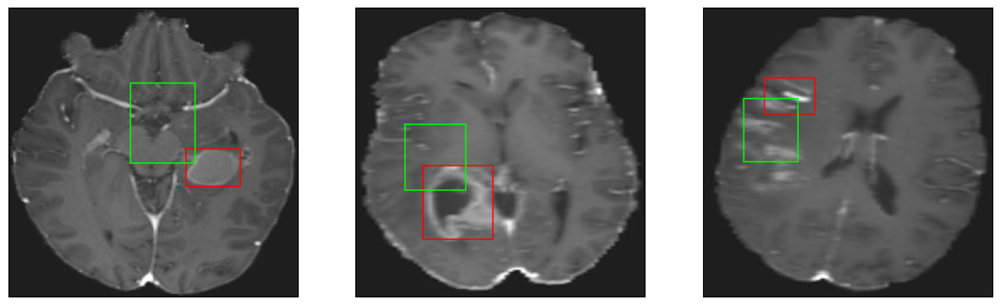

26/26 [==============================] - 3s 115ms/step - loss: 4.7108 - IoU: 0.6311 - val_loss: 17.3224 - val_IoU: 0.2455
Epoch 124/200
26/26 [==============================] - ETA: 0s - loss: 4.5290 - IoU: 0.6443
Epoch 124: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


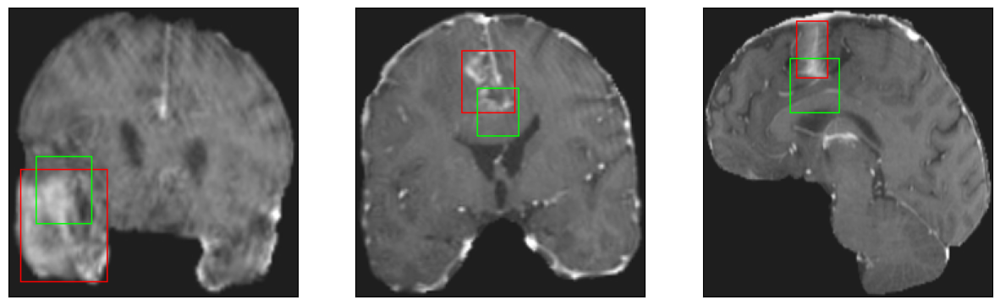

26/26 [==============================] - 3s 125ms/step - loss: 4.5290 - IoU: 0.6443 - val_loss: 10.8581 - val_IoU: 0.4492
Epoch 125/200
26/26 [==============================] - ETA: 0s - loss: 4.6775 - IoU: 0.6336
Epoch 125: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


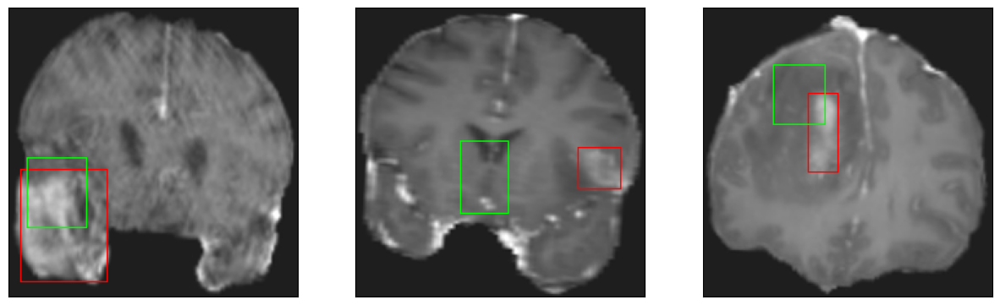

26/26 [==============================] - 3s 107ms/step - loss: 4.6775 - IoU: 0.6336 - val_loss: 10.4645 - val_IoU: 0.4633
Epoch 126/200
26/26 [==============================] - ETA: 0s - loss: 4.6058 - IoU: 0.6375
Epoch 126: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


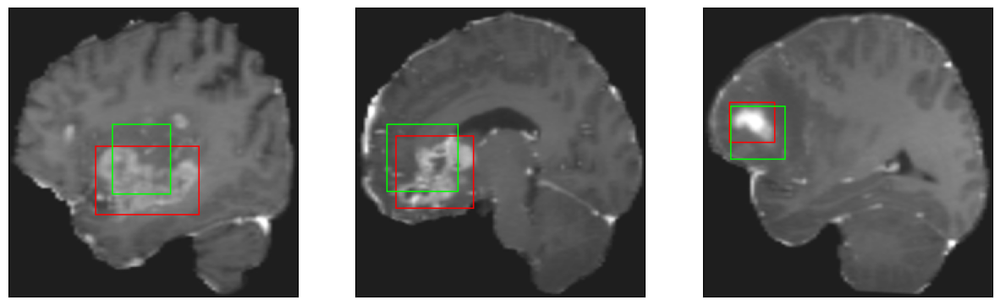

26/26 [==============================] - 3s 100ms/step - loss: 4.6058 - IoU: 0.6375 - val_loss: 10.2368 - val_IoU: 0.4564
Epoch 127/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3674 - IoU: 0.6482
Epoch 127: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


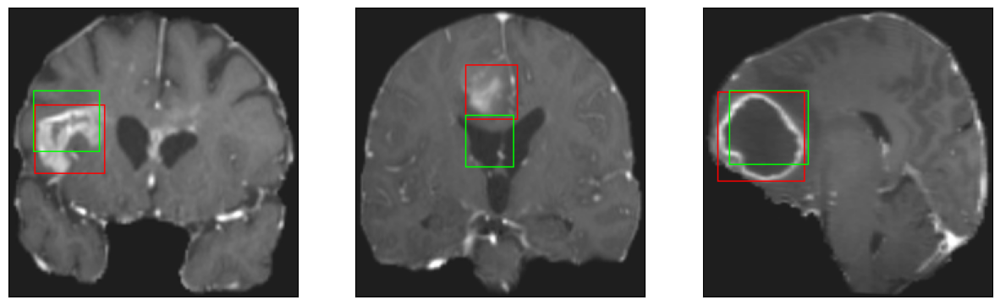

26/26 [==============================] - 2s 94ms/step - loss: 4.4105 - IoU: 0.6463 - val_loss: 12.0091 - val_IoU: 0.3812
Epoch 128/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5930 - IoU: 0.6347
Epoch 128: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


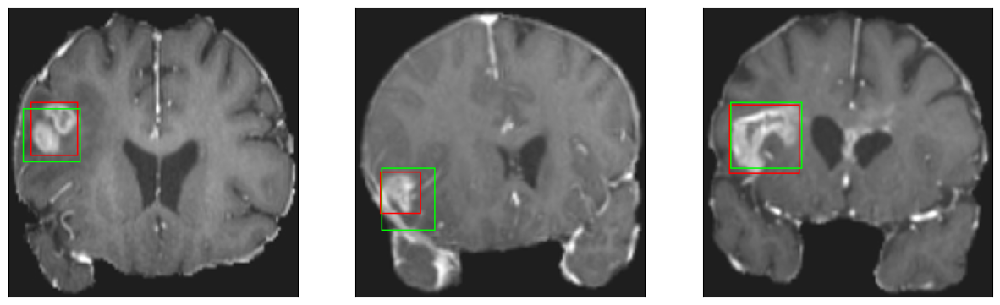

26/26 [==============================] - 3s 111ms/step - loss: 4.6623 - IoU: 0.6335 - val_loss: 10.2737 - val_IoU: 0.4583
Epoch 129/200
26/26 [==============================] - ETA: 0s - loss: 4.5101 - IoU: 0.6380
Epoch 129: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


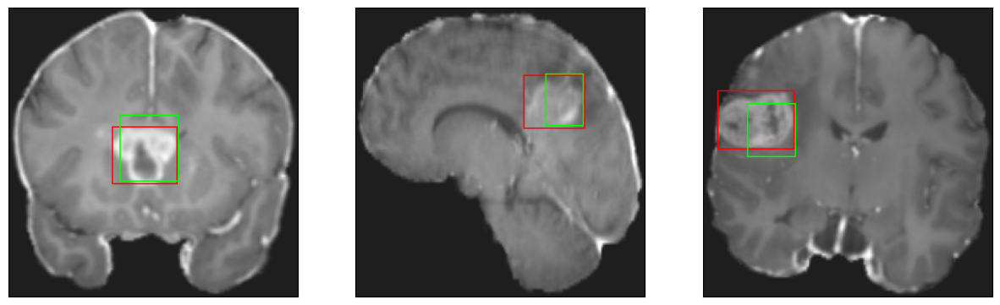

26/26 [==============================] - 3s 126ms/step - loss: 4.5101 - IoU: 0.6380 - val_loss: 10.2600 - val_IoU: 0.4671
Epoch 130/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7407 - IoU: 0.6236
Epoch 130: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


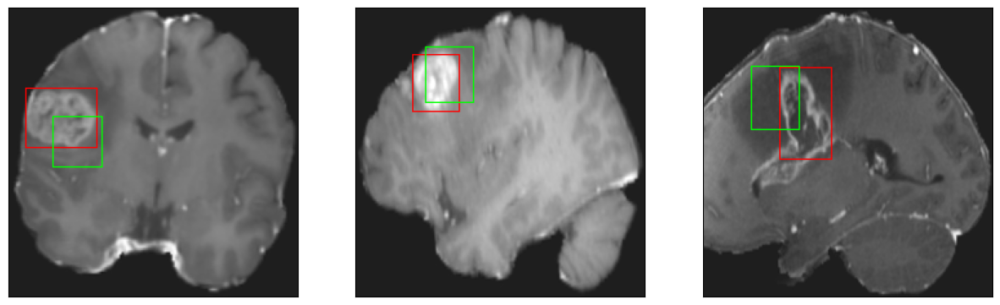

26/26 [==============================] - 3s 109ms/step - loss: 4.7320 - IoU: 0.6231 - val_loss: 10.3505 - val_IoU: 0.4545
Epoch 131/200
26/26 [==============================] - ETA: 0s - loss: 4.5391 - IoU: 0.6366
Epoch 131: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


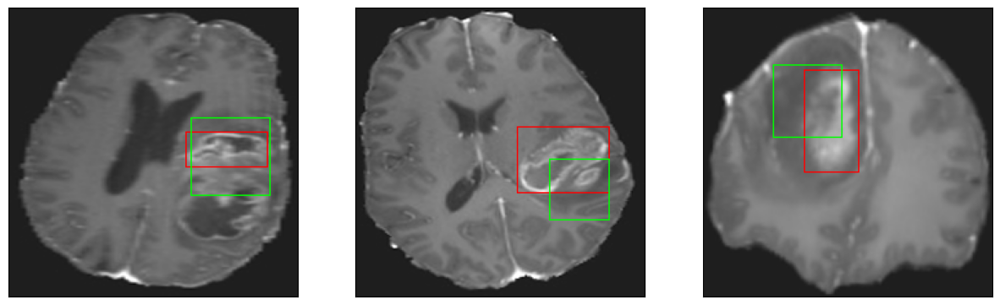

26/26 [==============================] - 3s 99ms/step - loss: 4.5391 - IoU: 0.6366 - val_loss: 10.6205 - val_IoU: 0.4475
Epoch 132/200
26/26 [==============================] - ETA: 0s - loss: 4.6088 - IoU: 0.6298
Epoch 132: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 10ms/step
4


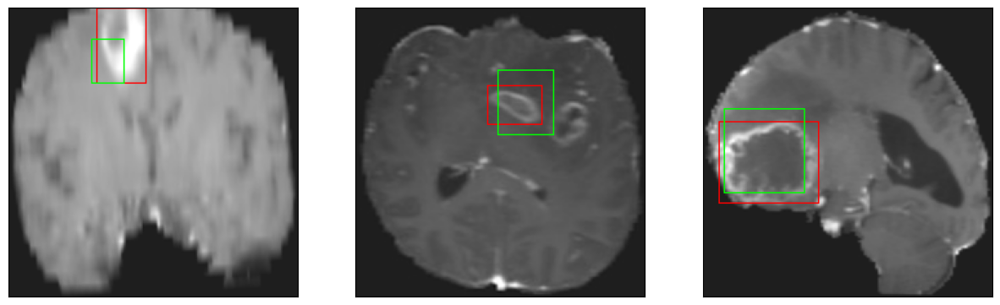

26/26 [==============================] - 3s 126ms/step - loss: 4.6088 - IoU: 0.6298 - val_loss: 12.9209 - val_IoU: 0.3312
Epoch 133/200
26/26 [==============================] - ETA: 0s - loss: 4.6101 - IoU: 0.6361
Epoch 133: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


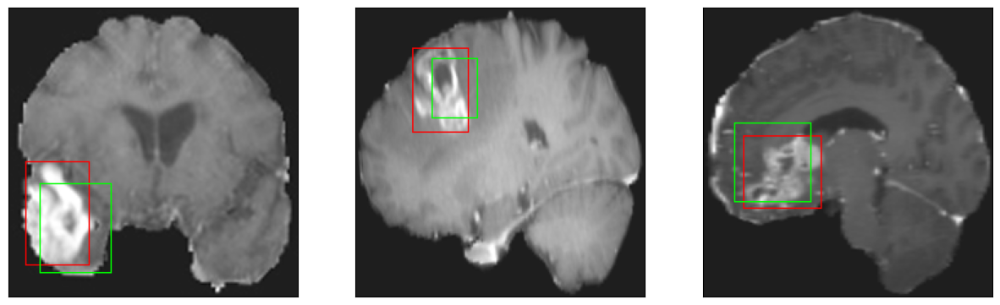

26/26 [==============================] - 3s 102ms/step - loss: 4.6101 - IoU: 0.6361 - val_loss: 10.6698 - val_IoU: 0.4657
Epoch 134/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7523 - IoU: 0.6344
Epoch 134: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


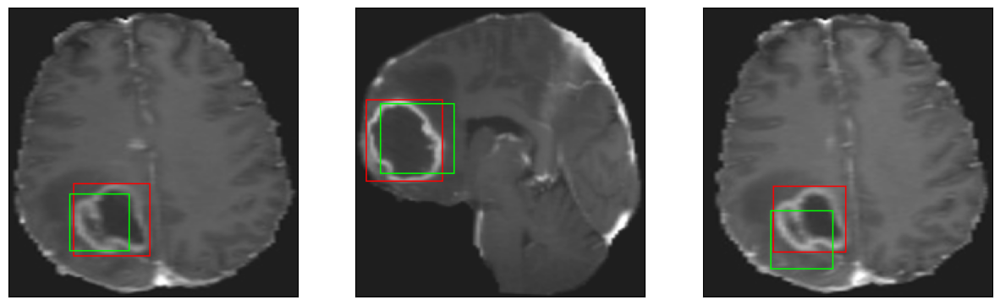

26/26 [==============================] - 2s 87ms/step - loss: 4.7212 - IoU: 0.6348 - val_loss: 10.3035 - val_IoU: 0.4744
Epoch 135/200
26/26 [==============================] - ETA: 0s - loss: 4.5047 - IoU: 0.6493
Epoch 135: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


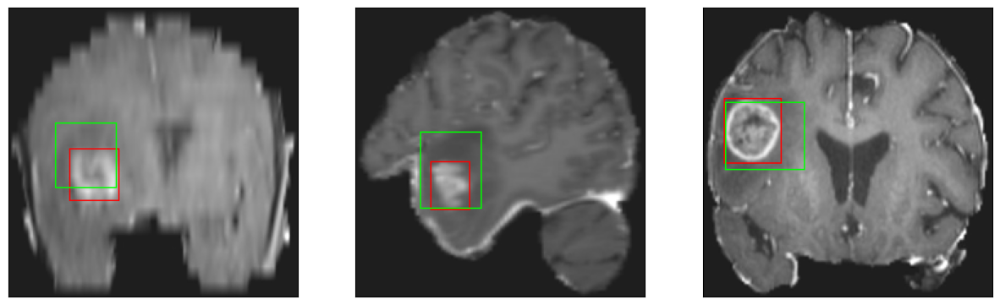

26/26 [==============================] - 2s 88ms/step - loss: 4.5047 - IoU: 0.6493 - val_loss: 10.7254 - val_IoU: 0.4528
Epoch 136/200
26/26 [==============================] - ETA: 0s - loss: 4.4779 - IoU: 0.6403
Epoch 136: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


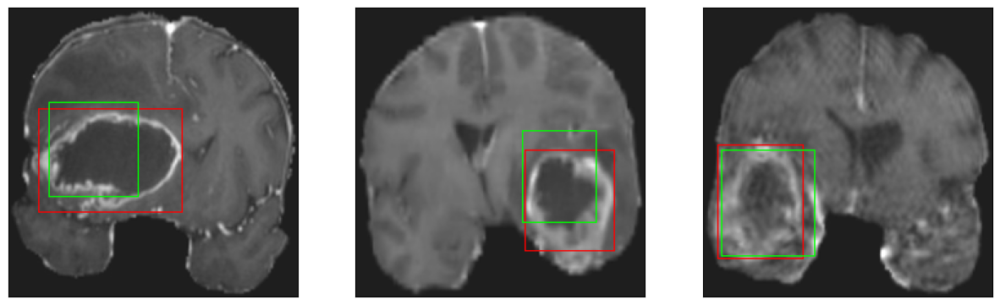

26/26 [==============================] - 2s 92ms/step - loss: 4.4779 - IoU: 0.6403 - val_loss: 10.3773 - val_IoU: 0.4704
Epoch 137/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6637 - IoU: 0.6319
Epoch 137: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


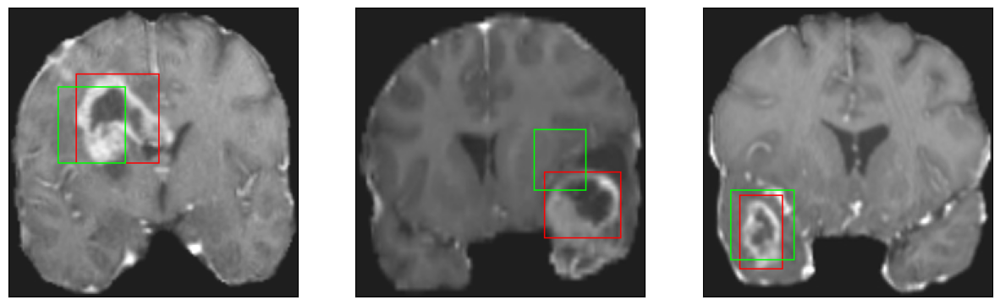

26/26 [==============================] - 3s 119ms/step - loss: 4.6508 - IoU: 0.6334 - val_loss: 10.6545 - val_IoU: 0.4421
Epoch 138/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4432 - IoU: 0.6468
Epoch 138: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


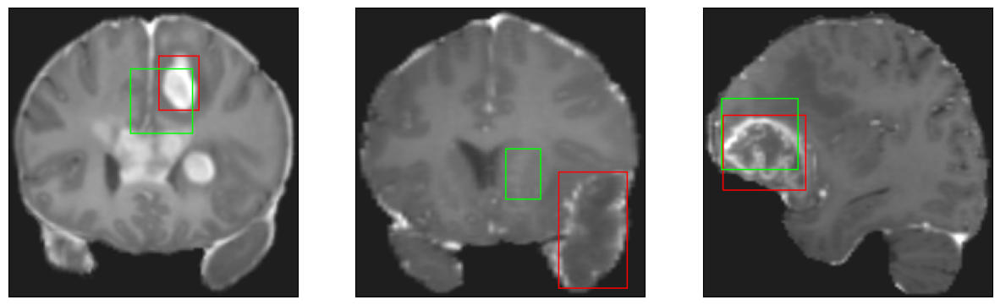

26/26 [==============================] - 3s 102ms/step - loss: 4.4145 - IoU: 0.6470 - val_loss: 11.7392 - val_IoU: 0.3956
Epoch 139/200
26/26 [==============================] - ETA: 0s - loss: 4.5777 - IoU: 0.6370
Epoch 139: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


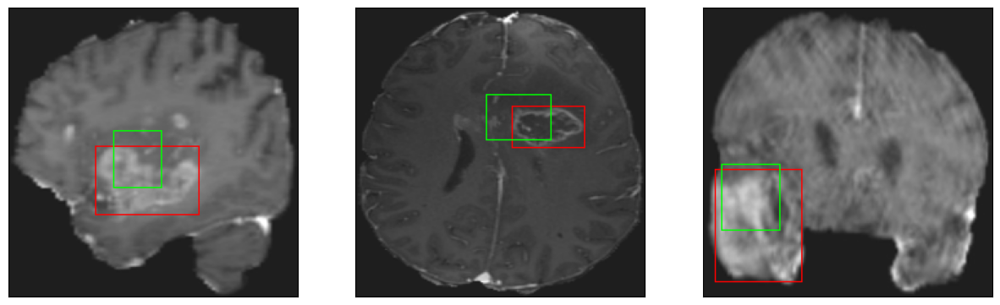

26/26 [==============================] - 3s 102ms/step - loss: 4.5777 - IoU: 0.6370 - val_loss: 10.3468 - val_IoU: 0.4556
Epoch 140/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5236 - IoU: 0.6376
Epoch 140: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4


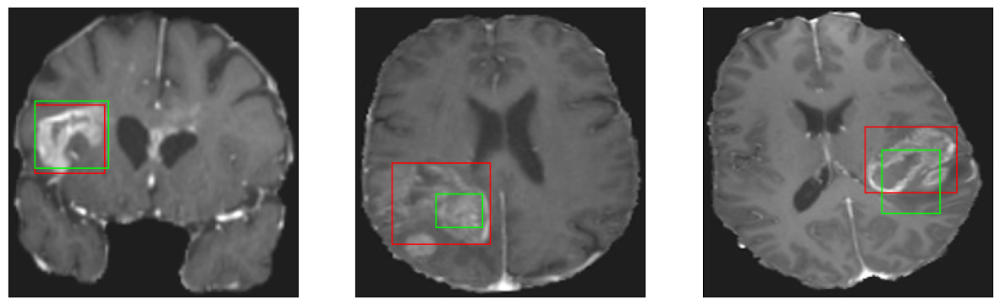

26/26 [==============================] - 3s 121ms/step - loss: 4.5238 - IoU: 0.6374 - val_loss: 10.6453 - val_IoU: 0.4563
Epoch 141/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5467 - IoU: 0.6371
Epoch 141: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


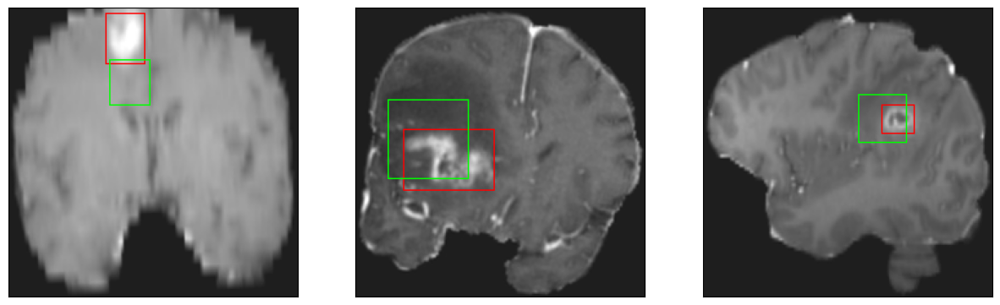

26/26 [==============================] - 3s 114ms/step - loss: 4.5493 - IoU: 0.6381 - val_loss: 10.4914 - val_IoU: 0.4669
Epoch 142/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2117 - IoU: 0.6591
Epoch 142: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


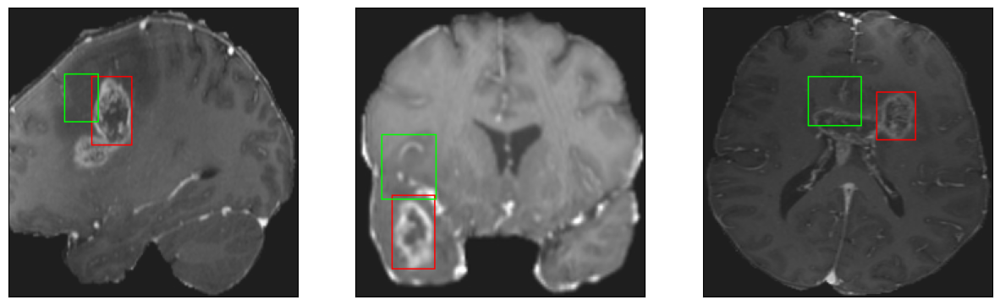

26/26 [==============================] - 3s 120ms/step - loss: 4.2084 - IoU: 0.6585 - val_loss: 15.4876 - val_IoU: 0.2541
Epoch 143/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4958 - IoU: 0.6471
Epoch 143: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


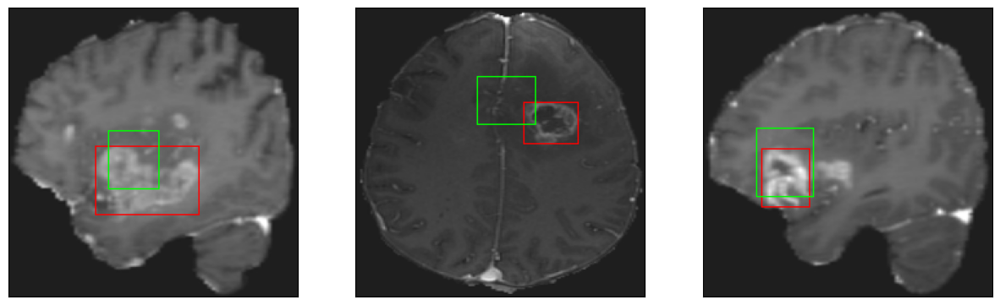

26/26 [==============================] - 3s 127ms/step - loss: 4.5061 - IoU: 0.6464 - val_loss: 10.3016 - val_IoU: 0.4747
Epoch 144/200
26/26 [==============================] - ETA: 0s - loss: 4.4703 - IoU: 0.6478
Epoch 144: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


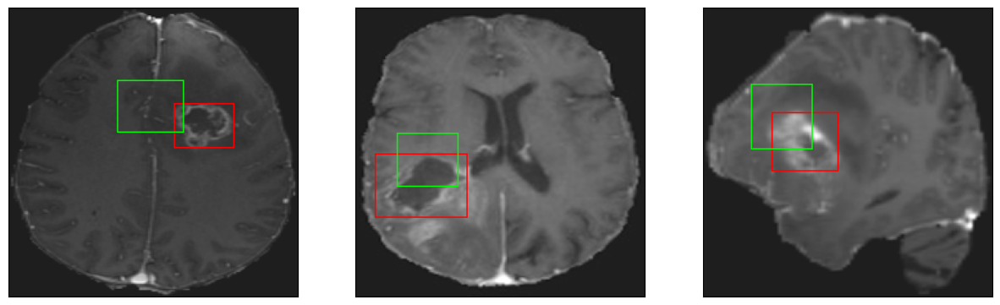

26/26 [==============================] - 3s 102ms/step - loss: 4.4703 - IoU: 0.6478 - val_loss: 17.0174 - val_IoU: 0.2409
Epoch 145/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4783 - IoU: 0.6433
Epoch 145: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


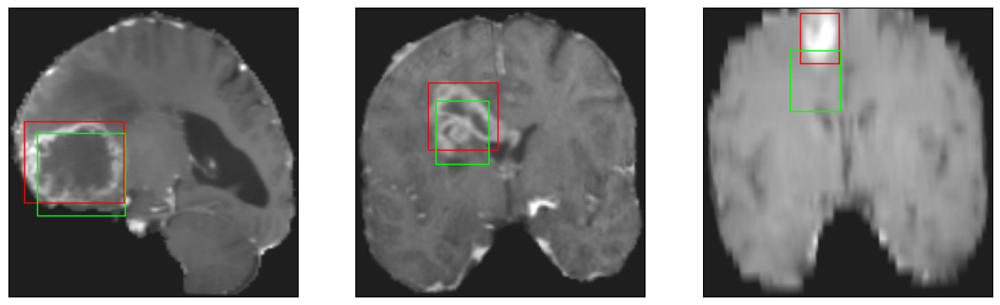

26/26 [==============================] - 2s 95ms/step - loss: 4.4464 - IoU: 0.6444 - val_loss: 12.4469 - val_IoU: 0.3764
Epoch 146/200
26/26 [==============================] - ETA: 0s - loss: 4.2149 - IoU: 0.6616
Epoch 146: val_IoU did not improve from 0.49212
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


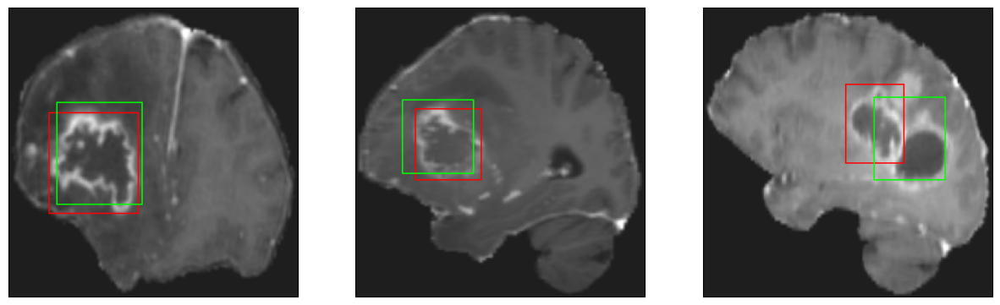

26/26 [==============================] - 3s 106ms/step - loss: 4.2149 - IoU: 0.6616 - val_loss: 10.3167 - val_IoU: 0.4603
Epoch 147/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4861 - IoU: 0.6483
Epoch 147: val_IoU improved from 0.49212 to 0.50229, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


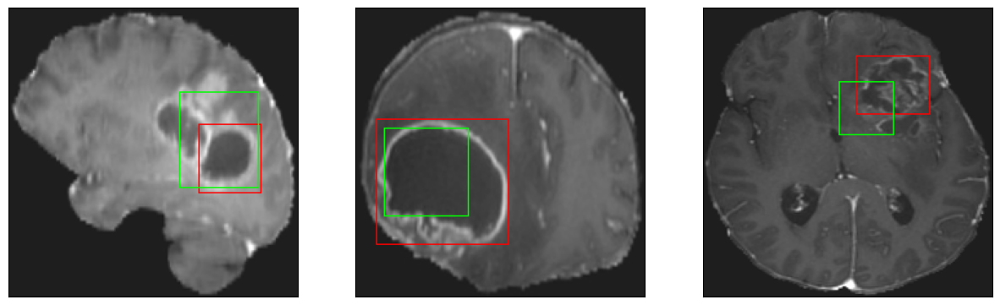

26/26 [==============================] - 4s 143ms/step - loss: 4.5270 - IoU: 0.6474 - val_loss: 9.9955 - val_IoU: 0.5023
Epoch 148/200
26/26 [==============================] - ETA: 0s - loss: 4.4874 - IoU: 0.6527
Epoch 148: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


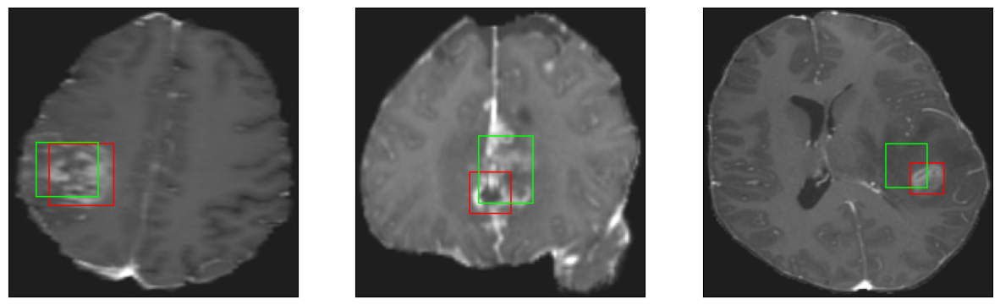

26/26 [==============================] - 3s 102ms/step - loss: 4.4874 - IoU: 0.6527 - val_loss: 10.5026 - val_IoU: 0.4489
Epoch 149/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5471 - IoU: 0.6437
Epoch 149: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


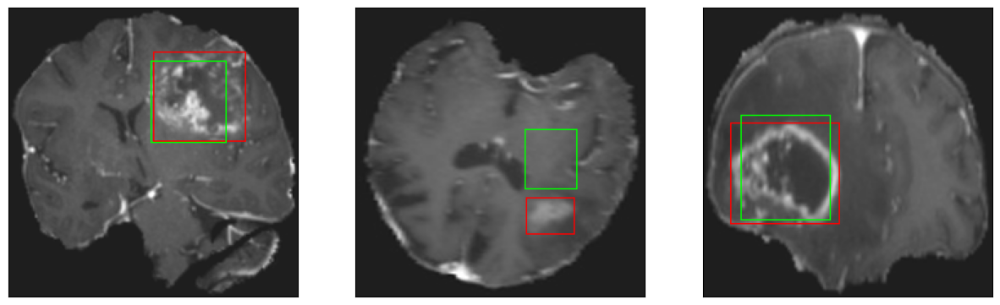

26/26 [==============================] - 3s 97ms/step - loss: 4.5280 - IoU: 0.6461 - val_loss: 10.2719 - val_IoU: 0.4906
Epoch 150/200
26/26 [==============================] - ETA: 0s - loss: 4.5106 - IoU: 0.6403
Epoch 150: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


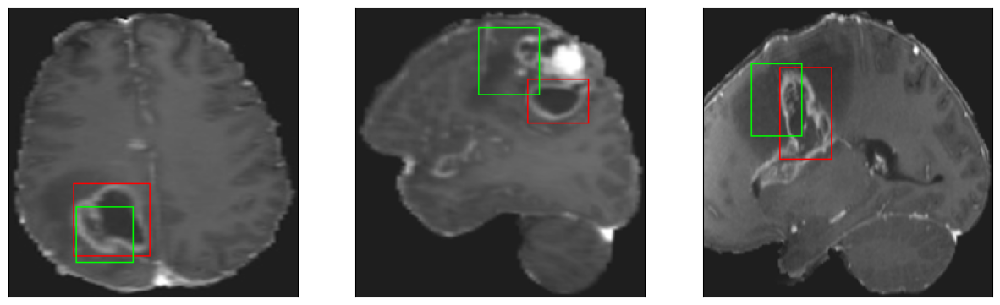

26/26 [==============================] - 3s 100ms/step - loss: 4.5106 - IoU: 0.6403 - val_loss: 10.1435 - val_IoU: 0.4682
Epoch 151/200
26/26 [==============================] - ETA: 0s - loss: 4.4427 - IoU: 0.6479
Epoch 151: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


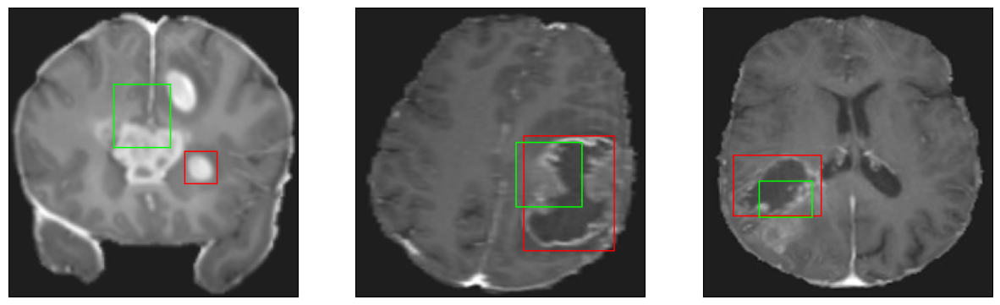

26/26 [==============================] - 2s 94ms/step - loss: 4.4427 - IoU: 0.6479 - val_loss: 11.1839 - val_IoU: 0.4252
Epoch 152/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5174 - IoU: 0.6389
Epoch 152: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


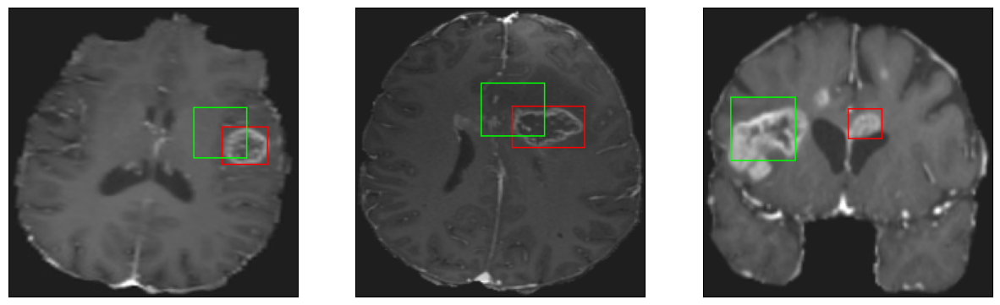

26/26 [==============================] - 3s 120ms/step - loss: 4.5417 - IoU: 0.6378 - val_loss: 13.7697 - val_IoU: 0.3133
Epoch 153/200
26/26 [==============================] - ETA: 0s - loss: 4.4224 - IoU: 0.6515
Epoch 153: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


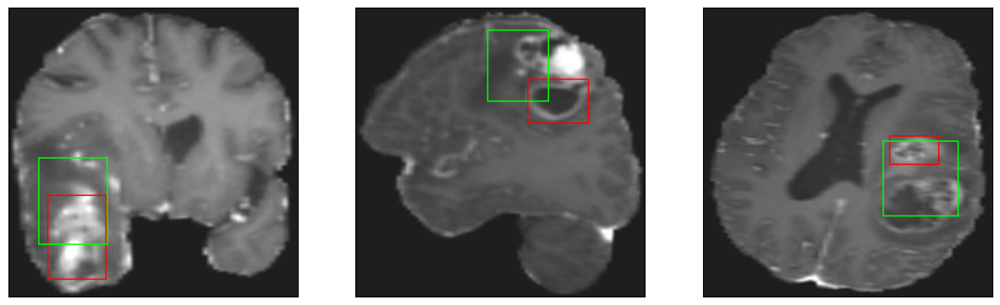

26/26 [==============================] - 3s 101ms/step - loss: 4.4224 - IoU: 0.6515 - val_loss: 10.2026 - val_IoU: 0.4702
Epoch 154/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6080 - IoU: 0.6345
Epoch 154: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


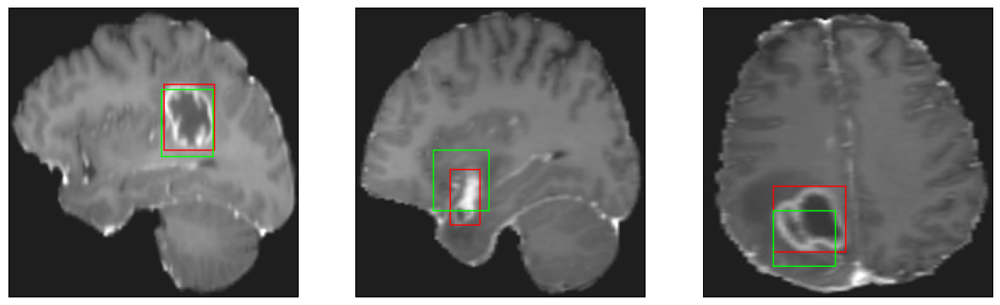

26/26 [==============================] - 3s 96ms/step - loss: 4.5687 - IoU: 0.6377 - val_loss: 9.8746 - val_IoU: 0.4753
Epoch 155/200
26/26 [==============================] - ETA: 0s - loss: 4.3400 - IoU: 0.6565
Epoch 155: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 11ms/step
4


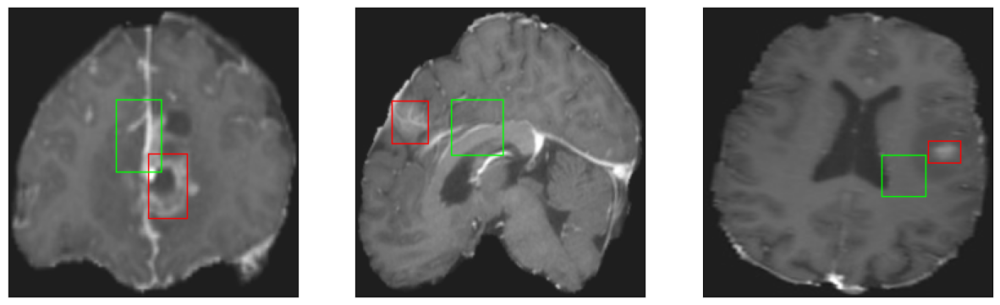

26/26 [==============================] - 3s 106ms/step - loss: 4.3400 - IoU: 0.6565 - val_loss: 9.9305 - val_IoU: 0.4811
Epoch 156/200
26/26 [==============================] - ETA: 0s - loss: 4.5863 - IoU: 0.6400
Epoch 156: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


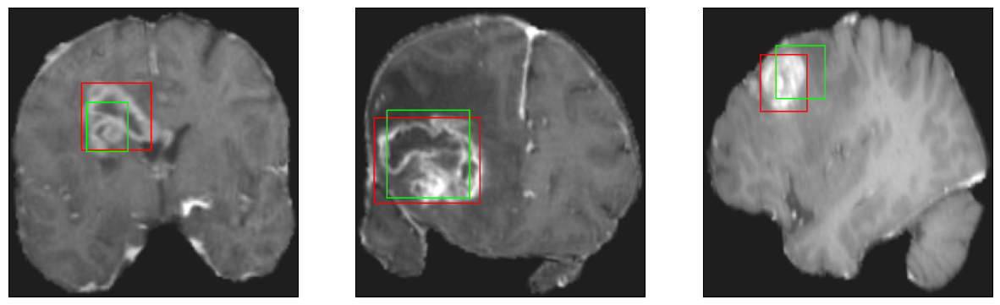

26/26 [==============================] - 3s 112ms/step - loss: 4.5863 - IoU: 0.6400 - val_loss: 10.8691 - val_IoU: 0.4373
Epoch 157/200
26/26 [==============================] - ETA: 0s - loss: 4.4016 - IoU: 0.6528
Epoch 157: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


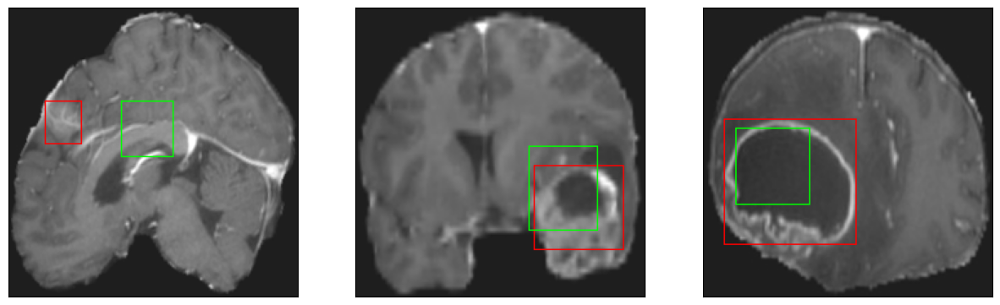

26/26 [==============================] - 3s 99ms/step - loss: 4.4016 - IoU: 0.6528 - val_loss: 10.3705 - val_IoU: 0.4609
Epoch 158/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3316 - IoU: 0.6486
Epoch 158: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


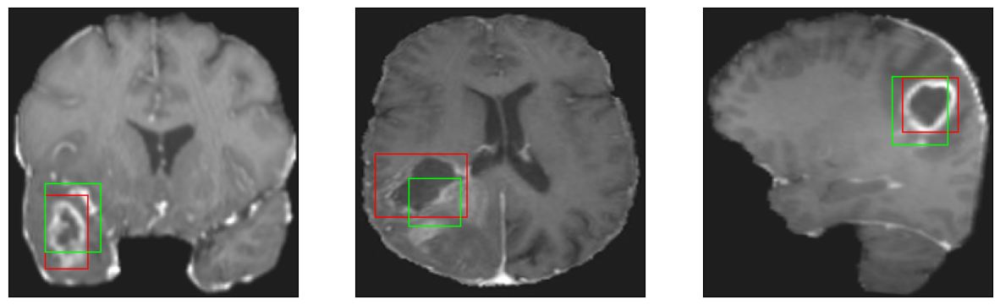

26/26 [==============================] - 3s 115ms/step - loss: 4.2936 - IoU: 0.6508 - val_loss: 10.4108 - val_IoU: 0.4529
Epoch 159/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3677 - IoU: 0.6487
Epoch 159: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


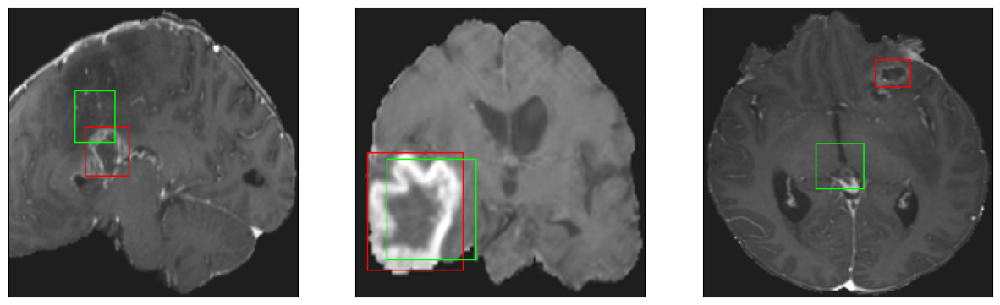

26/26 [==============================] - 3s 106ms/step - loss: 4.3758 - IoU: 0.6472 - val_loss: 10.5172 - val_IoU: 0.4570
Epoch 160/200
26/26 [==============================] - ETA: 0s - loss: 4.2317 - IoU: 0.6604
Epoch 160: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


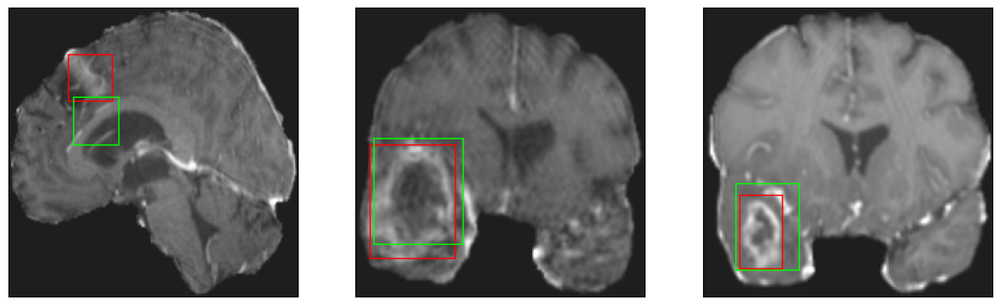

26/26 [==============================] - 2s 95ms/step - loss: 4.2317 - IoU: 0.6604 - val_loss: 10.2990 - val_IoU: 0.4622
Epoch 161/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2553 - IoU: 0.6628
Epoch 161: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


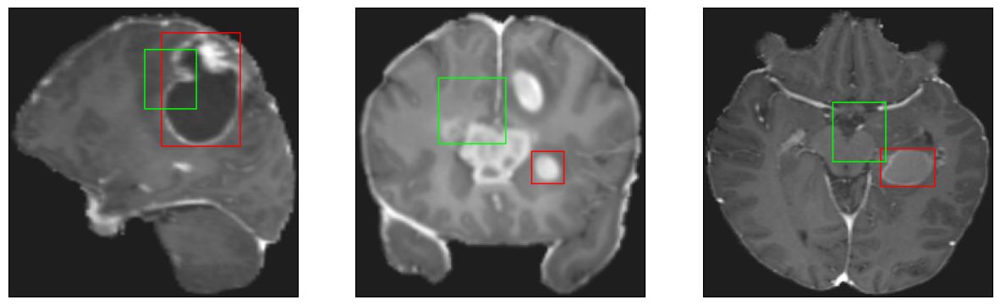

26/26 [==============================] - 3s 103ms/step - loss: 4.2553 - IoU: 0.6613 - val_loss: 13.4386 - val_IoU: 0.3167
Epoch 162/200
26/26 [==============================] - ETA: 0s - loss: 4.3401 - IoU: 0.6537
Epoch 162: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


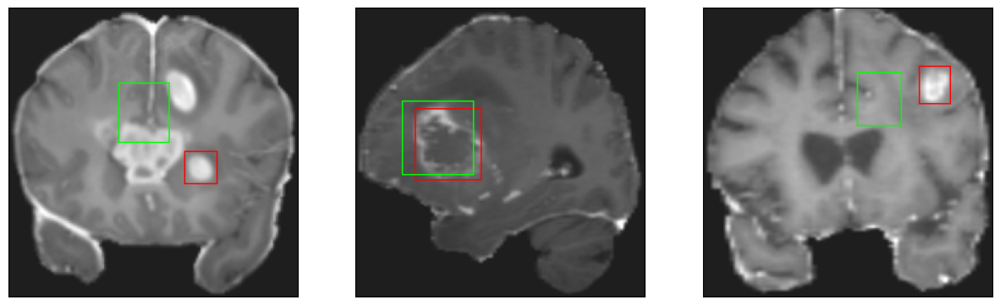

26/26 [==============================] - 3s 122ms/step - loss: 4.3401 - IoU: 0.6537 - val_loss: 10.1524 - val_IoU: 0.4678
Epoch 163/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1430 - IoU: 0.6590
Epoch 163: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


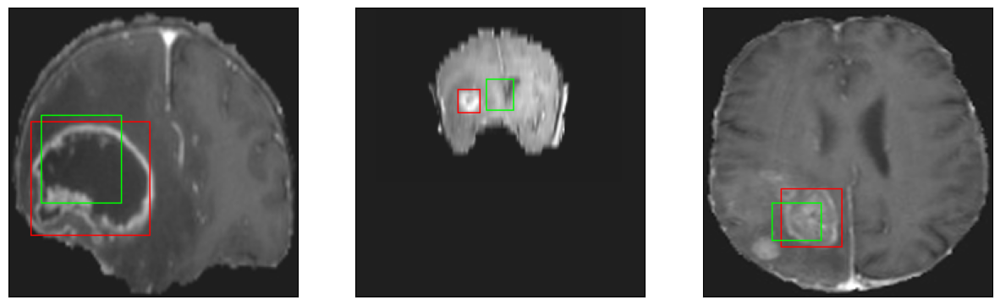

26/26 [==============================] - 3s 100ms/step - loss: 4.1339 - IoU: 0.6615 - val_loss: 11.2701 - val_IoU: 0.4173
Epoch 164/200
26/26 [==============================] - ETA: 0s - loss: 4.2788 - IoU: 0.6594
Epoch 164: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


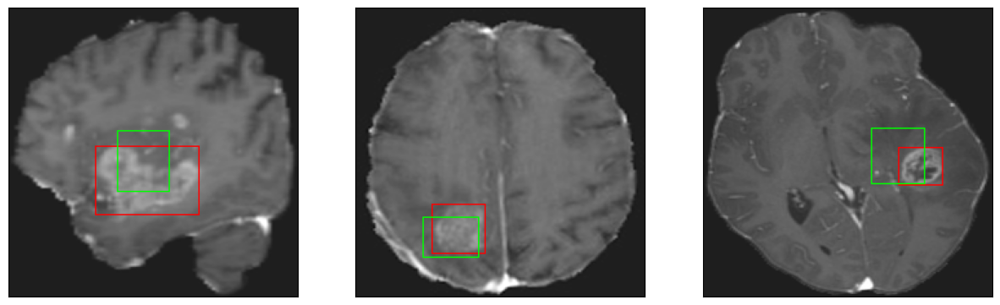

26/26 [==============================] - 3s 103ms/step - loss: 4.2788 - IoU: 0.6594 - val_loss: 10.1886 - val_IoU: 0.4721
Epoch 165/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3394 - IoU: 0.6494
Epoch 165: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


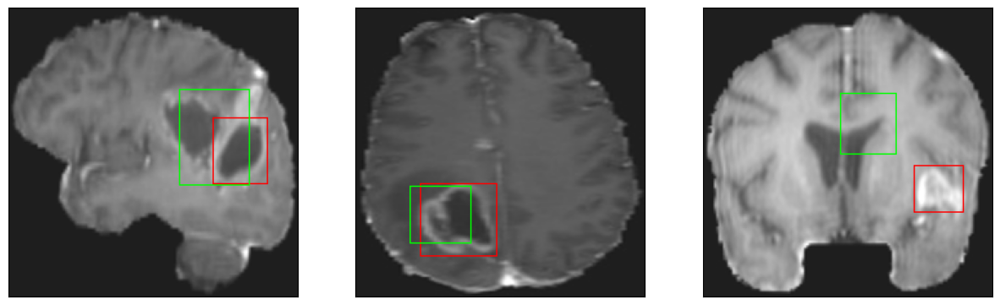

26/26 [==============================] - 3s 106ms/step - loss: 4.3314 - IoU: 0.6492 - val_loss: 11.9408 - val_IoU: 0.3955
Epoch 166/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2633 - IoU: 0.6598
Epoch 166: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


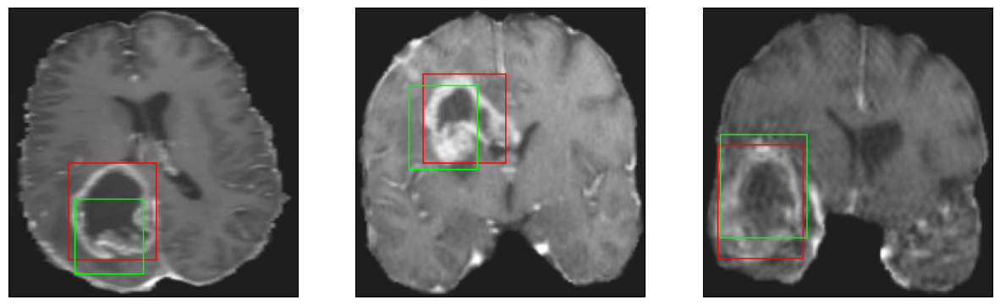

26/26 [==============================] - 3s 98ms/step - loss: 4.2817 - IoU: 0.6592 - val_loss: 10.7029 - val_IoU: 0.4466
Epoch 167/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4420 - IoU: 0.6411
Epoch 167: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


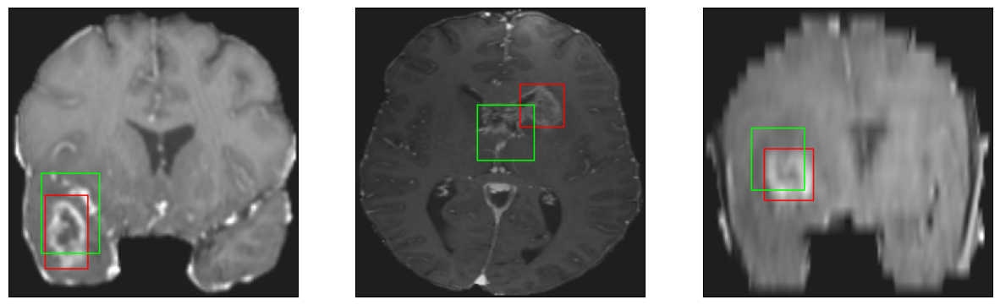

26/26 [==============================] - 3s 104ms/step - loss: 4.4185 - IoU: 0.6436 - val_loss: 11.0937 - val_IoU: 0.4188
Epoch 168/200
26/26 [==============================] - ETA: 0s - loss: 4.1603 - IoU: 0.6625
Epoch 168: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


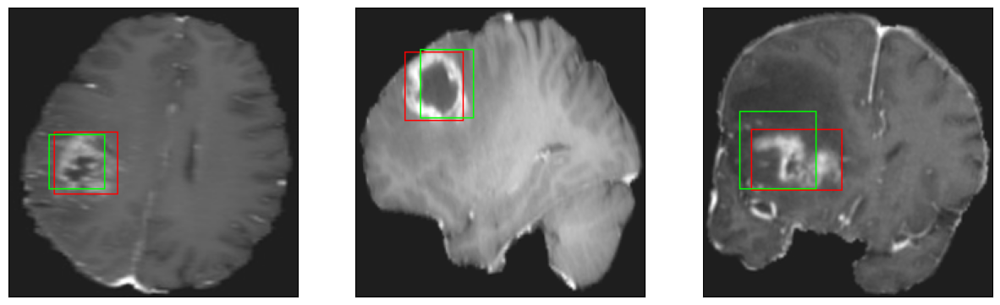

26/26 [==============================] - 3s 125ms/step - loss: 4.1603 - IoU: 0.6625 - val_loss: 10.2430 - val_IoU: 0.4855
Epoch 169/200
26/26 [==============================] - ETA: 0s - loss: 4.4520 - IoU: 0.6489
Epoch 169: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 9ms/step
4


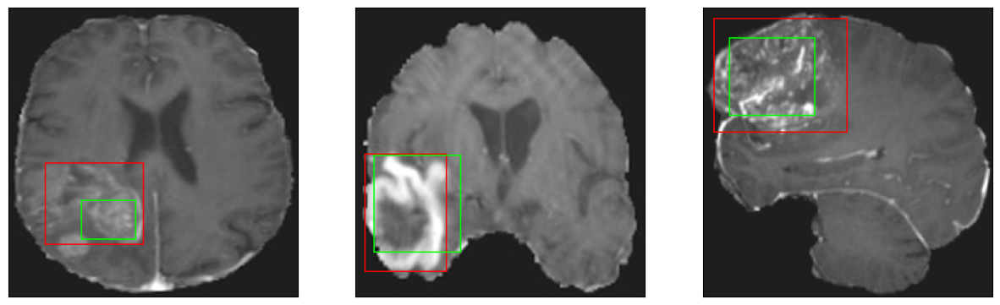

26/26 [==============================] - 4s 146ms/step - loss: 4.4520 - IoU: 0.6489 - val_loss: 10.4415 - val_IoU: 0.4623
Epoch 170/200
26/26 [==============================] - ETA: 0s - loss: 4.1125 - IoU: 0.6666
Epoch 170: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


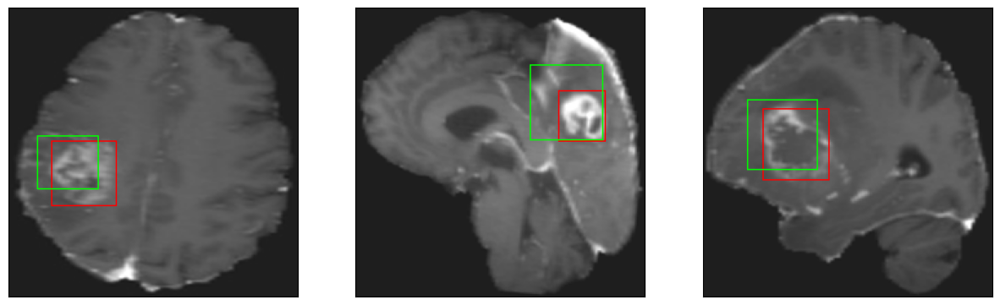

26/26 [==============================] - 3s 101ms/step - loss: 4.1125 - IoU: 0.6666 - val_loss: 9.9355 - val_IoU: 0.4875
Epoch 171/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9755 - IoU: 0.6776
Epoch 171: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


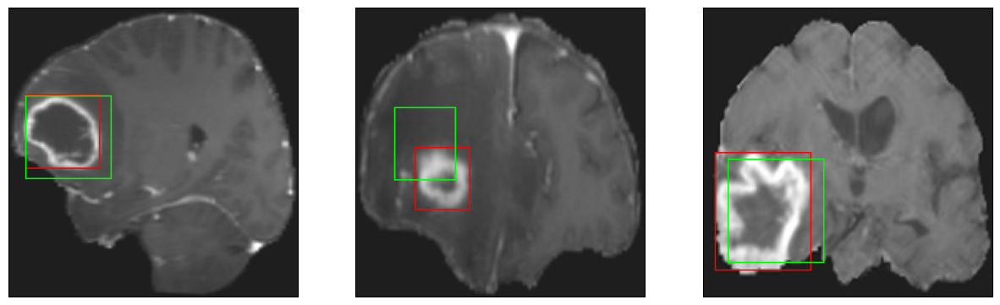

26/26 [==============================] - 3s 106ms/step - loss: 3.9814 - IoU: 0.6768 - val_loss: 10.1703 - val_IoU: 0.4651
Epoch 172/200
26/26 [==============================] - ETA: 0s - loss: 4.1295 - IoU: 0.6679
Epoch 172: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


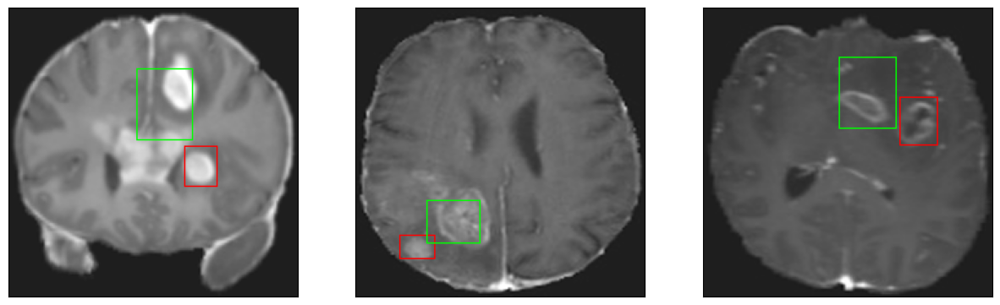

26/26 [==============================] - 3s 98ms/step - loss: 4.1295 - IoU: 0.6679 - val_loss: 10.3694 - val_IoU: 0.4710
Epoch 173/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2770 - IoU: 0.6594
Epoch 173: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


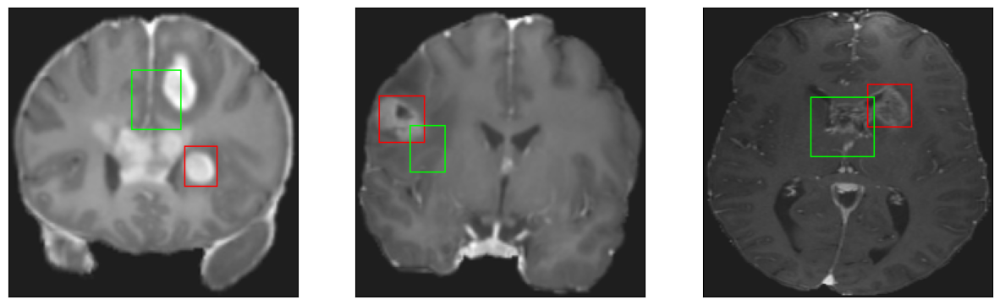

26/26 [==============================] - 3s 116ms/step - loss: 4.3066 - IoU: 0.6585 - val_loss: 11.8561 - val_IoU: 0.3891
Epoch 174/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1921 - IoU: 0.6619
Epoch 174: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


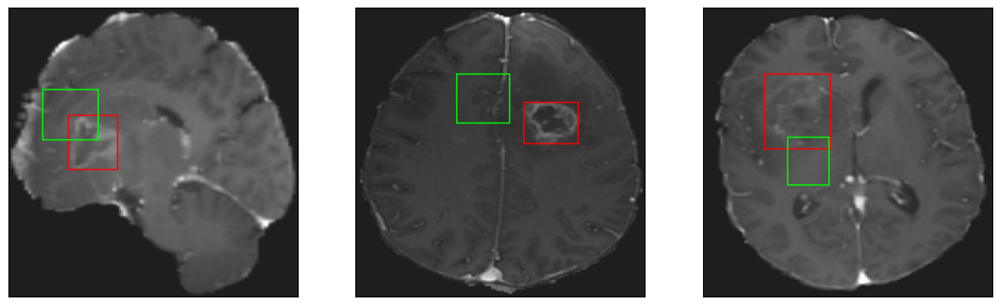

26/26 [==============================] - 3s 121ms/step - loss: 4.2146 - IoU: 0.6605 - val_loss: 16.0878 - val_IoU: 0.2461
Epoch 175/200
26/26 [==============================] - ETA: 0s - loss: 4.1617 - IoU: 0.6655
Epoch 175: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


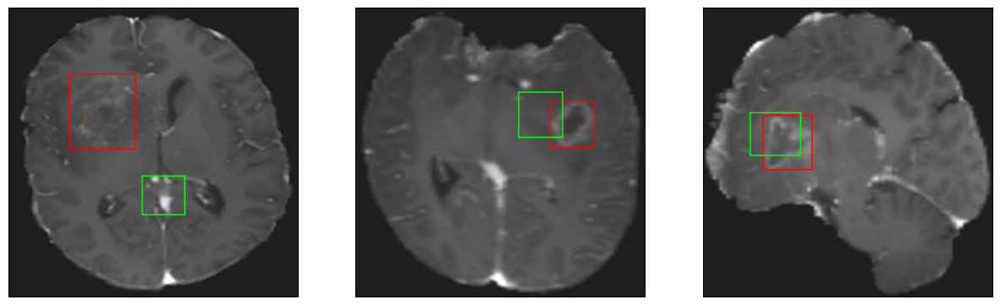

26/26 [==============================] - 3s 102ms/step - loss: 4.1617 - IoU: 0.6655 - val_loss: 10.3932 - val_IoU: 0.4601
Epoch 176/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3872 - IoU: 0.6546
Epoch 176: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


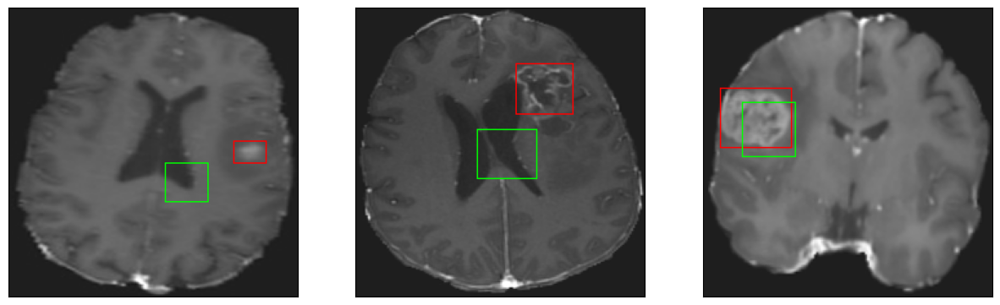

26/26 [==============================] - 3s 99ms/step - loss: 4.3678 - IoU: 0.6562 - val_loss: 11.0626 - val_IoU: 0.4408
Epoch 177/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1890 - IoU: 0.6647
Epoch 177: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


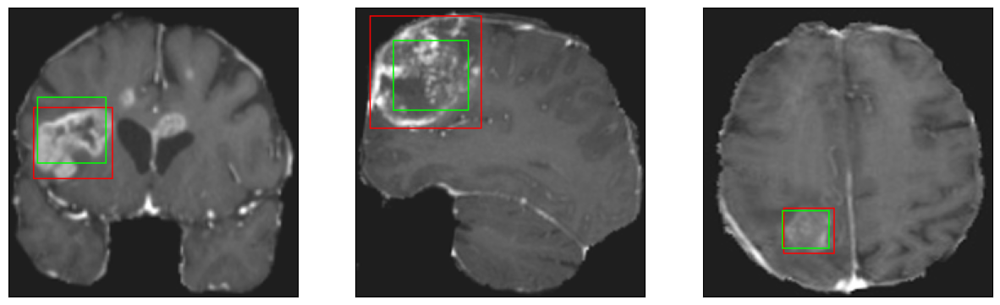

26/26 [==============================] - 3s 131ms/step - loss: 4.1856 - IoU: 0.6657 - val_loss: 11.3028 - val_IoU: 0.4162
Epoch 178/200
26/26 [==============================] - ETA: 0s - loss: 4.3000 - IoU: 0.6591
Epoch 178: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


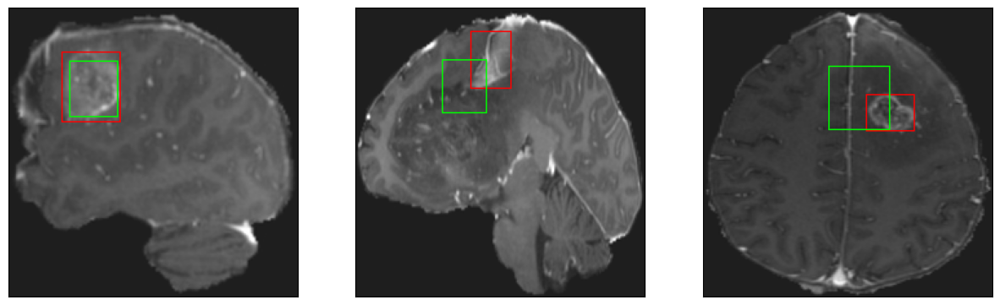

26/26 [==============================] - 3s 110ms/step - loss: 4.3000 - IoU: 0.6591 - val_loss: 10.1033 - val_IoU: 0.4769
Epoch 179/200
26/26 [==============================] - ETA: 0s - loss: 4.4271 - IoU: 0.6537
Epoch 179: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


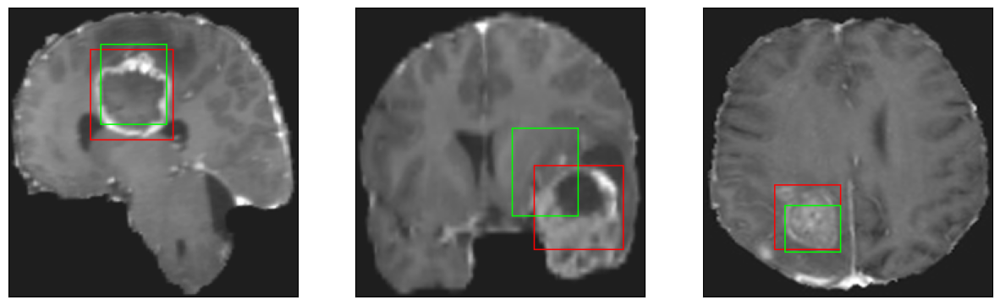

26/26 [==============================] - 2s 96ms/step - loss: 4.4271 - IoU: 0.6537 - val_loss: 10.3068 - val_IoU: 0.4650
Epoch 180/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2816 - IoU: 0.6453
Epoch 180: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


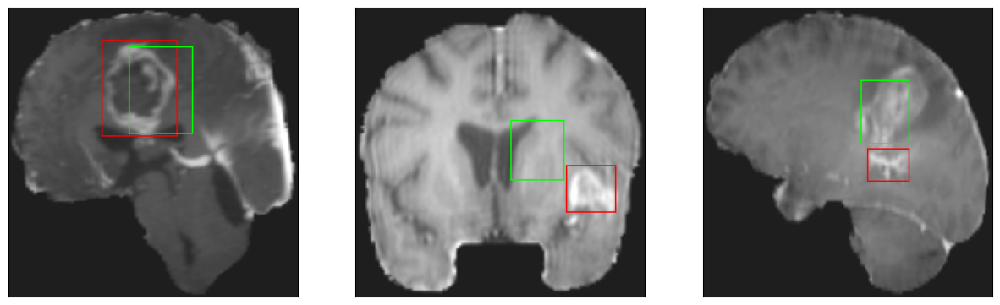

26/26 [==============================] - 3s 107ms/step - loss: 4.3246 - IoU: 0.6454 - val_loss: 10.1760 - val_IoU: 0.4752
Epoch 181/200
26/26 [==============================] - ETA: 0s - loss: 4.3597 - IoU: 0.6485
Epoch 181: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


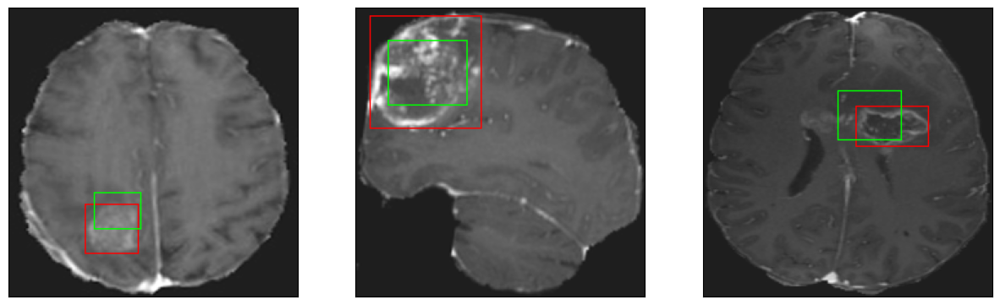

26/26 [==============================] - 3s 101ms/step - loss: 4.3597 - IoU: 0.6485 - val_loss: 11.5765 - val_IoU: 0.3859
Epoch 182/200
26/26 [==============================] - ETA: 0s - loss: 4.3586 - IoU: 0.6512
Epoch 182: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


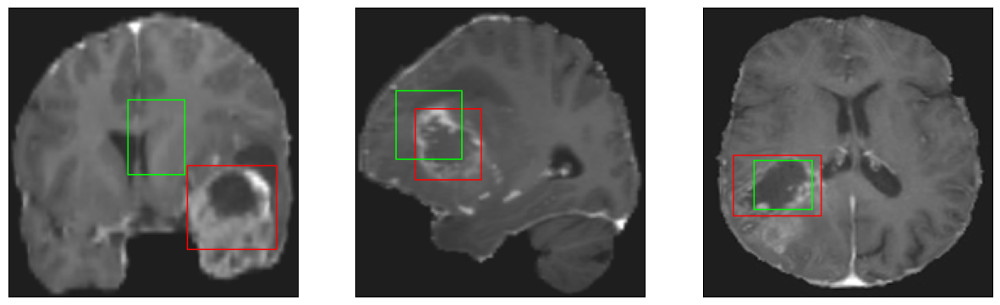

26/26 [==============================] - 3s 106ms/step - loss: 4.3586 - IoU: 0.6512 - val_loss: 14.9607 - val_IoU: 0.2769
Epoch 183/200
26/26 [==============================] - ETA: 0s - loss: 4.2387 - IoU: 0.6596
Epoch 183: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


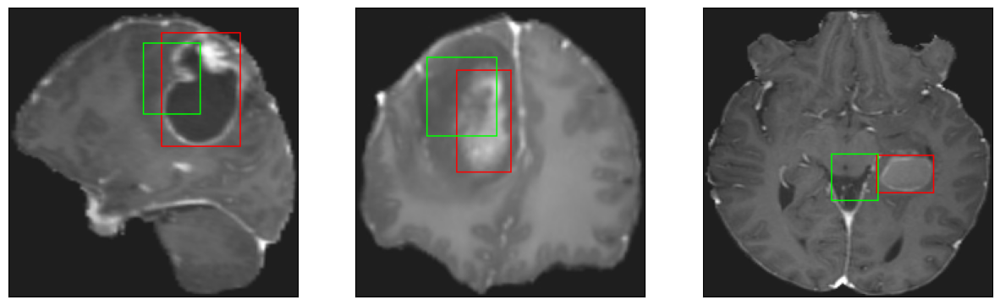

26/26 [==============================] - 3s 99ms/step - loss: 4.2387 - IoU: 0.6596 - val_loss: 10.4303 - val_IoU: 0.4910
Epoch 184/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2171 - IoU: 0.6603
Epoch 184: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


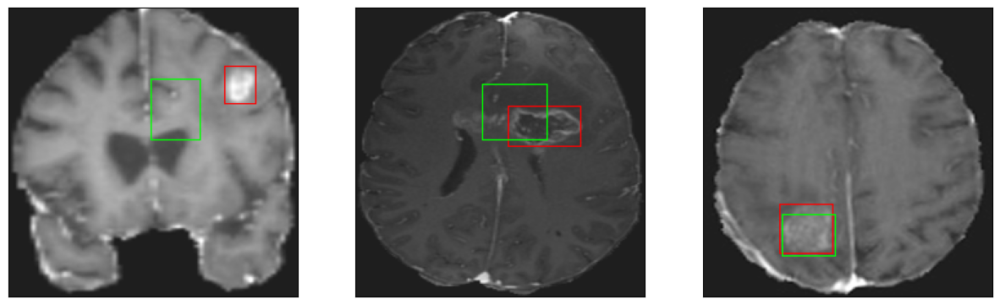

26/26 [==============================] - 3s 105ms/step - loss: 4.2250 - IoU: 0.6603 - val_loss: 10.3924 - val_IoU: 0.4789
Epoch 185/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0401 - IoU: 0.6708
Epoch 185: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


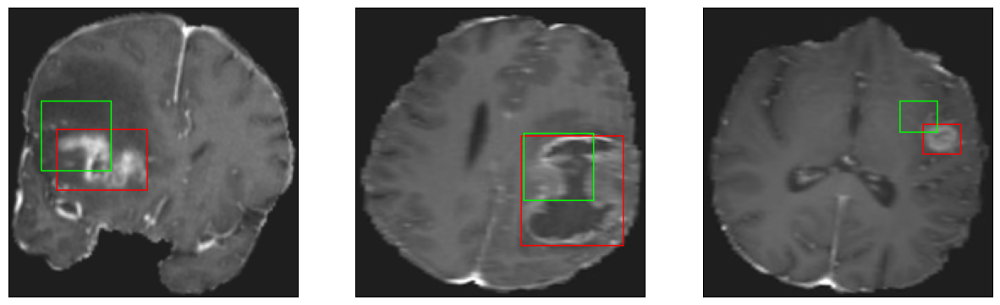

26/26 [==============================] - 3s 123ms/step - loss: 4.0390 - IoU: 0.6713 - val_loss: 11.7336 - val_IoU: 0.3939
Epoch 186/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0490 - IoU: 0.6681
Epoch 186: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


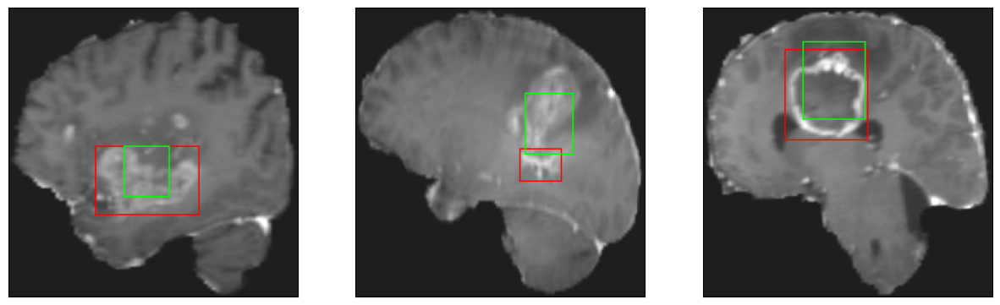

26/26 [==============================] - 2s 89ms/step - loss: 4.0457 - IoU: 0.6676 - val_loss: 10.4723 - val_IoU: 0.4556
Epoch 187/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0950 - IoU: 0.6694
Epoch 187: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


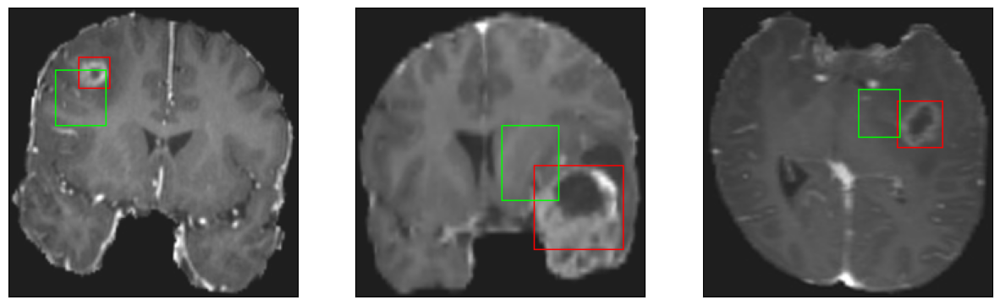

26/26 [==============================] - 2s 92ms/step - loss: 4.0370 - IoU: 0.6736 - val_loss: 11.8823 - val_IoU: 0.3847
Epoch 188/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0124 - IoU: 0.6753
Epoch 188: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


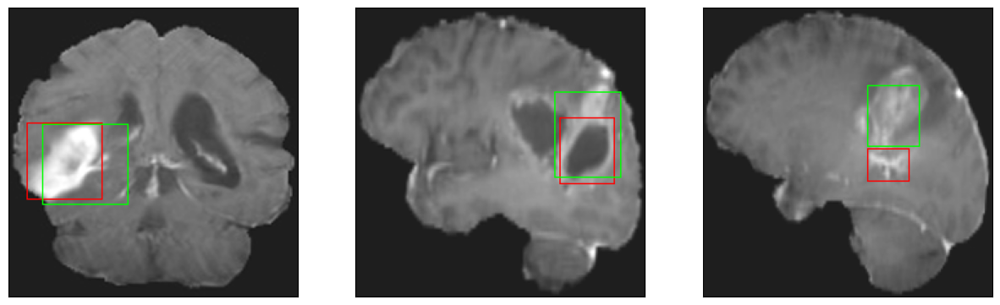

26/26 [==============================] - 3s 101ms/step - loss: 3.9843 - IoU: 0.6764 - val_loss: 9.9623 - val_IoU: 0.4812
Epoch 189/200
26/26 [==============================] - ETA: 0s - loss: 4.1648 - IoU: 0.6657
Epoch 189: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


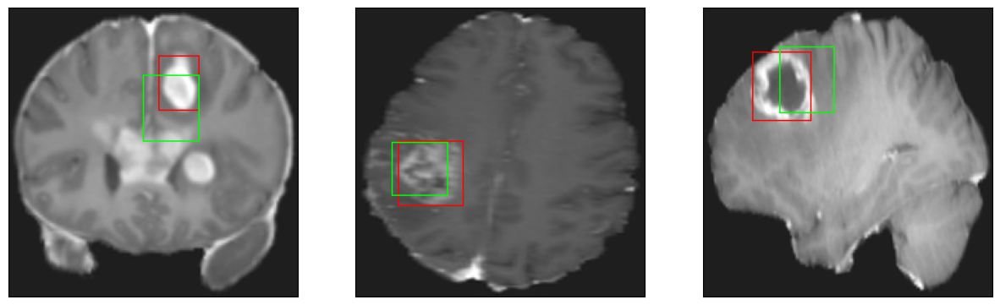

26/26 [==============================] - 3s 103ms/step - loss: 4.1648 - IoU: 0.6657 - val_loss: 10.6962 - val_IoU: 0.4529
Epoch 190/200
26/26 [==============================] - ETA: 0s - loss: 4.2857 - IoU: 0.6585
Epoch 190: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


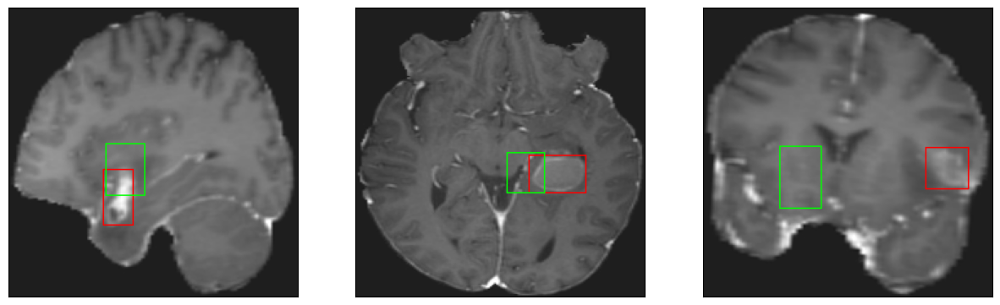

26/26 [==============================] - 3s 124ms/step - loss: 4.2857 - IoU: 0.6585 - val_loss: 10.9916 - val_IoU: 0.4238
Epoch 191/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1289 - IoU: 0.6629
Epoch 191: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


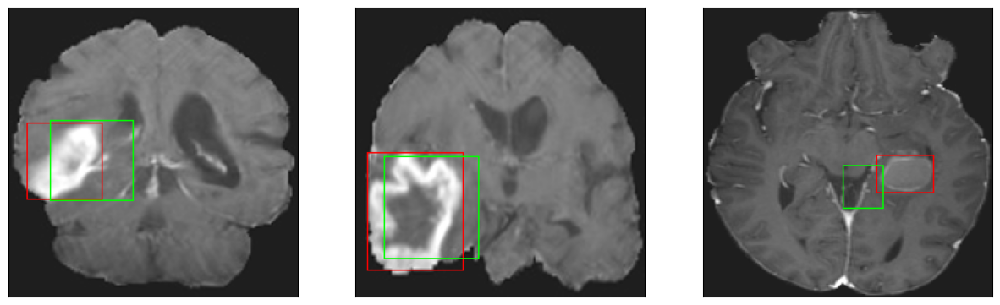

26/26 [==============================] - 3s 124ms/step - loss: 4.1256 - IoU: 0.6637 - val_loss: 9.6192 - val_IoU: 0.5015
Epoch 192/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1335 - IoU: 0.6697
Epoch 192: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4


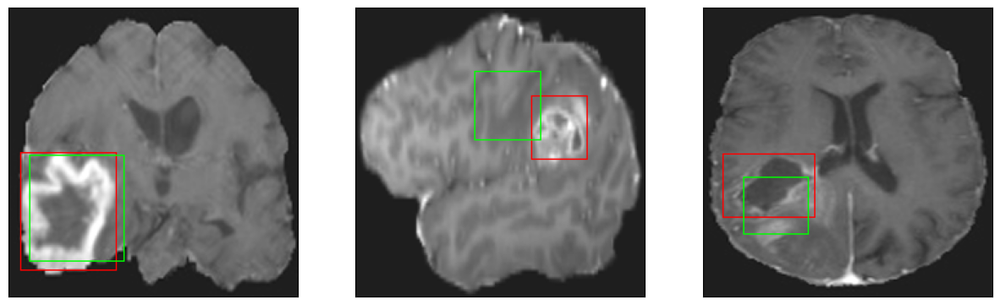

26/26 [==============================] - 3s 105ms/step - loss: 4.1475 - IoU: 0.6674 - val_loss: 10.1690 - val_IoU: 0.4725
Epoch 193/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1726 - IoU: 0.6640
Epoch 193: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


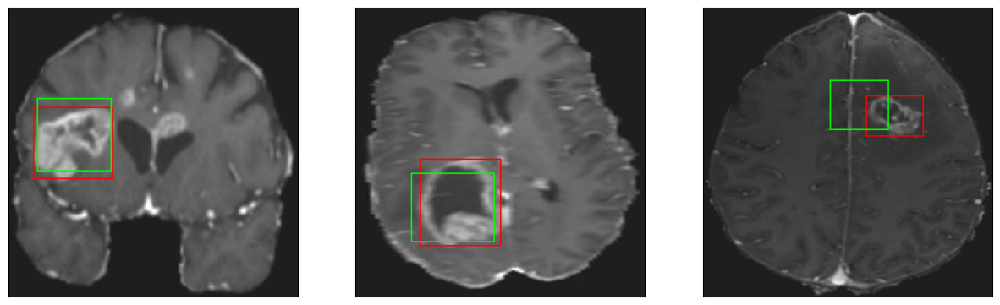

26/26 [==============================] - 2s 95ms/step - loss: 4.1723 - IoU: 0.6646 - val_loss: 10.0269 - val_IoU: 0.4797
Epoch 194/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0575 - IoU: 0.6742
Epoch 194: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


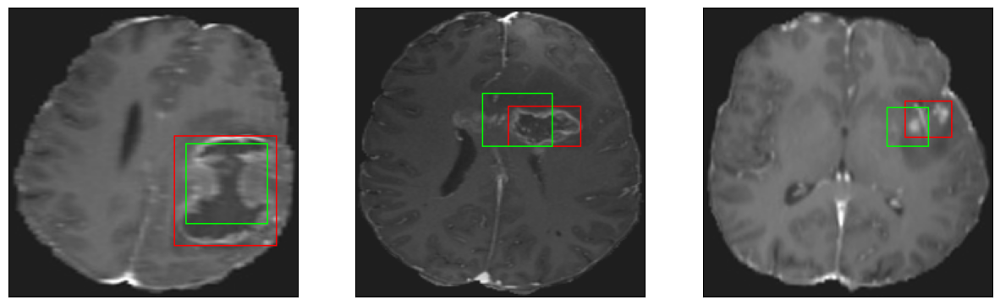

26/26 [==============================] - 2s 94ms/step - loss: 4.1233 - IoU: 0.6719 - val_loss: 11.5493 - val_IoU: 0.4296
Epoch 195/200
26/26 [==============================] - ETA: 0s - loss: 4.1219 - IoU: 0.6713
Epoch 195: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


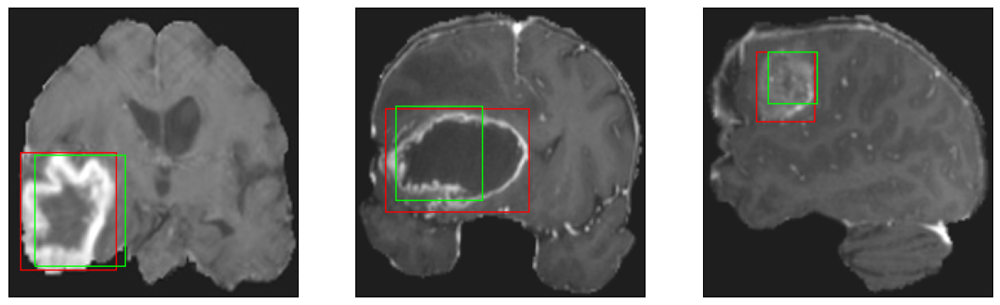

26/26 [==============================] - 3s 97ms/step - loss: 4.1219 - IoU: 0.6713 - val_loss: 10.0130 - val_IoU: 0.4910
Epoch 196/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9726 - IoU: 0.6791
Epoch 196: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


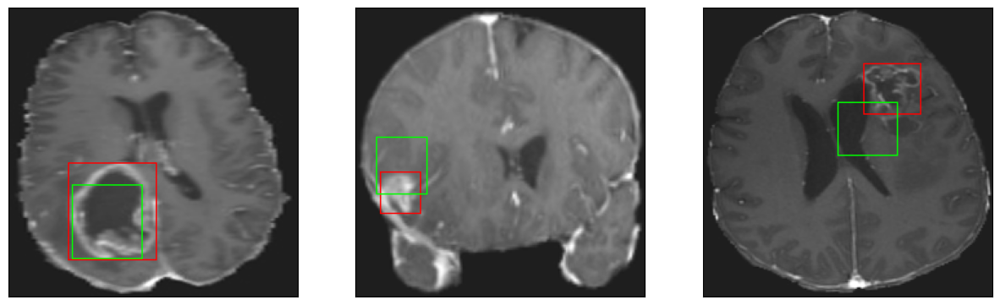

26/26 [==============================] - 3s 104ms/step - loss: 3.9712 - IoU: 0.6798 - val_loss: 10.8399 - val_IoU: 0.4305
Epoch 197/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1662 - IoU: 0.6587
Epoch 197: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


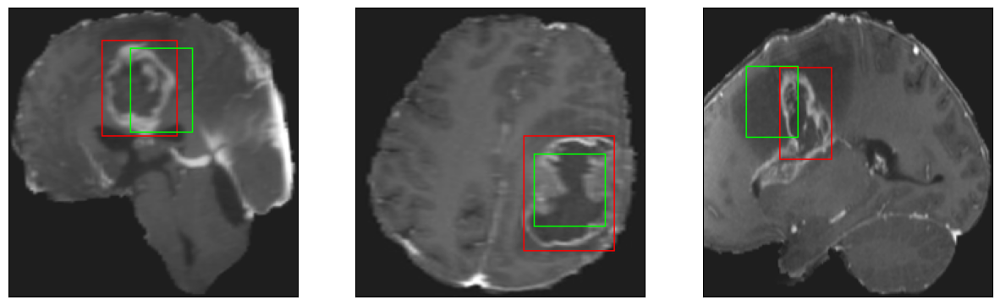

26/26 [==============================] - 3s 99ms/step - loss: 4.1354 - IoU: 0.6602 - val_loss: 9.9194 - val_IoU: 0.4798
Epoch 198/200
26/26 [==============================] - ETA: 0s - loss: 4.0718 - IoU: 0.6704
Epoch 198: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


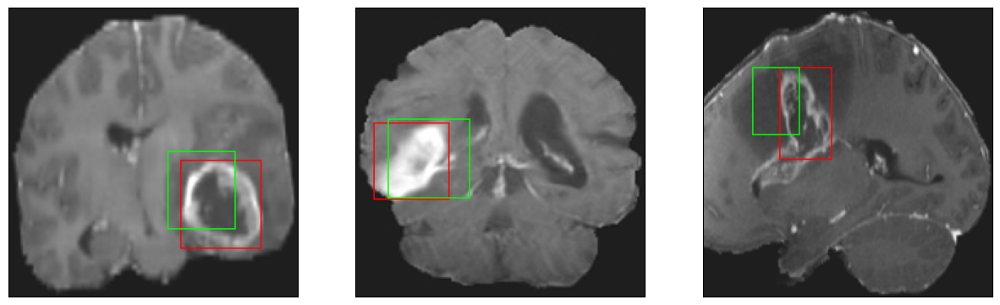

26/26 [==============================] - 3s 100ms/step - loss: 4.0718 - IoU: 0.6704 - val_loss: 10.8755 - val_IoU: 0.4306
Epoch 199/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9516 - IoU: 0.6789
Epoch 199: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


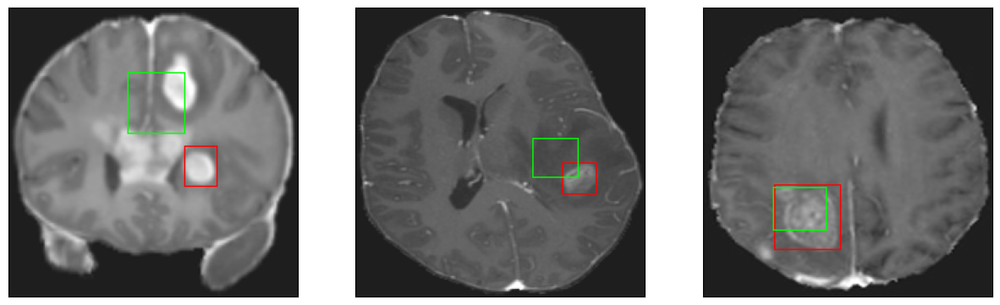

26/26 [==============================] - 3s 101ms/step - loss: 3.9219 - IoU: 0.6810 - val_loss: 11.1391 - val_IoU: 0.4146
Epoch 200/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8009 - IoU: 0.6828
Epoch 200: val_IoU did not improve from 0.50229
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


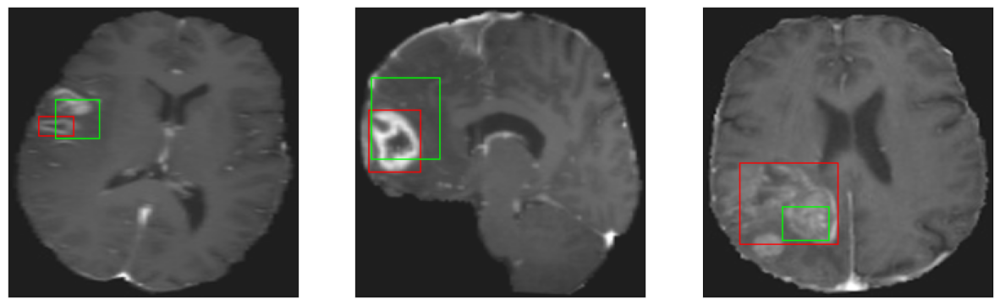

26/26 [==============================] - 3s 127ms/step - loss: 3.8320 - IoU: 0.6800 - val_loss: 10.7064 - val_IoU: 0.4402


In [25]:
hist = model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

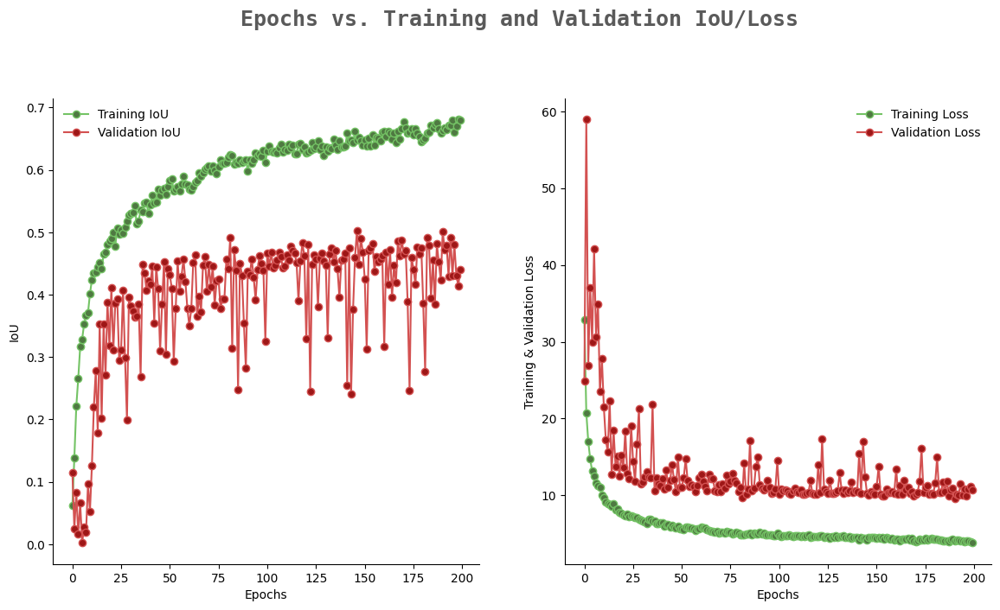

In [26]:
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(200)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation IoU/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [27]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [28]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [29]:
model.evaluate(test_dataset)

8/8 [==============================] - 1s 34ms/step - loss: 13.0236 - IoU: 0.3586


[13.023554801940918, 0.35861724615097046]